# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'


# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

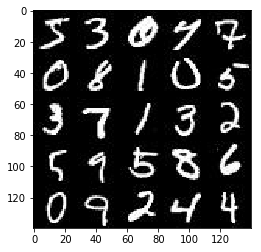

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

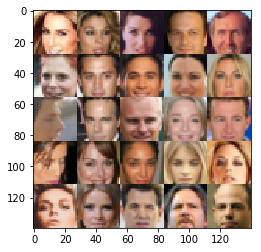

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.1
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    inputs_fake  = tf.placeholder(tf.float32, [None , z_dim],name='input_z')
    inputs_real  = tf.placeholder(tf.float32, [None , image_width, image_height, image_channels ],name='input_real')
    learning_rate = tf.placeholder(tf.float32, name= 'lr')
    return (inputs_real, inputs_fake, learning_rate)


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [7]:
import numpy as np
def discriminator(images, reuse = False, alpha = 0.2):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    #weight_std_dev = 0.1
    #init_type = tf.truncated_normal_initializer (stddev= weight_std_dev)
    with tf.variable_scope('discriminator', reuse = reuse):
        conv_net1 = tf.layers.conv2d(inputs = images, filters = 128, kernel_size = 3, strides = 1, 
                                     padding ='same'
                                     )
        conv_net1_lrelu = tf.maximum(alpha * conv_net1, conv_net1)  
        
        #Use Maxpool Layers to better categorize pics with 3 channels
        conv_net1_maxpool =  tf.layers.max_pooling2d(inputs = conv_net1_lrelu, pool_size = 2, strides = 2, 
                                                     padding = 'same')
                
        conv_net2 = tf.layers.conv2d(inputs = conv_net1_maxpool, filters = 256, kernel_size = 3, strides = 1, 
                                     padding ='same'
                                     )
        conv_net2_bn = tf.layers.batch_normalization(conv_net2, training = True)
        conv_net2_lrelu = tf.maximum(alpha * conv_net2_bn, conv_net2_bn)  
        conv_net2_maxpool =  tf.layers.max_pooling2d(inputs = conv_net2_lrelu, pool_size = 2, strides = 2, 
                                                     padding = 'same')
                
        
        conv_net3 = tf.layers.conv2d(inputs = conv_net2_maxpool, filters = 512, kernel_size = 3, strides = 1, 
                                     padding ='same'
                                     )
        conv_net3_bn = tf.layers.batch_normalization(conv_net3, training = True)
        conv_net3_lrelu =  tf.maximum(alpha * conv_net3_bn, conv_net3_bn)
        conv_net3_maxpool =  tf.layers.max_pooling2d(inputs = conv_net3_lrelu, pool_size = 2, strides = 2, 
                                                     padding = 'same')
        
                
        tensor_shape = conv_net3_maxpool.get_shape().as_list()
        #Flatten the tensor
        reshape_to = np.prod(tensor_shape[1:])
        dis_fully_con = tf.reshape(conv_net3_maxpool, [-1,reshape_to])
        logits = tf.layers.dense(dis_fully_con, 1)
        discriminator_output = tf.sigmoid(logits) 
             
                  

    return (discriminator_output , logits)


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [8]:
def generator(z, out_channel_dim , is_train = True , alpha= 0.2):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    #weight_std_dev = 0.1
    #init_type = tf.truncated_normal_initializer (stddev= weight_std_dev)
    with tf.variable_scope('generator', reuse = not is_train):
        fake_input1 = tf.layers.dense(z, 7*7*512)
        #reshape the input to fit into a convolutional stack
        conv_net1 = tf.reshape(fake_input1, [-1, 7, 7, 512])
        conv_net1_bn = tf.layers.batch_normalization(conv_net1, training = is_train)
        conv_net1_relu = tf.maximum(alpha * conv_net1_bn, conv_net1_bn)
        #conv_net1_upample = tf.image.resize_nearest_neighbor(conv_net1_relu, (7,7))
                    
        conv_net2 = tf.layers.conv2d_transpose(inputs = conv_net1_relu, filters = 256, 
                                               kernel_size = 3, strides = 2, 
                                               padding='same')
                                              
        conv_net2_bn = tf.layers.batch_normalization(conv_net2, training = is_train)
        conv_net2_relu = tf.maximum(alpha * conv_net2_bn, conv_net2_bn)
        
        #conv_net2_upample = tf.image.resize_nearest_neighbor(conv_net2_relu, (14,14))           
        
        conv_net3 = tf.layers.conv2d_transpose(inputs = conv_net2_relu, filters = 128, 
                                               kernel_size =3, strides = 2, 
                                               padding='same')
                                              
        conv_net3_bn = tf.layers.batch_normalization(conv_net3, training = is_train)
        conv_net3_relu = tf.maximum(alpha * conv_net3_bn, conv_net3_bn)
        
        #conv_net3_upample = tf.image.resize_nearest_neighbor(conv_net3_relu, (28,28)) 
                        
        logits = tf.layers.conv2d_transpose(inputs = conv_net3_relu, filters = out_channel_dim, 
                                            kernel_size = 3, strides = 1, 
                                            padding='same'
                                            )
        
        generator_output = tf.tanh(logits) 
                       
    return generator_output


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [9]:
def model_loss(input_real, input_z, out_channel_dim, alpha = 0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, out_channel_dim, alpha = alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha = alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse = True, alpha = alpha)
    
    #Apply label smoothing to help the discriminator generalize better.  
    # This is typically used with classifiers to improve performance.
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = d_logits_real,
                                                                         labels = tf.ones_like(d_model_real) * 0.9
                                                                        ))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = d_logits_fake,
                                                                        labels = tf.zeros_like(d_model_fake)
                                                                        ))
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits (logits = d_logits_fake,
                                                                     labels = tf.ones_like(d_model_fake)                                                                    
                                                                    ))
    
    d_loss = d_loss_real + d_loss_fake
    
    return (d_loss, g_loss)


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [10]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    trainable_vars = tf.trainable_variables()
    discriminator_vars = [var for var in trainable_vars if var.name.startswith('discriminator')]
    generator_vars = [var for var in trainable_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=discriminator_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=generator_vars)
    
    return (d_train_opt, g_train_opt)


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [11]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode, alpha):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False, alpha),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [12]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode, alpha):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model  
    #tf.reset_default_graph()
    # Create our input placeholders
    holder, img_width, img_height, img_depth = data_shape
    input_real, input_z , lr = model_inputs(img_width , img_height , img_depth, z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, img_depth, alpha)
        
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    iteration = 0
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                iteration += 1
                #Scale image values to dense between -1 and 1
                batch_images = batch_images * 2
                
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: batch_images, lr: learning_rate})
                
                if iteration % 10 == 0:
                    #Print Loss every 10 iterations
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                                        
                
                if iteration % 100 == 0:
                    show_generator_output(sess, 50 , input_z, img_depth, data_image_mode, alpha)
                   
                
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/4... Discriminator Loss: 1.4791... Generator Loss: 21.3925
Epoch 1/4... Discriminator Loss: 0.3617... Generator Loss: 7.9555
Epoch 1/4... Discriminator Loss: 2.1938... Generator Loss: 6.5392
Epoch 1/4... Discriminator Loss: 4.7231... Generator Loss: 7.9290
Epoch 1/4... Discriminator Loss: 1.1049... Generator Loss: 3.2090
Epoch 1/4... Discriminator Loss: 2.8879... Generator Loss: 0.1628
Epoch 1/4... Discriminator Loss: 1.9884... Generator Loss: 0.3073
Epoch 1/4... Discriminator Loss: 0.7633... Generator Loss: 1.6365
Epoch 1/4... Discriminator Loss: 1.4527... Generator Loss: 0.6169
Epoch 1/4... Discriminator Loss: 0.6186... Generator Loss: 2.5016


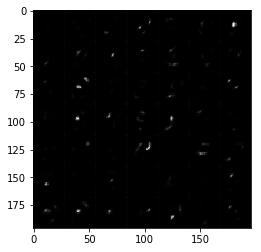

Epoch 1/4... Discriminator Loss: 1.2849... Generator Loss: 0.7501
Epoch 1/4... Discriminator Loss: 1.0580... Generator Loss: 3.3460
Epoch 1/4... Discriminator Loss: 0.4928... Generator Loss: 2.5578
Epoch 1/4... Discriminator Loss: 0.5676... Generator Loss: 3.7708
Epoch 1/4... Discriminator Loss: 2.9270... Generator Loss: 5.7182
Epoch 1/4... Discriminator Loss: 0.9259... Generator Loss: 1.0578
Epoch 1/4... Discriminator Loss: 2.0257... Generator Loss: 0.2892
Epoch 1/4... Discriminator Loss: 0.9320... Generator Loss: 1.0261
Epoch 1/4... Discriminator Loss: 0.9212... Generator Loss: 2.8580
Epoch 1/4... Discriminator Loss: 2.1768... Generator Loss: 0.2468


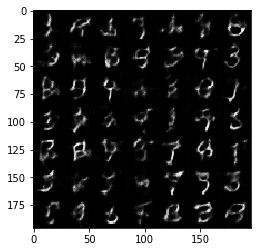

Epoch 1/4... Discriminator Loss: 2.4657... Generator Loss: 0.1901
Epoch 1/4... Discriminator Loss: 0.9675... Generator Loss: 2.5893
Epoch 1/4... Discriminator Loss: 2.9551... Generator Loss: 5.5211
Epoch 1/4... Discriminator Loss: 2.0639... Generator Loss: 0.2633
Epoch 1/4... Discriminator Loss: 1.0089... Generator Loss: 2.4901
Epoch 1/4... Discriminator Loss: 1.2021... Generator Loss: 0.9097
Epoch 1/4... Discriminator Loss: 1.9773... Generator Loss: 0.3679
Epoch 1/4... Discriminator Loss: 1.3817... Generator Loss: 0.6427
Epoch 1/4... Discriminator Loss: 1.1655... Generator Loss: 2.0654
Epoch 1/4... Discriminator Loss: 2.2340... Generator Loss: 0.2736


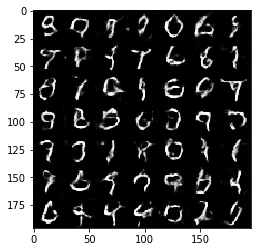

Epoch 1/4... Discriminator Loss: 0.9898... Generator Loss: 1.6965
Epoch 1/4... Discriminator Loss: 2.0204... Generator Loss: 3.0898
Epoch 1/4... Discriminator Loss: 1.4590... Generator Loss: 0.5394
Epoch 1/4... Discriminator Loss: 1.4093... Generator Loss: 0.5544
Epoch 1/4... Discriminator Loss: 1.7359... Generator Loss: 0.5097
Epoch 1/4... Discriminator Loss: 1.4231... Generator Loss: 0.5521
Epoch 1/4... Discriminator Loss: 2.6748... Generator Loss: 0.1428
Epoch 1/4... Discriminator Loss: 1.7519... Generator Loss: 0.3531
Epoch 1/4... Discriminator Loss: 1.2853... Generator Loss: 0.6162
Epoch 1/4... Discriminator Loss: 2.7358... Generator Loss: 0.1715


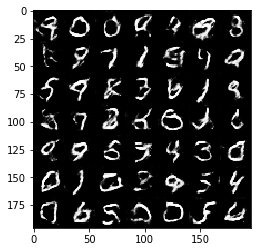

Epoch 1/4... Discriminator Loss: 1.7395... Generator Loss: 0.4139
Epoch 1/4... Discriminator Loss: 0.8029... Generator Loss: 1.9939
Epoch 1/4... Discriminator Loss: 1.5239... Generator Loss: 0.4924
Epoch 1/4... Discriminator Loss: 1.3234... Generator Loss: 0.7334
Epoch 1/4... Discriminator Loss: 1.0761... Generator Loss: 0.9127
Epoch 1/4... Discriminator Loss: 1.0811... Generator Loss: 0.8964
Epoch 1/4... Discriminator Loss: 1.1865... Generator Loss: 0.7034
Epoch 1/4... Discriminator Loss: 1.2284... Generator Loss: 2.7825
Epoch 1/4... Discriminator Loss: 1.0127... Generator Loss: 1.0435
Epoch 1/4... Discriminator Loss: 0.8304... Generator Loss: 1.4810


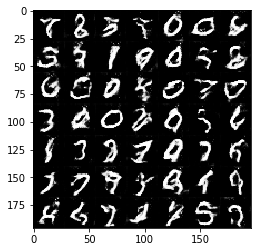

Epoch 1/4... Discriminator Loss: 1.9062... Generator Loss: 0.3101
Epoch 1/4... Discriminator Loss: 0.7790... Generator Loss: 1.6911
Epoch 1/4... Discriminator Loss: 0.7516... Generator Loss: 1.7149
Epoch 1/4... Discriminator Loss: 1.7260... Generator Loss: 0.3948
Epoch 1/4... Discriminator Loss: 0.8368... Generator Loss: 1.2684
Epoch 1/4... Discriminator Loss: 1.6164... Generator Loss: 4.5082
Epoch 1/4... Discriminator Loss: 0.7336... Generator Loss: 1.4020
Epoch 1/4... Discriminator Loss: 0.8973... Generator Loss: 1.2994
Epoch 1/4... Discriminator Loss: 1.1578... Generator Loss: 0.8036
Epoch 1/4... Discriminator Loss: 1.0898... Generator Loss: 1.0761


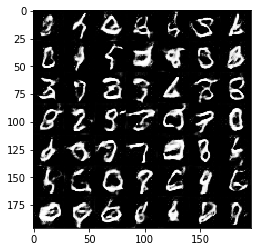

Epoch 1/4... Discriminator Loss: 1.5531... Generator Loss: 0.5129
Epoch 1/4... Discriminator Loss: 1.0223... Generator Loss: 2.0161
Epoch 1/4... Discriminator Loss: 1.1137... Generator Loss: 0.9170
Epoch 1/4... Discriminator Loss: 1.0813... Generator Loss: 1.8165
Epoch 1/4... Discriminator Loss: 0.9527... Generator Loss: 2.7961
Epoch 1/4... Discriminator Loss: 0.9388... Generator Loss: 1.0954
Epoch 1/4... Discriminator Loss: 0.9681... Generator Loss: 2.2700
Epoch 1/4... Discriminator Loss: 1.0937... Generator Loss: 0.8931
Epoch 1/4... Discriminator Loss: 0.8089... Generator Loss: 1.4467
Epoch 1/4... Discriminator Loss: 1.0909... Generator Loss: 0.8367


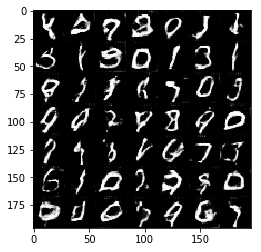

Epoch 1/4... Discriminator Loss: 1.1491... Generator Loss: 3.5440
Epoch 1/4... Discriminator Loss: 0.7442... Generator Loss: 1.3667
Epoch 1/4... Discriminator Loss: 0.7692... Generator Loss: 1.7255
Epoch 1/4... Discriminator Loss: 0.7431... Generator Loss: 2.5076
Epoch 1/4... Discriminator Loss: 0.7649... Generator Loss: 3.5214
Epoch 1/4... Discriminator Loss: 0.6813... Generator Loss: 1.6128
Epoch 1/4... Discriminator Loss: 1.8205... Generator Loss: 0.4211
Epoch 1/4... Discriminator Loss: 0.8743... Generator Loss: 1.3498
Epoch 1/4... Discriminator Loss: 1.1101... Generator Loss: 0.8992
Epoch 1/4... Discriminator Loss: 1.8768... Generator Loss: 0.3391


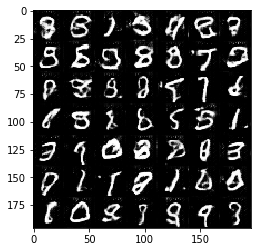

Epoch 1/4... Discriminator Loss: 0.6881... Generator Loss: 3.0498
Epoch 1/4... Discriminator Loss: 1.6877... Generator Loss: 0.4666
Epoch 1/4... Discriminator Loss: 1.4230... Generator Loss: 0.7260
Epoch 1/4... Discriminator Loss: 0.6633... Generator Loss: 1.9240
Epoch 1/4... Discriminator Loss: 0.6589... Generator Loss: 1.6925
Epoch 1/4... Discriminator Loss: 0.9036... Generator Loss: 1.5860
Epoch 1/4... Discriminator Loss: 1.0595... Generator Loss: 1.0024
Epoch 1/4... Discriminator Loss: 2.2718... Generator Loss: 0.2191
Epoch 1/4... Discriminator Loss: 1.3464... Generator Loss: 0.6325
Epoch 1/4... Discriminator Loss: 0.9352... Generator Loss: 1.1288


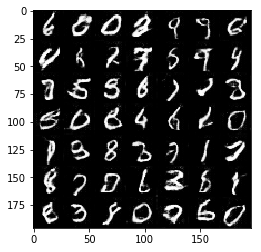

Epoch 1/4... Discriminator Loss: 0.7827... Generator Loss: 1.7910
Epoch 1/4... Discriminator Loss: 0.8879... Generator Loss: 1.2097
Epoch 1/4... Discriminator Loss: 2.0091... Generator Loss: 3.9508
Epoch 1/4... Discriminator Loss: 1.2559... Generator Loss: 0.6860
Epoch 1/4... Discriminator Loss: 0.7207... Generator Loss: 2.7040
Epoch 1/4... Discriminator Loss: 0.7238... Generator Loss: 2.6862
Epoch 1/4... Discriminator Loss: 1.1173... Generator Loss: 0.8704
Epoch 1/4... Discriminator Loss: 1.0394... Generator Loss: 2.9136
Epoch 1/4... Discriminator Loss: 1.0583... Generator Loss: 2.4093
Epoch 1/4... Discriminator Loss: 0.9417... Generator Loss: 1.0703


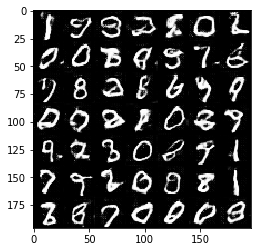

Epoch 1/4... Discriminator Loss: 0.7595... Generator Loss: 1.3158
Epoch 1/4... Discriminator Loss: 1.3279... Generator Loss: 0.6831
Epoch 1/4... Discriminator Loss: 2.5574... Generator Loss: 0.2288
Epoch 1/4... Discriminator Loss: 0.6666... Generator Loss: 1.7641
Epoch 1/4... Discriminator Loss: 0.8154... Generator Loss: 1.3019
Epoch 1/4... Discriminator Loss: 1.4302... Generator Loss: 0.6030
Epoch 1/4... Discriminator Loss: 0.6884... Generator Loss: 1.6256
Epoch 1/4... Discriminator Loss: 0.7851... Generator Loss: 3.6426
Epoch 1/4... Discriminator Loss: 0.6816... Generator Loss: 1.6492
Epoch 1/4... Discriminator Loss: 0.9394... Generator Loss: 1.0500


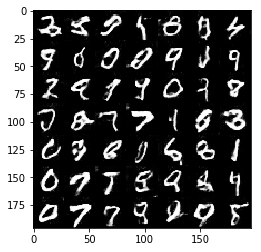

Epoch 1/4... Discriminator Loss: 1.4003... Generator Loss: 0.6576
Epoch 1/4... Discriminator Loss: 1.0353... Generator Loss: 2.4408
Epoch 1/4... Discriminator Loss: 1.8256... Generator Loss: 0.3921
Epoch 1/4... Discriminator Loss: 0.9446... Generator Loss: 0.9053
Epoch 1/4... Discriminator Loss: 1.6159... Generator Loss: 4.0280
Epoch 1/4... Discriminator Loss: 1.0675... Generator Loss: 0.8902
Epoch 1/4... Discriminator Loss: 0.8114... Generator Loss: 1.9080
Epoch 1/4... Discriminator Loss: 0.8522... Generator Loss: 2.9221
Epoch 1/4... Discriminator Loss: 0.6526... Generator Loss: 2.0530
Epoch 1/4... Discriminator Loss: 1.6667... Generator Loss: 0.5478


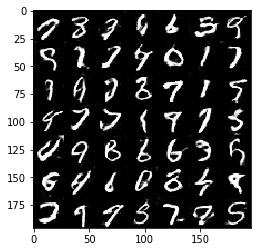

Epoch 1/4... Discriminator Loss: 0.7084... Generator Loss: 1.6556
Epoch 1/4... Discriminator Loss: 1.0308... Generator Loss: 1.1178
Epoch 1/4... Discriminator Loss: 1.1360... Generator Loss: 0.7326
Epoch 1/4... Discriminator Loss: 0.6947... Generator Loss: 1.6179
Epoch 1/4... Discriminator Loss: 0.8132... Generator Loss: 2.0021
Epoch 1/4... Discriminator Loss: 1.0032... Generator Loss: 2.1478
Epoch 1/4... Discriminator Loss: 2.2973... Generator Loss: 0.2344
Epoch 1/4... Discriminator Loss: 0.7088... Generator Loss: 1.7106
Epoch 1/4... Discriminator Loss: 0.9279... Generator Loss: 1.0382
Epoch 1/4... Discriminator Loss: 1.1515... Generator Loss: 0.7812


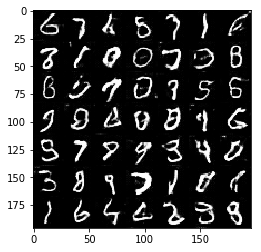

Epoch 1/4... Discriminator Loss: 0.6616... Generator Loss: 2.3345
Epoch 1/4... Discriminator Loss: 2.0175... Generator Loss: 0.3595
Epoch 1/4... Discriminator Loss: 0.9299... Generator Loss: 1.1081
Epoch 1/4... Discriminator Loss: 0.8575... Generator Loss: 3.2605
Epoch 1/4... Discriminator Loss: 0.7321... Generator Loss: 1.4792
Epoch 1/4... Discriminator Loss: 2.6808... Generator Loss: 0.1954
Epoch 1/4... Discriminator Loss: 0.8945... Generator Loss: 1.2013
Epoch 1/4... Discriminator Loss: 0.5972... Generator Loss: 2.0966
Epoch 1/4... Discriminator Loss: 0.7219... Generator Loss: 1.6670
Epoch 1/4... Discriminator Loss: 0.8239... Generator Loss: 1.5426


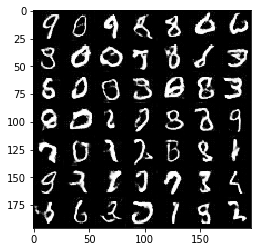

Epoch 1/4... Discriminator Loss: 0.8649... Generator Loss: 1.2870
Epoch 1/4... Discriminator Loss: 0.7855... Generator Loss: 1.4726
Epoch 1/4... Discriminator Loss: 1.8037... Generator Loss: 5.2771
Epoch 1/4... Discriminator Loss: 1.0781... Generator Loss: 0.8732
Epoch 1/4... Discriminator Loss: 0.7278... Generator Loss: 1.4804
Epoch 1/4... Discriminator Loss: 0.9753... Generator Loss: 0.9664
Epoch 1/4... Discriminator Loss: 1.0311... Generator Loss: 0.9101
Epoch 1/4... Discriminator Loss: 1.1331... Generator Loss: 0.8586
Epoch 1/4... Discriminator Loss: 0.9723... Generator Loss: 2.9629
Epoch 1/4... Discriminator Loss: 0.7440... Generator Loss: 1.6033


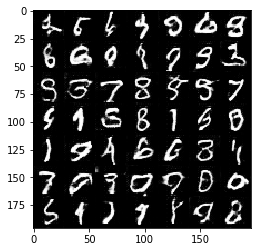

Epoch 1/4... Discriminator Loss: 1.4585... Generator Loss: 0.6664
Epoch 1/4... Discriminator Loss: 0.7780... Generator Loss: 1.8105
Epoch 1/4... Discriminator Loss: 0.9210... Generator Loss: 1.1803
Epoch 1/4... Discriminator Loss: 0.5846... Generator Loss: 2.4074
Epoch 1/4... Discriminator Loss: 0.5556... Generator Loss: 2.0591
Epoch 1/4... Discriminator Loss: 0.5394... Generator Loss: 2.4905
Epoch 1/4... Discriminator Loss: 0.3946... Generator Loss: 4.3549
Epoch 1/4... Discriminator Loss: 0.8524... Generator Loss: 1.1496
Epoch 1/4... Discriminator Loss: 1.3820... Generator Loss: 0.8023
Epoch 1/4... Discriminator Loss: 0.4979... Generator Loss: 3.6105


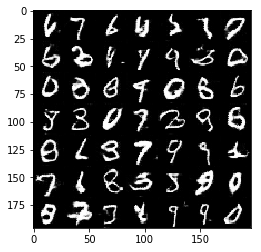

Epoch 1/4... Discriminator Loss: 0.6796... Generator Loss: 1.7378
Epoch 1/4... Discriminator Loss: 0.8965... Generator Loss: 1.0988
Epoch 1/4... Discriminator Loss: 0.6415... Generator Loss: 1.9178
Epoch 1/4... Discriminator Loss: 1.2466... Generator Loss: 0.7845
Epoch 1/4... Discriminator Loss: 0.8265... Generator Loss: 1.5232
Epoch 1/4... Discriminator Loss: 0.6236... Generator Loss: 2.1914
Epoch 1/4... Discriminator Loss: 0.9546... Generator Loss: 1.4193
Epoch 1/4... Discriminator Loss: 0.6583... Generator Loss: 2.0889
Epoch 1/4... Discriminator Loss: 1.0207... Generator Loss: 1.0734
Epoch 1/4... Discriminator Loss: 0.7698... Generator Loss: 1.8089


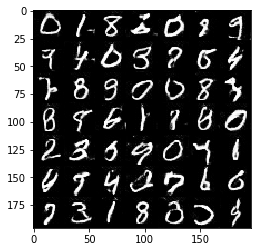

Epoch 1/4... Discriminator Loss: 0.6380... Generator Loss: 1.9306
Epoch 1/4... Discriminator Loss: 0.6168... Generator Loss: 2.5795
Epoch 1/4... Discriminator Loss: 2.5949... Generator Loss: 0.1861
Epoch 1/4... Discriminator Loss: 0.9325... Generator Loss: 1.4363
Epoch 1/4... Discriminator Loss: 1.4247... Generator Loss: 0.7630
Epoch 1/4... Discriminator Loss: 2.2506... Generator Loss: 0.2756
Epoch 1/4... Discriminator Loss: 0.8925... Generator Loss: 1.3568
Epoch 1/4... Discriminator Loss: 0.7904... Generator Loss: 1.3786
Epoch 1/4... Discriminator Loss: 0.8119... Generator Loss: 1.6048
Epoch 1/4... Discriminator Loss: 0.7241... Generator Loss: 1.5116


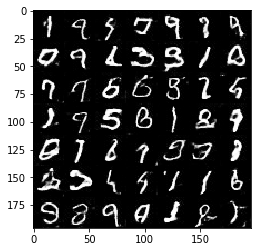

Epoch 1/4... Discriminator Loss: 0.8576... Generator Loss: 1.3422
Epoch 1/4... Discriminator Loss: 0.6428... Generator Loss: 1.6615
Epoch 1/4... Discriminator Loss: 0.9014... Generator Loss: 2.2089
Epoch 1/4... Discriminator Loss: 0.7983... Generator Loss: 2.4021
Epoch 1/4... Discriminator Loss: 0.8927... Generator Loss: 1.1858
Epoch 1/4... Discriminator Loss: 1.3885... Generator Loss: 0.6187
Epoch 1/4... Discriminator Loss: 0.8127... Generator Loss: 1.5313
Epoch 2/4... Discriminator Loss: 0.6686... Generator Loss: 2.2349
Epoch 2/4... Discriminator Loss: 1.8220... Generator Loss: 0.3715
Epoch 2/4... Discriminator Loss: 0.6394... Generator Loss: 1.8842


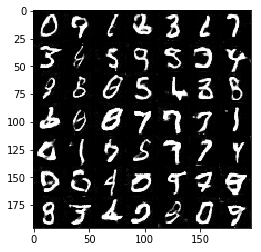

Epoch 2/4... Discriminator Loss: 0.9005... Generator Loss: 1.4016
Epoch 2/4... Discriminator Loss: 0.5915... Generator Loss: 2.2424
Epoch 2/4... Discriminator Loss: 0.9886... Generator Loss: 1.0429
Epoch 2/4... Discriminator Loss: 0.6982... Generator Loss: 1.8446
Epoch 2/4... Discriminator Loss: 0.7279... Generator Loss: 1.4691
Epoch 2/4... Discriminator Loss: 0.6862... Generator Loss: 1.7426
Epoch 2/4... Discriminator Loss: 1.1866... Generator Loss: 0.7235
Epoch 2/4... Discriminator Loss: 1.8991... Generator Loss: 0.4871
Epoch 2/4... Discriminator Loss: 0.7699... Generator Loss: 1.4437
Epoch 2/4... Discriminator Loss: 0.7825... Generator Loss: 1.9391


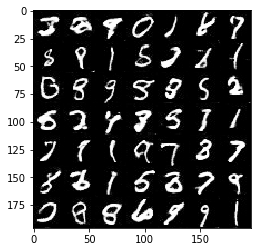

Epoch 2/4... Discriminator Loss: 1.1145... Generator Loss: 0.9862
Epoch 2/4... Discriminator Loss: 0.6176... Generator Loss: 2.0245
Epoch 2/4... Discriminator Loss: 0.7267... Generator Loss: 1.4139
Epoch 2/4... Discriminator Loss: 0.5960... Generator Loss: 1.7696
Epoch 2/4... Discriminator Loss: 0.8727... Generator Loss: 1.1883
Epoch 2/4... Discriminator Loss: 1.1963... Generator Loss: 0.8309
Epoch 2/4... Discriminator Loss: 1.0297... Generator Loss: 3.2565
Epoch 2/4... Discriminator Loss: 0.9595... Generator Loss: 1.1473
Epoch 2/4... Discriminator Loss: 2.4522... Generator Loss: 0.2350
Epoch 2/4... Discriminator Loss: 0.5314... Generator Loss: 2.8848


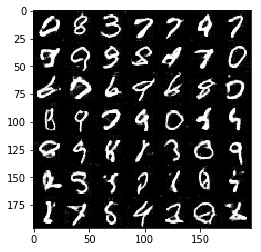

Epoch 2/4... Discriminator Loss: 1.4421... Generator Loss: 0.6488
Epoch 2/4... Discriminator Loss: 0.8866... Generator Loss: 3.0023
Epoch 2/4... Discriminator Loss: 0.5597... Generator Loss: 2.2562
Epoch 2/4... Discriminator Loss: 0.6787... Generator Loss: 2.9474
Epoch 2/4... Discriminator Loss: 1.6593... Generator Loss: 0.5422
Epoch 2/4... Discriminator Loss: 0.7405... Generator Loss: 1.4203
Epoch 2/4... Discriminator Loss: 1.1683... Generator Loss: 0.8955
Epoch 2/4... Discriminator Loss: 1.4803... Generator Loss: 0.4824
Epoch 2/4... Discriminator Loss: 0.6567... Generator Loss: 1.9095
Epoch 2/4... Discriminator Loss: 0.7255... Generator Loss: 2.4922


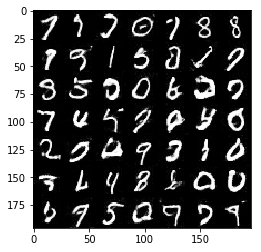

Epoch 2/4... Discriminator Loss: 0.6481... Generator Loss: 1.9025
Epoch 2/4... Discriminator Loss: 1.1362... Generator Loss: 3.6596
Epoch 2/4... Discriminator Loss: 1.5415... Generator Loss: 0.6234
Epoch 2/4... Discriminator Loss: 0.6386... Generator Loss: 1.8531
Epoch 2/4... Discriminator Loss: 0.7370... Generator Loss: 1.5840
Epoch 2/4... Discriminator Loss: 0.5792... Generator Loss: 2.5702
Epoch 2/4... Discriminator Loss: 0.6566... Generator Loss: 1.9414
Epoch 2/4... Discriminator Loss: 0.7186... Generator Loss: 3.0658
Epoch 2/4... Discriminator Loss: 1.3926... Generator Loss: 0.6314
Epoch 2/4... Discriminator Loss: 0.7966... Generator Loss: 3.0773


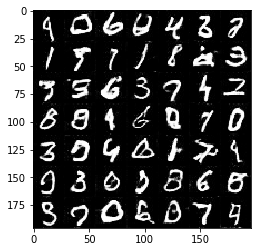

Epoch 2/4... Discriminator Loss: 1.1000... Generator Loss: 0.8980
Epoch 2/4... Discriminator Loss: 0.6904... Generator Loss: 1.7982
Epoch 2/4... Discriminator Loss: 0.6261... Generator Loss: 1.8424
Epoch 2/4... Discriminator Loss: 0.8185... Generator Loss: 1.5170
Epoch 2/4... Discriminator Loss: 0.5023... Generator Loss: 2.9081
Epoch 2/4... Discriminator Loss: 0.8369... Generator Loss: 1.3781
Epoch 2/4... Discriminator Loss: 1.1742... Generator Loss: 0.9277
Epoch 2/4... Discriminator Loss: 0.8315... Generator Loss: 1.3442
Epoch 2/4... Discriminator Loss: 0.7503... Generator Loss: 1.5763
Epoch 2/4... Discriminator Loss: 0.8349... Generator Loss: 1.2733


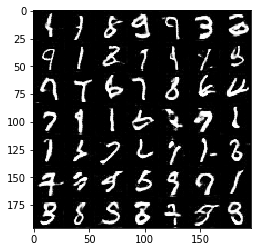

Epoch 2/4... Discriminator Loss: 1.2165... Generator Loss: 1.9555
Epoch 2/4... Discriminator Loss: 1.5264... Generator Loss: 2.9263
Epoch 2/4... Discriminator Loss: 1.2947... Generator Loss: 0.6573
Epoch 2/4... Discriminator Loss: 1.1118... Generator Loss: 2.5603
Epoch 2/4... Discriminator Loss: 1.1291... Generator Loss: 0.8675
Epoch 2/4... Discriminator Loss: 1.4241... Generator Loss: 0.6788
Epoch 2/4... Discriminator Loss: 1.4173... Generator Loss: 0.5619
Epoch 2/4... Discriminator Loss: 0.7921... Generator Loss: 1.3139
Epoch 2/4... Discriminator Loss: 0.6770... Generator Loss: 2.3262
Epoch 2/4... Discriminator Loss: 2.8128... Generator Loss: 0.2051


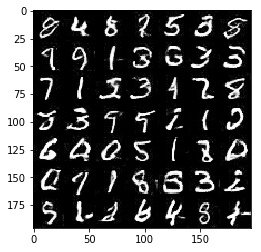

Epoch 2/4... Discriminator Loss: 0.8769... Generator Loss: 1.3550
Epoch 2/4... Discriminator Loss: 0.8621... Generator Loss: 1.1953
Epoch 2/4... Discriminator Loss: 0.8265... Generator Loss: 1.3544
Epoch 2/4... Discriminator Loss: 0.6341... Generator Loss: 2.7165
Epoch 2/4... Discriminator Loss: 1.3678... Generator Loss: 0.7521
Epoch 2/4... Discriminator Loss: 1.1556... Generator Loss: 0.9330
Epoch 2/4... Discriminator Loss: 1.0057... Generator Loss: 0.9662
Epoch 2/4... Discriminator Loss: 0.7193... Generator Loss: 1.8648
Epoch 2/4... Discriminator Loss: 1.7276... Generator Loss: 0.4578
Epoch 2/4... Discriminator Loss: 1.4700... Generator Loss: 0.6481


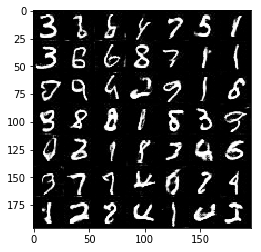

Epoch 2/4... Discriminator Loss: 1.3505... Generator Loss: 0.7510
Epoch 2/4... Discriminator Loss: 0.5441... Generator Loss: 2.3177
Epoch 2/4... Discriminator Loss: 1.0851... Generator Loss: 1.1744
Epoch 2/4... Discriminator Loss: 2.0086... Generator Loss: 0.5269
Epoch 2/4... Discriminator Loss: 1.4426... Generator Loss: 0.5584
Epoch 2/4... Discriminator Loss: 0.6341... Generator Loss: 1.9481
Epoch 2/4... Discriminator Loss: 0.9511... Generator Loss: 1.0717
Epoch 2/4... Discriminator Loss: 0.6248... Generator Loss: 1.8406
Epoch 2/4... Discriminator Loss: 0.6214... Generator Loss: 1.9147
Epoch 2/4... Discriminator Loss: 0.8509... Generator Loss: 1.4628


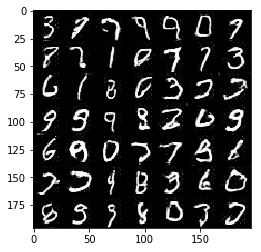

Epoch 2/4... Discriminator Loss: 0.7186... Generator Loss: 2.5292
Epoch 2/4... Discriminator Loss: 1.1007... Generator Loss: 1.0127
Epoch 2/4... Discriminator Loss: 2.0790... Generator Loss: 0.3274
Epoch 2/4... Discriminator Loss: 0.5815... Generator Loss: 3.3841
Epoch 2/4... Discriminator Loss: 1.1181... Generator Loss: 0.9172
Epoch 2/4... Discriminator Loss: 1.2515... Generator Loss: 0.8712
Epoch 2/4... Discriminator Loss: 0.7703... Generator Loss: 1.4953
Epoch 2/4... Discriminator Loss: 0.6696... Generator Loss: 2.7749
Epoch 2/4... Discriminator Loss: 1.2139... Generator Loss: 0.7642
Epoch 2/4... Discriminator Loss: 0.6779... Generator Loss: 1.8259


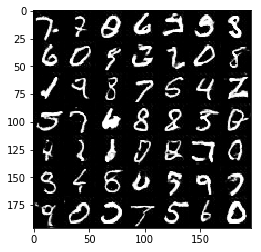

Epoch 2/4... Discriminator Loss: 0.8780... Generator Loss: 1.1875
Epoch 2/4... Discriminator Loss: 0.5705... Generator Loss: 2.2435
Epoch 2/4... Discriminator Loss: 0.5324... Generator Loss: 2.4164
Epoch 2/4... Discriminator Loss: 0.6121... Generator Loss: 2.3997
Epoch 2/4... Discriminator Loss: 0.7151... Generator Loss: 1.4634
Epoch 2/4... Discriminator Loss: 0.8910... Generator Loss: 1.1885
Epoch 2/4... Discriminator Loss: 0.6826... Generator Loss: 1.7766
Epoch 2/4... Discriminator Loss: 0.6629... Generator Loss: 1.8003
Epoch 2/4... Discriminator Loss: 0.6624... Generator Loss: 2.0081
Epoch 2/4... Discriminator Loss: 0.7196... Generator Loss: 3.7564


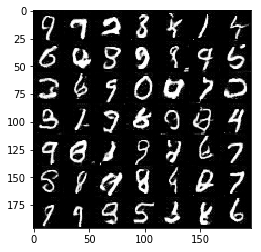

Epoch 2/4... Discriminator Loss: 0.5311... Generator Loss: 2.3152
Epoch 2/4... Discriminator Loss: 0.6247... Generator Loss: 2.1587
Epoch 2/4... Discriminator Loss: 0.5522... Generator Loss: 2.0498
Epoch 2/4... Discriminator Loss: 0.9717... Generator Loss: 1.2263
Epoch 2/4... Discriminator Loss: 0.5088... Generator Loss: 2.4230
Epoch 2/4... Discriminator Loss: 0.4670... Generator Loss: 2.4740
Epoch 2/4... Discriminator Loss: 0.6025... Generator Loss: 1.9241
Epoch 2/4... Discriminator Loss: 0.8422... Generator Loss: 1.2362
Epoch 2/4... Discriminator Loss: 0.6725... Generator Loss: 1.7209
Epoch 2/4... Discriminator Loss: 1.0901... Generator Loss: 0.9323


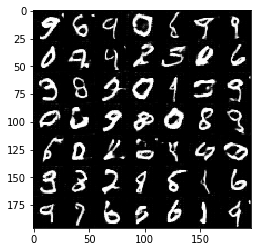

Epoch 2/4... Discriminator Loss: 0.7260... Generator Loss: 2.8676
Epoch 2/4... Discriminator Loss: 0.7226... Generator Loss: 2.0864
Epoch 2/4... Discriminator Loss: 0.5806... Generator Loss: 3.6683
Epoch 2/4... Discriminator Loss: 0.6723... Generator Loss: 1.8480
Epoch 2/4... Discriminator Loss: 0.6293... Generator Loss: 1.9172
Epoch 2/4... Discriminator Loss: 0.5694... Generator Loss: 2.0000
Epoch 2/4... Discriminator Loss: 0.6446... Generator Loss: 1.7569
Epoch 2/4... Discriminator Loss: 0.9927... Generator Loss: 3.8448
Epoch 2/4... Discriminator Loss: 2.6984... Generator Loss: 0.1940
Epoch 2/4... Discriminator Loss: 1.4856... Generator Loss: 0.7235


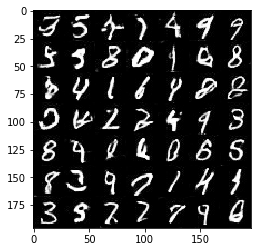

Epoch 2/4... Discriminator Loss: 1.5417... Generator Loss: 4.2464
Epoch 2/4... Discriminator Loss: 2.3280... Generator Loss: 0.3306
Epoch 2/4... Discriminator Loss: 0.7314... Generator Loss: 1.6286
Epoch 2/4... Discriminator Loss: 1.1036... Generator Loss: 0.9607
Epoch 2/4... Discriminator Loss: 0.8991... Generator Loss: 1.4279
Epoch 2/4... Discriminator Loss: 0.5940... Generator Loss: 1.8572
Epoch 2/4... Discriminator Loss: 0.5544... Generator Loss: 2.4298
Epoch 2/4... Discriminator Loss: 0.6974... Generator Loss: 2.5102
Epoch 2/4... Discriminator Loss: 1.1417... Generator Loss: 1.0065
Epoch 2/4... Discriminator Loss: 0.7122... Generator Loss: 1.7148


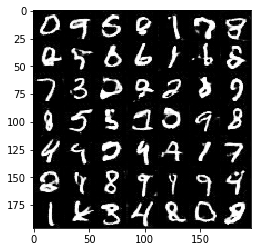

Epoch 2/4... Discriminator Loss: 1.6689... Generator Loss: 0.5815
Epoch 2/4... Discriminator Loss: 1.7525... Generator Loss: 0.6024
Epoch 2/4... Discriminator Loss: 1.0444... Generator Loss: 1.0216
Epoch 2/4... Discriminator Loss: 0.9667... Generator Loss: 1.1003
Epoch 2/4... Discriminator Loss: 0.9803... Generator Loss: 1.1068
Epoch 2/4... Discriminator Loss: 0.5210... Generator Loss: 2.9280
Epoch 2/4... Discriminator Loss: 1.6800... Generator Loss: 0.5290
Epoch 2/4... Discriminator Loss: 0.9238... Generator Loss: 1.0502
Epoch 2/4... Discriminator Loss: 0.8260... Generator Loss: 1.3347
Epoch 2/4... Discriminator Loss: 0.8280... Generator Loss: 1.3765


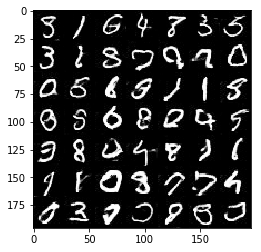

Epoch 2/4... Discriminator Loss: 0.9828... Generator Loss: 0.9403
Epoch 2/4... Discriminator Loss: 0.7401... Generator Loss: 1.5079
Epoch 2/4... Discriminator Loss: 0.7697... Generator Loss: 1.5494
Epoch 2/4... Discriminator Loss: 0.5562... Generator Loss: 2.2757
Epoch 2/4... Discriminator Loss: 0.7388... Generator Loss: 1.4512
Epoch 2/4... Discriminator Loss: 0.5539... Generator Loss: 3.0710
Epoch 2/4... Discriminator Loss: 0.6851... Generator Loss: 1.7266
Epoch 2/4... Discriminator Loss: 0.5814... Generator Loss: 1.9471
Epoch 2/4... Discriminator Loss: 0.6123... Generator Loss: 3.0027
Epoch 2/4... Discriminator Loss: 0.8976... Generator Loss: 1.0701


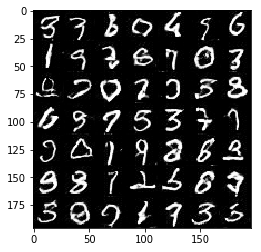

Epoch 2/4... Discriminator Loss: 1.4271... Generator Loss: 0.5531
Epoch 2/4... Discriminator Loss: 0.7256... Generator Loss: 2.8352
Epoch 2/4... Discriminator Loss: 1.9958... Generator Loss: 0.4322
Epoch 2/4... Discriminator Loss: 1.0344... Generator Loss: 0.8924
Epoch 2/4... Discriminator Loss: 0.6865... Generator Loss: 1.7651
Epoch 2/4... Discriminator Loss: 2.6098... Generator Loss: 0.1969
Epoch 2/4... Discriminator Loss: 0.7605... Generator Loss: 1.4396
Epoch 2/4... Discriminator Loss: 0.6142... Generator Loss: 2.8637
Epoch 2/4... Discriminator Loss: 0.8539... Generator Loss: 1.4030
Epoch 2/4... Discriminator Loss: 0.5564... Generator Loss: 2.1600


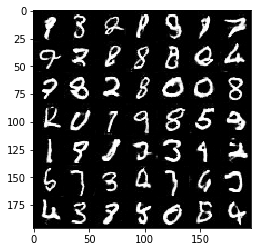

Epoch 2/4... Discriminator Loss: 1.1267... Generator Loss: 0.9626
Epoch 2/4... Discriminator Loss: 0.7551... Generator Loss: 2.9344
Epoch 2/4... Discriminator Loss: 0.6634... Generator Loss: 1.7099
Epoch 2/4... Discriminator Loss: 0.6850... Generator Loss: 1.6732
Epoch 2/4... Discriminator Loss: 0.9142... Generator Loss: 1.3281
Epoch 2/4... Discriminator Loss: 0.7348... Generator Loss: 2.8079
Epoch 2/4... Discriminator Loss: 0.7730... Generator Loss: 1.7033
Epoch 2/4... Discriminator Loss: 1.1601... Generator Loss: 0.7920
Epoch 2/4... Discriminator Loss: 2.5370... Generator Loss: 0.2717
Epoch 2/4... Discriminator Loss: 0.5977... Generator Loss: 2.1289


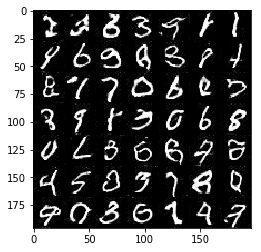

Epoch 2/4... Discriminator Loss: 0.5989... Generator Loss: 2.9766
Epoch 2/4... Discriminator Loss: 1.0101... Generator Loss: 3.7278
Epoch 2/4... Discriminator Loss: 0.9297... Generator Loss: 1.2500
Epoch 2/4... Discriminator Loss: 1.0789... Generator Loss: 0.9729
Epoch 2/4... Discriminator Loss: 0.7914... Generator Loss: 1.4868
Epoch 2/4... Discriminator Loss: 2.3418... Generator Loss: 0.2616
Epoch 2/4... Discriminator Loss: 2.0316... Generator Loss: 0.3892
Epoch 2/4... Discriminator Loss: 1.4591... Generator Loss: 0.5938
Epoch 2/4... Discriminator Loss: 1.2806... Generator Loss: 0.7709
Epoch 2/4... Discriminator Loss: 0.8594... Generator Loss: 2.1812


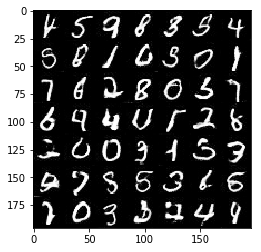

Epoch 2/4... Discriminator Loss: 0.4956... Generator Loss: 3.9021
Epoch 2/4... Discriminator Loss: 0.7191... Generator Loss: 1.5360
Epoch 2/4... Discriminator Loss: 0.6471... Generator Loss: 2.3599
Epoch 2/4... Discriminator Loss: 0.6864... Generator Loss: 1.5617
Epoch 2/4... Discriminator Loss: 0.6053... Generator Loss: 2.3636
Epoch 3/4... Discriminator Loss: 2.2218... Generator Loss: 0.3206
Epoch 3/4... Discriminator Loss: 1.4973... Generator Loss: 0.6746
Epoch 3/4... Discriminator Loss: 1.9328... Generator Loss: 0.3799
Epoch 3/4... Discriminator Loss: 0.5432... Generator Loss: 2.2198
Epoch 3/4... Discriminator Loss: 0.9182... Generator Loss: 1.2156


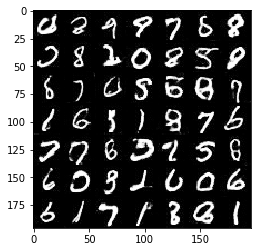

Epoch 3/4... Discriminator Loss: 1.6407... Generator Loss: 0.5340
Epoch 3/4... Discriminator Loss: 0.7479... Generator Loss: 1.5142
Epoch 3/4... Discriminator Loss: 0.6751... Generator Loss: 1.6108
Epoch 3/4... Discriminator Loss: 0.5768... Generator Loss: 3.0291
Epoch 3/4... Discriminator Loss: 0.6021... Generator Loss: 2.0087
Epoch 3/4... Discriminator Loss: 0.7155... Generator Loss: 1.8542
Epoch 3/4... Discriminator Loss: 0.6914... Generator Loss: 2.0947
Epoch 3/4... Discriminator Loss: 1.0012... Generator Loss: 1.1266
Epoch 3/4... Discriminator Loss: 1.5519... Generator Loss: 0.5680
Epoch 3/4... Discriminator Loss: 1.9823... Generator Loss: 0.4220


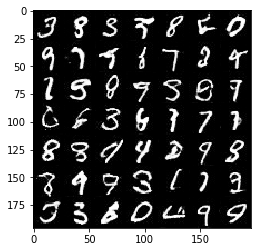

Epoch 3/4... Discriminator Loss: 0.5934... Generator Loss: 2.4211
Epoch 3/4... Discriminator Loss: 1.6077... Generator Loss: 0.4916
Epoch 3/4... Discriminator Loss: 0.4777... Generator Loss: 2.6545
Epoch 3/4... Discriminator Loss: 0.5877... Generator Loss: 2.1923
Epoch 3/4... Discriminator Loss: 0.8741... Generator Loss: 1.2494
Epoch 3/4... Discriminator Loss: 3.2824... Generator Loss: 0.1120
Epoch 3/4... Discriminator Loss: 0.6049... Generator Loss: 1.9301
Epoch 3/4... Discriminator Loss: 0.7846... Generator Loss: 1.4312
Epoch 3/4... Discriminator Loss: 0.5945... Generator Loss: 2.2287
Epoch 3/4... Discriminator Loss: 1.8961... Generator Loss: 0.4315


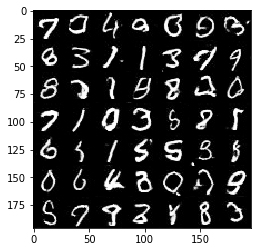

Epoch 3/4... Discriminator Loss: 0.5413... Generator Loss: 2.9449
Epoch 3/4... Discriminator Loss: 3.0088... Generator Loss: 0.1338
Epoch 3/4... Discriminator Loss: 0.8850... Generator Loss: 1.2391
Epoch 3/4... Discriminator Loss: 1.0000... Generator Loss: 1.0953
Epoch 3/4... Discriminator Loss: 0.8490... Generator Loss: 1.6023
Epoch 3/4... Discriminator Loss: 0.5533... Generator Loss: 2.4068
Epoch 3/4... Discriminator Loss: 0.8916... Generator Loss: 1.4338
Epoch 3/4... Discriminator Loss: 0.5373... Generator Loss: 2.9483
Epoch 3/4... Discriminator Loss: 0.8707... Generator Loss: 1.1573
Epoch 3/4... Discriminator Loss: 1.0457... Generator Loss: 1.3217


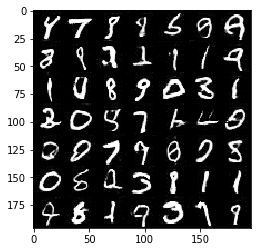

Epoch 3/4... Discriminator Loss: 1.2367... Generator Loss: 0.7634
Epoch 3/4... Discriminator Loss: 1.5263... Generator Loss: 0.5868
Epoch 3/4... Discriminator Loss: 1.5280... Generator Loss: 0.6037
Epoch 3/4... Discriminator Loss: 0.8816... Generator Loss: 1.2684
Epoch 3/4... Discriminator Loss: 1.0072... Generator Loss: 1.0851
Epoch 3/4... Discriminator Loss: 3.0683... Generator Loss: 0.1482
Epoch 3/4... Discriminator Loss: 0.5766... Generator Loss: 2.3827
Epoch 3/4... Discriminator Loss: 0.7122... Generator Loss: 3.1359
Epoch 3/4... Discriminator Loss: 2.2868... Generator Loss: 0.3547
Epoch 3/4... Discriminator Loss: 0.7098... Generator Loss: 2.1979


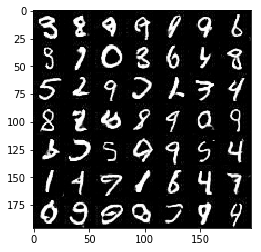

Epoch 3/4... Discriminator Loss: 0.8587... Generator Loss: 1.1638
Epoch 3/4... Discriminator Loss: 2.8198... Generator Loss: 0.2022
Epoch 3/4... Discriminator Loss: 1.1191... Generator Loss: 2.4816
Epoch 3/4... Discriminator Loss: 2.3385... Generator Loss: 0.3139
Epoch 3/4... Discriminator Loss: 0.6937... Generator Loss: 1.7368
Epoch 3/4... Discriminator Loss: 0.9546... Generator Loss: 1.0318
Epoch 3/4... Discriminator Loss: 0.6102... Generator Loss: 1.8553
Epoch 3/4... Discriminator Loss: 0.9927... Generator Loss: 0.9074
Epoch 3/4... Discriminator Loss: 2.8680... Generator Loss: 0.1745
Epoch 3/4... Discriminator Loss: 0.5872... Generator Loss: 2.2025


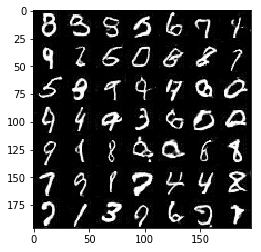

Epoch 3/4... Discriminator Loss: 0.8889... Generator Loss: 3.4312
Epoch 3/4... Discriminator Loss: 0.6774... Generator Loss: 1.7119
Epoch 3/4... Discriminator Loss: 0.8069... Generator Loss: 1.4726
Epoch 3/4... Discriminator Loss: 0.8467... Generator Loss: 1.3918
Epoch 3/4... Discriminator Loss: 0.9935... Generator Loss: 1.0575
Epoch 3/4... Discriminator Loss: 0.9051... Generator Loss: 1.2690
Epoch 3/4... Discriminator Loss: 1.9811... Generator Loss: 0.4455
Epoch 3/4... Discriminator Loss: 0.5939... Generator Loss: 2.0824
Epoch 3/4... Discriminator Loss: 0.6625... Generator Loss: 2.1126
Epoch 3/4... Discriminator Loss: 0.8432... Generator Loss: 1.6957


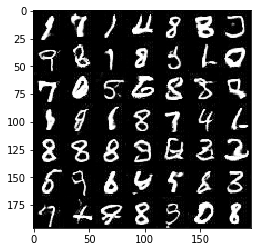

Epoch 3/4... Discriminator Loss: 0.8613... Generator Loss: 1.3261
Epoch 3/4... Discriminator Loss: 0.7890... Generator Loss: 2.3092
Epoch 3/4... Discriminator Loss: 0.7588... Generator Loss: 1.5885
Epoch 3/4... Discriminator Loss: 0.6552... Generator Loss: 1.9974
Epoch 3/4... Discriminator Loss: 0.6060... Generator Loss: 1.8948
Epoch 3/4... Discriminator Loss: 0.6669... Generator Loss: 1.7704
Epoch 3/4... Discriminator Loss: 0.4848... Generator Loss: 2.8722
Epoch 3/4... Discriminator Loss: 1.0312... Generator Loss: 1.1310
Epoch 3/4... Discriminator Loss: 0.8652... Generator Loss: 1.2427
Epoch 3/4... Discriminator Loss: 0.7265... Generator Loss: 2.2964


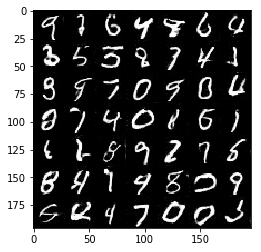

Epoch 3/4... Discriminator Loss: 0.5733... Generator Loss: 2.0016
Epoch 3/4... Discriminator Loss: 2.5133... Generator Loss: 0.3278
Epoch 3/4... Discriminator Loss: 0.5606... Generator Loss: 2.0364
Epoch 3/4... Discriminator Loss: 0.5548... Generator Loss: 2.2024
Epoch 3/4... Discriminator Loss: 2.4437... Generator Loss: 0.2698
Epoch 3/4... Discriminator Loss: 1.0229... Generator Loss: 1.0296
Epoch 3/4... Discriminator Loss: 1.1507... Generator Loss: 0.9634
Epoch 3/4... Discriminator Loss: 2.1927... Generator Loss: 0.4190
Epoch 3/4... Discriminator Loss: 0.5213... Generator Loss: 2.4282
Epoch 3/4... Discriminator Loss: 0.4068... Generator Loss: 3.7297


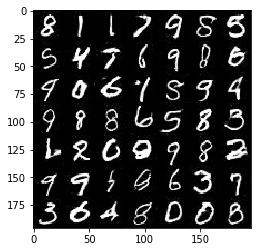

Epoch 3/4... Discriminator Loss: 2.1021... Generator Loss: 0.3002
Epoch 3/4... Discriminator Loss: 0.6560... Generator Loss: 1.7605
Epoch 3/4... Discriminator Loss: 1.3741... Generator Loss: 0.7016
Epoch 3/4... Discriminator Loss: 0.7718... Generator Loss: 1.3602
Epoch 3/4... Discriminator Loss: 0.7317... Generator Loss: 1.7132
Epoch 3/4... Discriminator Loss: 0.7636... Generator Loss: 1.5748
Epoch 3/4... Discriminator Loss: 1.0116... Generator Loss: 1.1892
Epoch 3/4... Discriminator Loss: 1.4953... Generator Loss: 4.4442
Epoch 3/4... Discriminator Loss: 0.5616... Generator Loss: 2.1628
Epoch 3/4... Discriminator Loss: 1.7123... Generator Loss: 0.4389


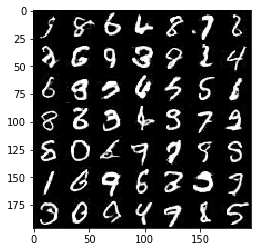

Epoch 3/4... Discriminator Loss: 0.6012... Generator Loss: 2.2677
Epoch 3/4... Discriminator Loss: 0.5614... Generator Loss: 2.1200
Epoch 3/4... Discriminator Loss: 0.6533... Generator Loss: 2.5498
Epoch 3/4... Discriminator Loss: 1.1431... Generator Loss: 0.9082
Epoch 3/4... Discriminator Loss: 0.5614... Generator Loss: 2.0568
Epoch 3/4... Discriminator Loss: 1.5565... Generator Loss: 0.5330
Epoch 3/4... Discriminator Loss: 0.5333... Generator Loss: 2.6333
Epoch 3/4... Discriminator Loss: 0.6098... Generator Loss: 2.0537
Epoch 3/4... Discriminator Loss: 1.2582... Generator Loss: 0.7308
Epoch 3/4... Discriminator Loss: 0.5335... Generator Loss: 2.6457


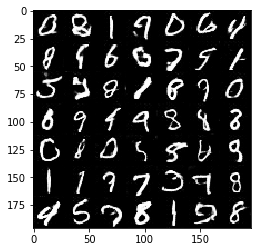

Epoch 3/4... Discriminator Loss: 0.8017... Generator Loss: 1.3389
Epoch 3/4... Discriminator Loss: 0.8829... Generator Loss: 1.2940
Epoch 3/4... Discriminator Loss: 0.6184... Generator Loss: 2.3036
Epoch 3/4... Discriminator Loss: 0.7029... Generator Loss: 1.7729
Epoch 3/4... Discriminator Loss: 0.5494... Generator Loss: 2.0598
Epoch 3/4... Discriminator Loss: 3.0330... Generator Loss: 0.2030
Epoch 3/4... Discriminator Loss: 0.6742... Generator Loss: 2.1319
Epoch 3/4... Discriminator Loss: 1.3052... Generator Loss: 0.7753
Epoch 3/4... Discriminator Loss: 1.5864... Generator Loss: 0.5805
Epoch 3/4... Discriminator Loss: 0.5769... Generator Loss: 2.5397


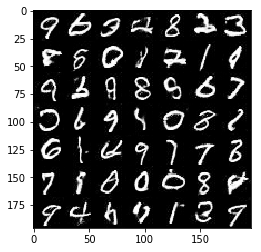

Epoch 3/4... Discriminator Loss: 0.8434... Generator Loss: 1.4616
Epoch 3/4... Discriminator Loss: 0.6448... Generator Loss: 2.6214
Epoch 3/4... Discriminator Loss: 0.6854... Generator Loss: 1.7124
Epoch 3/4... Discriminator Loss: 0.6147... Generator Loss: 1.7416
Epoch 3/4... Discriminator Loss: 2.3122... Generator Loss: 0.3102
Epoch 3/4... Discriminator Loss: 0.7632... Generator Loss: 1.6799
Epoch 3/4... Discriminator Loss: 0.6439... Generator Loss: 1.9948
Epoch 3/4... Discriminator Loss: 0.8750... Generator Loss: 1.3275
Epoch 3/4... Discriminator Loss: 0.6184... Generator Loss: 2.0425
Epoch 3/4... Discriminator Loss: 1.0444... Generator Loss: 1.0026


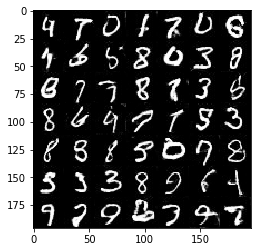

Epoch 3/4... Discriminator Loss: 0.6738... Generator Loss: 1.6316
Epoch 3/4... Discriminator Loss: 1.3509... Generator Loss: 0.6847
Epoch 3/4... Discriminator Loss: 0.4874... Generator Loss: 2.4871
Epoch 3/4... Discriminator Loss: 1.0226... Generator Loss: 1.1186
Epoch 3/4... Discriminator Loss: 1.3822... Generator Loss: 3.9285
Epoch 3/4... Discriminator Loss: 0.4896... Generator Loss: 2.5533
Epoch 3/4... Discriminator Loss: 0.5799... Generator Loss: 1.9720
Epoch 3/4... Discriminator Loss: 1.2663... Generator Loss: 0.7939
Epoch 3/4... Discriminator Loss: 0.6755... Generator Loss: 2.0172
Epoch 3/4... Discriminator Loss: 0.7012... Generator Loss: 2.1618


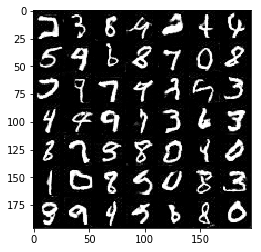

Epoch 3/4... Discriminator Loss: 2.2778... Generator Loss: 0.3466
Epoch 3/4... Discriminator Loss: 0.9008... Generator Loss: 1.3950
Epoch 3/4... Discriminator Loss: 0.5559... Generator Loss: 2.6286
Epoch 3/4... Discriminator Loss: 1.0448... Generator Loss: 1.0044
Epoch 3/4... Discriminator Loss: 2.4607... Generator Loss: 0.2544
Epoch 3/4... Discriminator Loss: 0.6625... Generator Loss: 2.1354
Epoch 3/4... Discriminator Loss: 1.2324... Generator Loss: 0.9122
Epoch 3/4... Discriminator Loss: 0.9038... Generator Loss: 1.2005
Epoch 3/4... Discriminator Loss: 0.9578... Generator Loss: 1.1340
Epoch 3/4... Discriminator Loss: 0.5896... Generator Loss: 2.0009


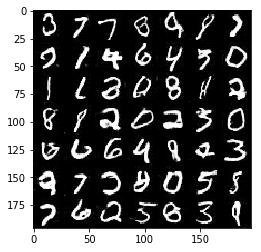

Epoch 3/4... Discriminator Loss: 0.5980... Generator Loss: 1.9319
Epoch 3/4... Discriminator Loss: 1.4505... Generator Loss: 0.8196
Epoch 3/4... Discriminator Loss: 0.6544... Generator Loss: 1.7049
Epoch 3/4... Discriminator Loss: 0.7784... Generator Loss: 1.4611
Epoch 3/4... Discriminator Loss: 0.8424... Generator Loss: 4.4639
Epoch 3/4... Discriminator Loss: 0.8289... Generator Loss: 1.6398
Epoch 3/4... Discriminator Loss: 2.0783... Generator Loss: 0.3309
Epoch 3/4... Discriminator Loss: 1.7758... Generator Loss: 0.5290
Epoch 3/4... Discriminator Loss: 0.5060... Generator Loss: 2.8929
Epoch 3/4... Discriminator Loss: 0.8438... Generator Loss: 1.4167


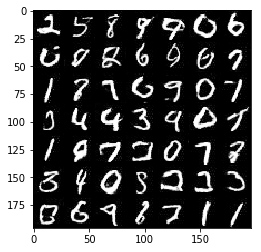

Epoch 3/4... Discriminator Loss: 0.6663... Generator Loss: 1.6741
Epoch 3/4... Discriminator Loss: 0.7554... Generator Loss: 1.5852
Epoch 3/4... Discriminator Loss: 0.9927... Generator Loss: 0.9724
Epoch 3/4... Discriminator Loss: 0.4960... Generator Loss: 2.7987
Epoch 3/4... Discriminator Loss: 1.1630... Generator Loss: 0.9248
Epoch 3/4... Discriminator Loss: 0.5901... Generator Loss: 2.0811
Epoch 3/4... Discriminator Loss: 0.6057... Generator Loss: 2.3421
Epoch 3/4... Discriminator Loss: 0.5335... Generator Loss: 2.1297
Epoch 3/4... Discriminator Loss: 0.5106... Generator Loss: 2.6842
Epoch 3/4... Discriminator Loss: 0.5512... Generator Loss: 2.3194


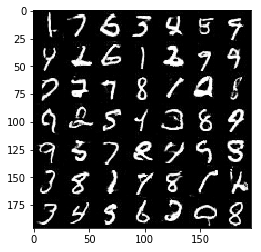

Epoch 3/4... Discriminator Loss: 0.5442... Generator Loss: 2.6828
Epoch 3/4... Discriminator Loss: 1.8689... Generator Loss: 0.4355
Epoch 3/4... Discriminator Loss: 0.5118... Generator Loss: 2.6453
Epoch 3/4... Discriminator Loss: 1.0531... Generator Loss: 1.0606
Epoch 3/4... Discriminator Loss: 0.5584... Generator Loss: 2.6510
Epoch 3/4... Discriminator Loss: 0.6682... Generator Loss: 1.5631
Epoch 3/4... Discriminator Loss: 1.8217... Generator Loss: 6.3649
Epoch 3/4... Discriminator Loss: 0.8453... Generator Loss: 1.2819
Epoch 3/4... Discriminator Loss: 0.9986... Generator Loss: 1.1111
Epoch 3/4... Discriminator Loss: 0.8446... Generator Loss: 1.3523


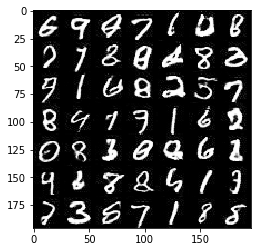

Epoch 3/4... Discriminator Loss: 1.6005... Generator Loss: 0.5117
Epoch 3/4... Discriminator Loss: 0.6987... Generator Loss: 1.5945
Epoch 3/4... Discriminator Loss: 0.6447... Generator Loss: 2.1322
Epoch 3/4... Discriminator Loss: 0.5795... Generator Loss: 2.3104
Epoch 3/4... Discriminator Loss: 0.5990... Generator Loss: 1.9358
Epoch 3/4... Discriminator Loss: 0.7454... Generator Loss: 1.6893
Epoch 3/4... Discriminator Loss: 0.7369... Generator Loss: 1.5203
Epoch 3/4... Discriminator Loss: 1.6976... Generator Loss: 0.6046
Epoch 3/4... Discriminator Loss: 0.7865... Generator Loss: 1.3789
Epoch 3/4... Discriminator Loss: 1.2408... Generator Loss: 0.7217


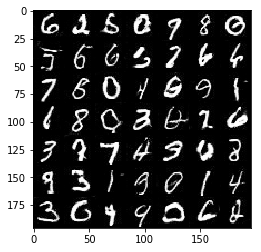

Epoch 3/4... Discriminator Loss: 1.2369... Generator Loss: 0.6555
Epoch 3/4... Discriminator Loss: 1.0920... Generator Loss: 0.9659
Epoch 4/4... Discriminator Loss: 0.6568... Generator Loss: 1.7721
Epoch 4/4... Discriminator Loss: 0.8504... Generator Loss: 5.1328
Epoch 4/4... Discriminator Loss: 0.6576... Generator Loss: 1.5312
Epoch 4/4... Discriminator Loss: 0.8427... Generator Loss: 3.3660
Epoch 4/4... Discriminator Loss: 1.1224... Generator Loss: 0.9510
Epoch 4/4... Discriminator Loss: 0.7418... Generator Loss: 1.5478
Epoch 4/4... Discriminator Loss: 0.7428... Generator Loss: 2.2898
Epoch 4/4... Discriminator Loss: 0.5478... Generator Loss: 2.9413


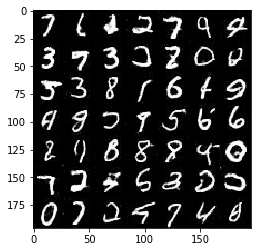

Epoch 4/4... Discriminator Loss: 0.5926... Generator Loss: 2.2017
Epoch 4/4... Discriminator Loss: 1.6364... Generator Loss: 0.6312
Epoch 4/4... Discriminator Loss: 0.6941... Generator Loss: 1.7831
Epoch 4/4... Discriminator Loss: 0.6641... Generator Loss: 1.7756
Epoch 4/4... Discriminator Loss: 1.8847... Generator Loss: 0.5530
Epoch 4/4... Discriminator Loss: 0.6228... Generator Loss: 2.0524
Epoch 4/4... Discriminator Loss: 0.9966... Generator Loss: 1.2652
Epoch 4/4... Discriminator Loss: 1.1067... Generator Loss: 0.8704
Epoch 4/4... Discriminator Loss: 0.5930... Generator Loss: 2.0244
Epoch 4/4... Discriminator Loss: 0.5074... Generator Loss: 3.2307


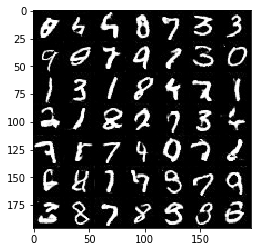

Epoch 4/4... Discriminator Loss: 0.5841... Generator Loss: 2.7614
Epoch 4/4... Discriminator Loss: 0.9173... Generator Loss: 1.3262
Epoch 4/4... Discriminator Loss: 0.7701... Generator Loss: 1.4374
Epoch 4/4... Discriminator Loss: 0.5965... Generator Loss: 2.8557
Epoch 4/4... Discriminator Loss: 0.8313... Generator Loss: 4.0874
Epoch 4/4... Discriminator Loss: 1.2038... Generator Loss: 0.9147
Epoch 4/4... Discriminator Loss: 0.6905... Generator Loss: 1.7407
Epoch 4/4... Discriminator Loss: 0.6560... Generator Loss: 1.7757
Epoch 4/4... Discriminator Loss: 0.5519... Generator Loss: 2.5907
Epoch 4/4... Discriminator Loss: 0.6080... Generator Loss: 1.8114


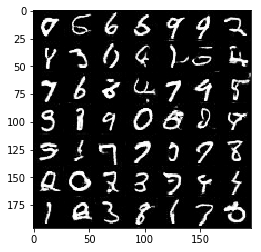

Epoch 4/4... Discriminator Loss: 0.4764... Generator Loss: 2.6458
Epoch 4/4... Discriminator Loss: 0.5500... Generator Loss: 2.0689
Epoch 4/4... Discriminator Loss: 0.7868... Generator Loss: 1.4291
Epoch 4/4... Discriminator Loss: 0.5537... Generator Loss: 2.6937
Epoch 4/4... Discriminator Loss: 0.6662... Generator Loss: 1.7781
Epoch 4/4... Discriminator Loss: 0.7939... Generator Loss: 1.7337
Epoch 4/4... Discriminator Loss: 0.6307... Generator Loss: 2.5550
Epoch 4/4... Discriminator Loss: 0.8522... Generator Loss: 2.8628
Epoch 4/4... Discriminator Loss: 0.6051... Generator Loss: 2.0922
Epoch 4/4... Discriminator Loss: 0.7873... Generator Loss: 1.5353


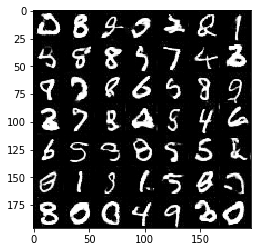

Epoch 4/4... Discriminator Loss: 0.4688... Generator Loss: 2.7658
Epoch 4/4... Discriminator Loss: 0.7467... Generator Loss: 1.4376
Epoch 4/4... Discriminator Loss: 0.4581... Generator Loss: 2.6790
Epoch 4/4... Discriminator Loss: 2.3811... Generator Loss: 0.4811
Epoch 4/4... Discriminator Loss: 1.0233... Generator Loss: 1.0381
Epoch 4/4... Discriminator Loss: 0.9417... Generator Loss: 1.2225
Epoch 4/4... Discriminator Loss: 1.3144... Generator Loss: 0.9905
Epoch 4/4... Discriminator Loss: 0.5964... Generator Loss: 2.0004
Epoch 4/4... Discriminator Loss: 0.6723... Generator Loss: 1.7437
Epoch 4/4... Discriminator Loss: 0.6476... Generator Loss: 1.9410


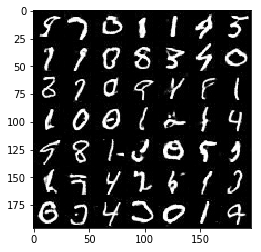

Epoch 4/4... Discriminator Loss: 2.0486... Generator Loss: 0.4010
Epoch 4/4... Discriminator Loss: 0.5812... Generator Loss: 2.7169
Epoch 4/4... Discriminator Loss: 0.7698... Generator Loss: 1.4630
Epoch 4/4... Discriminator Loss: 1.8764... Generator Loss: 0.4652
Epoch 4/4... Discriminator Loss: 0.9108... Generator Loss: 1.1532
Epoch 4/4... Discriminator Loss: 2.1743... Generator Loss: 0.3745
Epoch 4/4... Discriminator Loss: 0.5246... Generator Loss: 2.3597
Epoch 4/4... Discriminator Loss: 0.5164... Generator Loss: 2.3772
Epoch 4/4... Discriminator Loss: 0.6398... Generator Loss: 1.9717
Epoch 4/4... Discriminator Loss: 1.2528... Generator Loss: 0.7722


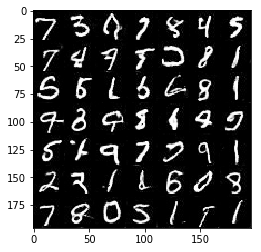

Epoch 4/4... Discriminator Loss: 0.7858... Generator Loss: 1.7979
Epoch 4/4... Discriminator Loss: 1.0185... Generator Loss: 3.7522
Epoch 4/4... Discriminator Loss: 0.9776... Generator Loss: 1.5982
Epoch 4/4... Discriminator Loss: 2.1426... Generator Loss: 0.6770
Epoch 4/4... Discriminator Loss: 0.9323... Generator Loss: 1.1879
Epoch 4/4... Discriminator Loss: 0.6820... Generator Loss: 1.7857
Epoch 4/4... Discriminator Loss: 0.5112... Generator Loss: 2.6835
Epoch 4/4... Discriminator Loss: 0.6887... Generator Loss: 1.6636
Epoch 4/4... Discriminator Loss: 0.9170... Generator Loss: 3.5807
Epoch 4/4... Discriminator Loss: 1.1418... Generator Loss: 4.3594


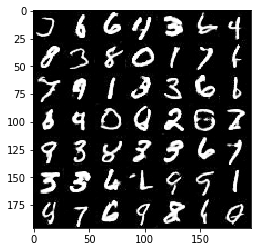

Epoch 4/4... Discriminator Loss: 0.6683... Generator Loss: 2.0958
Epoch 4/4... Discriminator Loss: 1.3264... Generator Loss: 0.7398
Epoch 4/4... Discriminator Loss: 1.6842... Generator Loss: 0.5774
Epoch 4/4... Discriminator Loss: 0.8468... Generator Loss: 1.6106
Epoch 4/4... Discriminator Loss: 0.5865... Generator Loss: 2.1075
Epoch 4/4... Discriminator Loss: 0.7351... Generator Loss: 1.6041
Epoch 4/4... Discriminator Loss: 0.4553... Generator Loss: 2.9162
Epoch 4/4... Discriminator Loss: 0.6769... Generator Loss: 1.7627
Epoch 4/4... Discriminator Loss: 2.1561... Generator Loss: 0.4331
Epoch 4/4... Discriminator Loss: 1.0416... Generator Loss: 1.0612


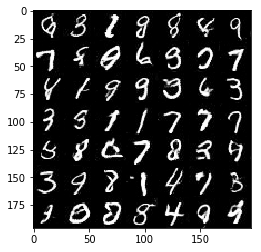

Epoch 4/4... Discriminator Loss: 0.9959... Generator Loss: 3.1055
Epoch 4/4... Discriminator Loss: 0.7754... Generator Loss: 2.3088
Epoch 4/4... Discriminator Loss: 0.5734... Generator Loss: 2.2209
Epoch 4/4... Discriminator Loss: 0.6574... Generator Loss: 1.6902
Epoch 4/4... Discriminator Loss: 0.7501... Generator Loss: 1.4830
Epoch 4/4... Discriminator Loss: 0.7068... Generator Loss: 1.6098
Epoch 4/4... Discriminator Loss: 0.6683... Generator Loss: 1.7032
Epoch 4/4... Discriminator Loss: 0.7211... Generator Loss: 1.7768
Epoch 4/4... Discriminator Loss: 1.1238... Generator Loss: 3.9638
Epoch 4/4... Discriminator Loss: 0.5061... Generator Loss: 2.4458


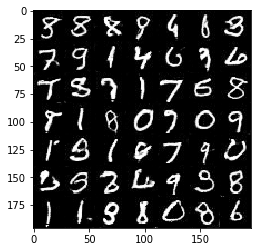

Epoch 4/4... Discriminator Loss: 0.6273... Generator Loss: 2.0779
Epoch 4/4... Discriminator Loss: 1.0878... Generator Loss: 4.0544
Epoch 4/4... Discriminator Loss: 0.4537... Generator Loss: 2.8774
Epoch 4/4... Discriminator Loss: 0.8684... Generator Loss: 1.4107
Epoch 4/4... Discriminator Loss: 0.9031... Generator Loss: 2.9047
Epoch 4/4... Discriminator Loss: 0.8381... Generator Loss: 2.8195
Epoch 4/4... Discriminator Loss: 0.8602... Generator Loss: 1.3930
Epoch 4/4... Discriminator Loss: 0.5963... Generator Loss: 2.1762
Epoch 4/4... Discriminator Loss: 0.7284... Generator Loss: 2.9056
Epoch 4/4... Discriminator Loss: 0.7953... Generator Loss: 1.3009


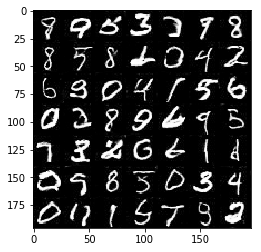

Epoch 4/4... Discriminator Loss: 1.3835... Generator Loss: 0.7011
Epoch 4/4... Discriminator Loss: 0.9263... Generator Loss: 1.1261
Epoch 4/4... Discriminator Loss: 0.5334... Generator Loss: 2.6176
Epoch 4/4... Discriminator Loss: 0.8572... Generator Loss: 1.2678
Epoch 4/4... Discriminator Loss: 0.5596... Generator Loss: 2.9591
Epoch 4/4... Discriminator Loss: 0.5319... Generator Loss: 2.2384
Epoch 4/4... Discriminator Loss: 0.6231... Generator Loss: 2.0832
Epoch 4/4... Discriminator Loss: 0.4049... Generator Loss: 3.6473
Epoch 4/4... Discriminator Loss: 0.6074... Generator Loss: 1.9118
Epoch 4/4... Discriminator Loss: 0.5894... Generator Loss: 2.0251


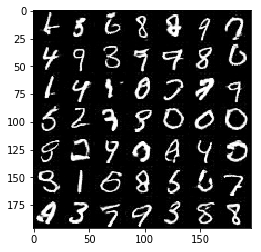

Epoch 4/4... Discriminator Loss: 0.3880... Generator Loss: 4.1611
Epoch 4/4... Discriminator Loss: 0.5220... Generator Loss: 2.6875
Epoch 4/4... Discriminator Loss: 1.9573... Generator Loss: 0.4848
Epoch 4/4... Discriminator Loss: 1.5780... Generator Loss: 0.5525
Epoch 4/4... Discriminator Loss: 0.6229... Generator Loss: 1.7821
Epoch 4/4... Discriminator Loss: 0.5603... Generator Loss: 2.4100
Epoch 4/4... Discriminator Loss: 0.6585... Generator Loss: 1.7364
Epoch 4/4... Discriminator Loss: 0.5335... Generator Loss: 2.3045
Epoch 4/4... Discriminator Loss: 0.6710... Generator Loss: 1.7685
Epoch 4/4... Discriminator Loss: 0.6896... Generator Loss: 1.6012


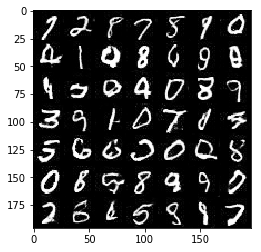

Epoch 4/4... Discriminator Loss: 0.5107... Generator Loss: 2.3947
Epoch 4/4... Discriminator Loss: 0.5756... Generator Loss: 2.1188
Epoch 4/4... Discriminator Loss: 0.5755... Generator Loss: 2.3128
Epoch 4/4... Discriminator Loss: 1.5105... Generator Loss: 0.6415
Epoch 4/4... Discriminator Loss: 0.5145... Generator Loss: 2.5950
Epoch 4/4... Discriminator Loss: 0.5079... Generator Loss: 2.6484
Epoch 4/4... Discriminator Loss: 1.8277... Generator Loss: 0.5967
Epoch 4/4... Discriminator Loss: 0.5455... Generator Loss: 2.5668
Epoch 4/4... Discriminator Loss: 0.5934... Generator Loss: 2.4446
Epoch 4/4... Discriminator Loss: 0.6237... Generator Loss: 1.8267


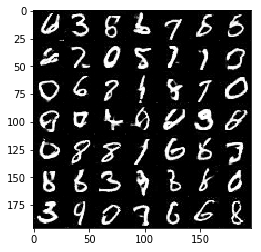

Epoch 4/4... Discriminator Loss: 0.8423... Generator Loss: 1.2750
Epoch 4/4... Discriminator Loss: 0.7440... Generator Loss: 1.5841
Epoch 4/4... Discriminator Loss: 1.6711... Generator Loss: 0.4757
Epoch 4/4... Discriminator Loss: 0.7160... Generator Loss: 1.5418
Epoch 4/4... Discriminator Loss: 2.8648... Generator Loss: 0.2367
Epoch 4/4... Discriminator Loss: 1.3401... Generator Loss: 0.8056
Epoch 4/4... Discriminator Loss: 1.4808... Generator Loss: 0.7462
Epoch 4/4... Discriminator Loss: 2.8121... Generator Loss: 0.1964
Epoch 4/4... Discriminator Loss: 0.6129... Generator Loss: 2.0322
Epoch 4/4... Discriminator Loss: 0.5722... Generator Loss: 2.0358


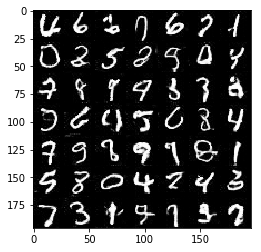

Epoch 4/4... Discriminator Loss: 0.8258... Generator Loss: 1.3414
Epoch 4/4... Discriminator Loss: 0.7534... Generator Loss: 1.3268
Epoch 4/4... Discriminator Loss: 0.6556... Generator Loss: 1.8766
Epoch 4/4... Discriminator Loss: 1.2460... Generator Loss: 0.8399
Epoch 4/4... Discriminator Loss: 1.1164... Generator Loss: 0.9913
Epoch 4/4... Discriminator Loss: 1.0657... Generator Loss: 0.9994
Epoch 4/4... Discriminator Loss: 0.7453... Generator Loss: 1.5011
Epoch 4/4... Discriminator Loss: 1.2796... Generator Loss: 4.7894
Epoch 4/4... Discriminator Loss: 0.7092... Generator Loss: 1.8749
Epoch 4/4... Discriminator Loss: 0.6912... Generator Loss: 2.8717


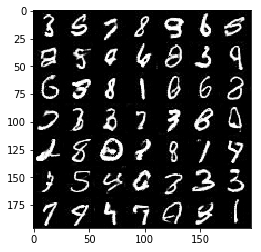

Epoch 4/4... Discriminator Loss: 0.4645... Generator Loss: 3.1693
Epoch 4/4... Discriminator Loss: 0.7190... Generator Loss: 1.7041
Epoch 4/4... Discriminator Loss: 0.6479... Generator Loss: 1.9564
Epoch 4/4... Discriminator Loss: 0.7360... Generator Loss: 4.0362
Epoch 4/4... Discriminator Loss: 1.1423... Generator Loss: 0.7803
Epoch 4/4... Discriminator Loss: 1.0833... Generator Loss: 0.9560
Epoch 4/4... Discriminator Loss: 1.0917... Generator Loss: 0.8466
Epoch 4/4... Discriminator Loss: 1.9500... Generator Loss: 0.5130
Epoch 4/4... Discriminator Loss: 1.0516... Generator Loss: 1.1439
Epoch 4/4... Discriminator Loss: 0.8576... Generator Loss: 1.4863


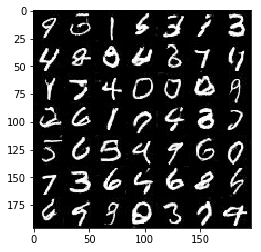

Epoch 4/4... Discriminator Loss: 2.6944... Generator Loss: 0.2422
Epoch 4/4... Discriminator Loss: 0.7054... Generator Loss: 1.5315
Epoch 4/4... Discriminator Loss: 0.5142... Generator Loss: 2.2841
Epoch 4/4... Discriminator Loss: 1.3077... Generator Loss: 4.3854
Epoch 4/4... Discriminator Loss: 0.5518... Generator Loss: 2.6227
Epoch 4/4... Discriminator Loss: 0.8668... Generator Loss: 1.4203
Epoch 4/4... Discriminator Loss: 0.6395... Generator Loss: 3.1814
Epoch 4/4... Discriminator Loss: 0.8597... Generator Loss: 1.2355
Epoch 4/4... Discriminator Loss: 0.6592... Generator Loss: 1.9180
Epoch 4/4... Discriminator Loss: 1.2657... Generator Loss: 0.9179


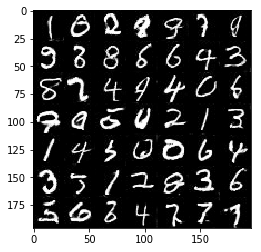

Epoch 4/4... Discriminator Loss: 1.0402... Generator Loss: 1.2597
Epoch 4/4... Discriminator Loss: 0.5143... Generator Loss: 2.6869
Epoch 4/4... Discriminator Loss: 0.7754... Generator Loss: 1.3756
Epoch 4/4... Discriminator Loss: 2.2700... Generator Loss: 0.3177
Epoch 4/4... Discriminator Loss: 1.0841... Generator Loss: 1.2996
Epoch 4/4... Discriminator Loss: 0.4949... Generator Loss: 2.9875
Epoch 4/4... Discriminator Loss: 0.6249... Generator Loss: 3.1207
Epoch 4/4... Discriminator Loss: 0.5131... Generator Loss: 2.6750
Epoch 4/4... Discriminator Loss: 0.7055... Generator Loss: 1.6147
Epoch 4/4... Discriminator Loss: 0.7250... Generator Loss: 1.6859


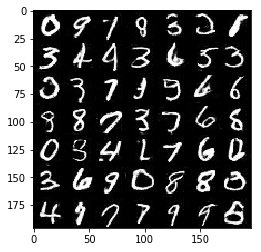

Epoch 4/4... Discriminator Loss: 1.3354... Generator Loss: 0.7324
Epoch 4/4... Discriminator Loss: 2.2555... Generator Loss: 0.3085
Epoch 4/4... Discriminator Loss: 1.5239... Generator Loss: 0.5823
Epoch 4/4... Discriminator Loss: 0.5512... Generator Loss: 2.1723
Epoch 4/4... Discriminator Loss: 1.0605... Generator Loss: 1.0188
Epoch 4/4... Discriminator Loss: 0.6790... Generator Loss: 1.6100
Epoch 4/4... Discriminator Loss: 0.7137... Generator Loss: 1.6531
Epoch 4/4... Discriminator Loss: 0.7807... Generator Loss: 1.3320
Epoch 4/4... Discriminator Loss: 0.6137... Generator Loss: 2.4556
Epoch 4/4... Discriminator Loss: 0.6740... Generator Loss: 1.7638


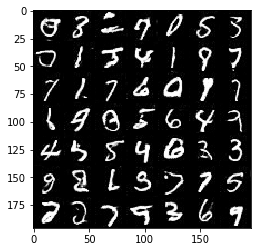

In [13]:
batch_size = 32
z_dim = 100
learning_rate = 0.001
beta1 = 0.5
alpha = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 4

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode, alpha)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/2... Discriminator Loss: 0.5854... Generator Loss: 6.7570
Epoch 1/2... Discriminator Loss: 0.6802... Generator Loss: 4.4777
Epoch 1/2... Discriminator Loss: 1.4947... Generator Loss: 1.7702
Epoch 1/2... Discriminator Loss: 0.4272... Generator Loss: 3.3604
Epoch 1/2... Discriminator Loss: 0.5467... Generator Loss: 2.1707
Epoch 1/2... Discriminator Loss: 0.3743... Generator Loss: 3.8602
Epoch 1/2... Discriminator Loss: 0.3496... Generator Loss: 5.6681
Epoch 1/2... Discriminator Loss: 0.3536... Generator Loss: 4.3074
Epoch 1/2... Discriminator Loss: 0.3517... Generator Loss: 4.9064
Epoch 1/2... Discriminator Loss: 2.9460... Generator Loss: 11.0254


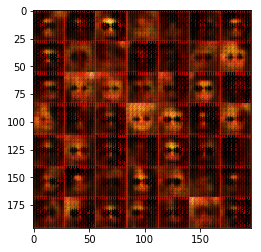

Epoch 1/2... Discriminator Loss: 0.5657... Generator Loss: 5.0992
Epoch 1/2... Discriminator Loss: 0.4729... Generator Loss: 2.6428
Epoch 1/2... Discriminator Loss: 3.1497... Generator Loss: 7.8254
Epoch 1/2... Discriminator Loss: 1.2290... Generator Loss: 0.8159
Epoch 1/2... Discriminator Loss: 3.3024... Generator Loss: 7.0439
Epoch 1/2... Discriminator Loss: 0.5105... Generator Loss: 2.4587
Epoch 1/2... Discriminator Loss: 0.9749... Generator Loss: 1.4499
Epoch 1/2... Discriminator Loss: 1.1589... Generator Loss: 1.8672
Epoch 1/2... Discriminator Loss: 1.4013... Generator Loss: 2.6907
Epoch 1/2... Discriminator Loss: 0.9645... Generator Loss: 1.5443


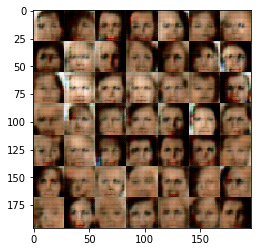

Epoch 1/2... Discriminator Loss: 2.2645... Generator Loss: 0.2131
Epoch 1/2... Discriminator Loss: 1.5189... Generator Loss: 0.5883
Epoch 1/2... Discriminator Loss: 0.8685... Generator Loss: 2.7676
Epoch 1/2... Discriminator Loss: 2.1987... Generator Loss: 2.3636
Epoch 1/2... Discriminator Loss: 1.2478... Generator Loss: 0.7183
Epoch 1/2... Discriminator Loss: 1.7994... Generator Loss: 2.9505
Epoch 1/2... Discriminator Loss: 0.9356... Generator Loss: 1.9958
Epoch 1/2... Discriminator Loss: 0.8874... Generator Loss: 2.2350
Epoch 1/2... Discriminator Loss: 2.1282... Generator Loss: 0.2354
Epoch 1/2... Discriminator Loss: 2.0226... Generator Loss: 5.0376


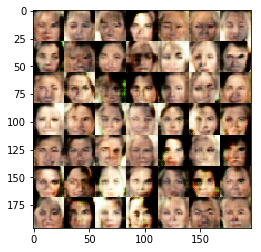

Epoch 1/2... Discriminator Loss: 1.0550... Generator Loss: 0.9221
Epoch 1/2... Discriminator Loss: 1.9240... Generator Loss: 4.7746
Epoch 1/2... Discriminator Loss: 1.4535... Generator Loss: 0.5628
Epoch 1/2... Discriminator Loss: 0.9172... Generator Loss: 1.3425
Epoch 1/2... Discriminator Loss: 1.8808... Generator Loss: 0.2909
Epoch 1/2... Discriminator Loss: 0.9699... Generator Loss: 2.1308
Epoch 1/2... Discriminator Loss: 0.6197... Generator Loss: 2.0999
Epoch 1/2... Discriminator Loss: 1.8321... Generator Loss: 2.1204
Epoch 1/2... Discriminator Loss: 1.1755... Generator Loss: 0.7162
Epoch 1/2... Discriminator Loss: 1.5854... Generator Loss: 2.9718


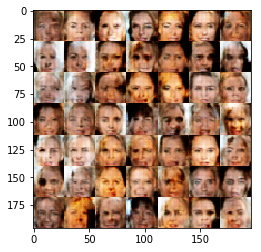

Epoch 1/2... Discriminator Loss: 0.8997... Generator Loss: 1.1445
Epoch 1/2... Discriminator Loss: 0.8864... Generator Loss: 1.3492
Epoch 1/2... Discriminator Loss: 2.2924... Generator Loss: 2.6037
Epoch 1/2... Discriminator Loss: 1.1548... Generator Loss: 2.7240
Epoch 1/2... Discriminator Loss: 1.6343... Generator Loss: 0.4016
Epoch 1/2... Discriminator Loss: 0.3949... Generator Loss: 5.2570
Epoch 1/2... Discriminator Loss: 0.9550... Generator Loss: 1.4150
Epoch 1/2... Discriminator Loss: 1.6314... Generator Loss: 3.0805
Epoch 1/2... Discriminator Loss: 0.8045... Generator Loss: 1.2900
Epoch 1/2... Discriminator Loss: 1.1450... Generator Loss: 1.0476


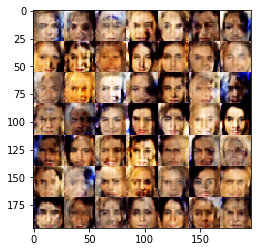

Epoch 1/2... Discriminator Loss: 0.9456... Generator Loss: 1.0445
Epoch 1/2... Discriminator Loss: 2.4197... Generator Loss: 0.2358
Epoch 1/2... Discriminator Loss: 1.7307... Generator Loss: 2.5038
Epoch 1/2... Discriminator Loss: 1.2611... Generator Loss: 0.7235
Epoch 1/2... Discriminator Loss: 1.1956... Generator Loss: 0.7296
Epoch 1/2... Discriminator Loss: 2.0248... Generator Loss: 0.2813
Epoch 1/2... Discriminator Loss: 0.6340... Generator Loss: 1.6339
Epoch 1/2... Discriminator Loss: 1.1465... Generator Loss: 0.7580
Epoch 1/2... Discriminator Loss: 0.9311... Generator Loss: 1.3543
Epoch 1/2... Discriminator Loss: 1.4116... Generator Loss: 0.5521


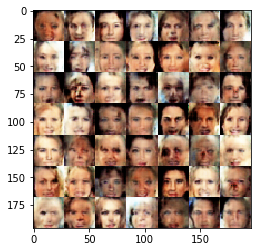

Epoch 1/2... Discriminator Loss: 0.9988... Generator Loss: 1.4786
Epoch 1/2... Discriminator Loss: 0.6863... Generator Loss: 2.9978
Epoch 1/2... Discriminator Loss: 1.4946... Generator Loss: 2.5579
Epoch 1/2... Discriminator Loss: 1.1087... Generator Loss: 0.9714
Epoch 1/2... Discriminator Loss: 1.0465... Generator Loss: 1.7577
Epoch 1/2... Discriminator Loss: 0.9373... Generator Loss: 1.2609
Epoch 1/2... Discriminator Loss: 1.7102... Generator Loss: 0.3654
Epoch 1/2... Discriminator Loss: 2.2797... Generator Loss: 0.2184
Epoch 1/2... Discriminator Loss: 1.2124... Generator Loss: 0.6323
Epoch 1/2... Discriminator Loss: 1.3800... Generator Loss: 1.8861


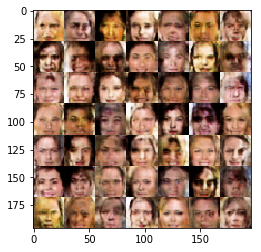

Epoch 1/2... Discriminator Loss: 1.6722... Generator Loss: 0.3522
Epoch 1/2... Discriminator Loss: 1.0763... Generator Loss: 1.4379
Epoch 1/2... Discriminator Loss: 1.1879... Generator Loss: 0.8423
Epoch 1/2... Discriminator Loss: 1.1119... Generator Loss: 0.9316
Epoch 1/2... Discriminator Loss: 1.2625... Generator Loss: 0.7330
Epoch 1/2... Discriminator Loss: 1.0488... Generator Loss: 1.7961
Epoch 1/2... Discriminator Loss: 1.2825... Generator Loss: 1.0300
Epoch 1/2... Discriminator Loss: 1.4264... Generator Loss: 2.4661
Epoch 1/2... Discriminator Loss: 1.2209... Generator Loss: 1.2461
Epoch 1/2... Discriminator Loss: 1.0981... Generator Loss: 0.9091


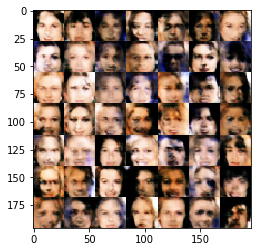

Epoch 1/2... Discriminator Loss: 0.9085... Generator Loss: 1.1896
Epoch 1/2... Discriminator Loss: 1.3132... Generator Loss: 0.6121
Epoch 1/2... Discriminator Loss: 1.9154... Generator Loss: 0.3474
Epoch 1/2... Discriminator Loss: 1.4663... Generator Loss: 0.4530
Epoch 1/2... Discriminator Loss: 1.1669... Generator Loss: 1.0323
Epoch 1/2... Discriminator Loss: 1.0625... Generator Loss: 0.9205
Epoch 1/2... Discriminator Loss: 1.4395... Generator Loss: 0.9822
Epoch 1/2... Discriminator Loss: 1.2038... Generator Loss: 1.7309
Epoch 1/2... Discriminator Loss: 1.2683... Generator Loss: 1.3028
Epoch 1/2... Discriminator Loss: 2.0692... Generator Loss: 0.2435


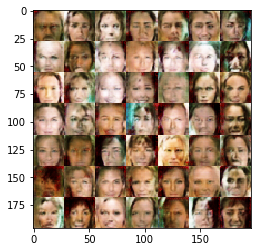

Epoch 1/2... Discriminator Loss: 1.1367... Generator Loss: 0.9574
Epoch 1/2... Discriminator Loss: 1.0445... Generator Loss: 0.8799
Epoch 1/2... Discriminator Loss: 0.9381... Generator Loss: 1.1019
Epoch 1/2... Discriminator Loss: 0.6353... Generator Loss: 1.8171
Epoch 1/2... Discriminator Loss: 0.5273... Generator Loss: 2.3997
Epoch 1/2... Discriminator Loss: 0.6616... Generator Loss: 2.7183
Epoch 1/2... Discriminator Loss: 0.7725... Generator Loss: 1.1460
Epoch 1/2... Discriminator Loss: 0.9938... Generator Loss: 2.8547
Epoch 1/2... Discriminator Loss: 1.1959... Generator Loss: 2.0147
Epoch 1/2... Discriminator Loss: 0.8513... Generator Loss: 1.9799


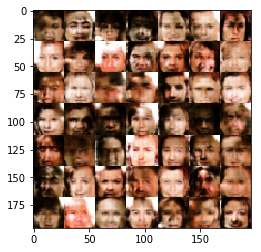

Epoch 1/2... Discriminator Loss: 1.1003... Generator Loss: 2.7158
Epoch 1/2... Discriminator Loss: 2.9567... Generator Loss: 0.1184
Epoch 1/2... Discriminator Loss: 1.1253... Generator Loss: 0.9842
Epoch 1/2... Discriminator Loss: 0.5678... Generator Loss: 2.0184
Epoch 1/2... Discriminator Loss: 1.3685... Generator Loss: 0.5047
Epoch 1/2... Discriminator Loss: 1.3101... Generator Loss: 0.7912
Epoch 1/2... Discriminator Loss: 1.0915... Generator Loss: 0.7705
Epoch 1/2... Discriminator Loss: 1.2239... Generator Loss: 0.7203
Epoch 1/2... Discriminator Loss: 1.0406... Generator Loss: 1.2490
Epoch 1/2... Discriminator Loss: 1.3026... Generator Loss: 0.6770


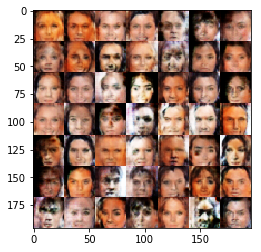

Epoch 1/2... Discriminator Loss: 1.5452... Generator Loss: 0.4518
Epoch 1/2... Discriminator Loss: 1.7281... Generator Loss: 0.4221
Epoch 1/2... Discriminator Loss: 1.1436... Generator Loss: 1.1689
Epoch 1/2... Discriminator Loss: 1.1477... Generator Loss: 1.0094
Epoch 1/2... Discriminator Loss: 1.2772... Generator Loss: 0.6865
Epoch 1/2... Discriminator Loss: 1.1951... Generator Loss: 0.7905
Epoch 1/2... Discriminator Loss: 1.9898... Generator Loss: 1.2413
Epoch 1/2... Discriminator Loss: 1.6081... Generator Loss: 0.5713
Epoch 1/2... Discriminator Loss: 1.0930... Generator Loss: 1.3540
Epoch 1/2... Discriminator Loss: 1.2012... Generator Loss: 0.7644


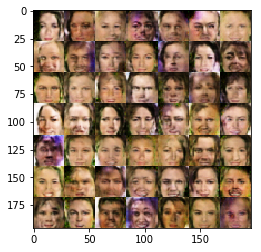

Epoch 1/2... Discriminator Loss: 1.1077... Generator Loss: 1.1562
Epoch 1/2... Discriminator Loss: 1.2226... Generator Loss: 0.7705
Epoch 1/2... Discriminator Loss: 2.1608... Generator Loss: 3.4804
Epoch 1/2... Discriminator Loss: 1.2416... Generator Loss: 0.6619
Epoch 1/2... Discriminator Loss: 1.0860... Generator Loss: 0.9366
Epoch 1/2... Discriminator Loss: 1.1133... Generator Loss: 0.7880
Epoch 1/2... Discriminator Loss: 0.9744... Generator Loss: 1.1370
Epoch 1/2... Discriminator Loss: 1.0455... Generator Loss: 0.8786
Epoch 1/2... Discriminator Loss: 1.2778... Generator Loss: 0.8023
Epoch 1/2... Discriminator Loss: 1.5575... Generator Loss: 0.3982


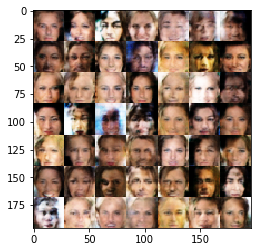

Epoch 1/2... Discriminator Loss: 1.3273... Generator Loss: 0.8686
Epoch 1/2... Discriminator Loss: 1.4245... Generator Loss: 0.4801
Epoch 1/2... Discriminator Loss: 1.1665... Generator Loss: 0.6594
Epoch 1/2... Discriminator Loss: 1.1886... Generator Loss: 0.6816
Epoch 1/2... Discriminator Loss: 1.4796... Generator Loss: 0.4982
Epoch 1/2... Discriminator Loss: 1.1246... Generator Loss: 1.2550
Epoch 1/2... Discriminator Loss: 1.0368... Generator Loss: 1.3639
Epoch 1/2... Discriminator Loss: 1.5226... Generator Loss: 0.4631
Epoch 1/2... Discriminator Loss: 1.8536... Generator Loss: 0.3183
Epoch 1/2... Discriminator Loss: 1.2597... Generator Loss: 0.6991


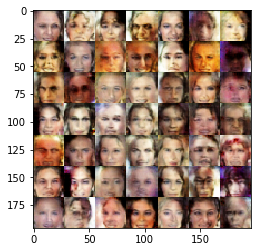

Epoch 1/2... Discriminator Loss: 1.1853... Generator Loss: 0.8448
Epoch 1/2... Discriminator Loss: 1.2550... Generator Loss: 1.1565
Epoch 1/2... Discriminator Loss: 0.7571... Generator Loss: 1.3008
Epoch 1/2... Discriminator Loss: 0.7876... Generator Loss: 1.4982
Epoch 1/2... Discriminator Loss: 1.8171... Generator Loss: 2.7350
Epoch 1/2... Discriminator Loss: 1.8575... Generator Loss: 2.5855
Epoch 1/2... Discriminator Loss: 1.1248... Generator Loss: 0.9642
Epoch 1/2... Discriminator Loss: 2.0200... Generator Loss: 0.2561
Epoch 1/2... Discriminator Loss: 0.8489... Generator Loss: 1.4420
Epoch 1/2... Discriminator Loss: 1.5345... Generator Loss: 0.4166


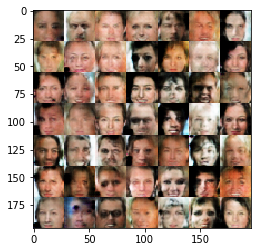

Epoch 1/2... Discriminator Loss: 1.7793... Generator Loss: 0.3269
Epoch 1/2... Discriminator Loss: 1.0381... Generator Loss: 1.2216
Epoch 1/2... Discriminator Loss: 1.7924... Generator Loss: 0.3479
Epoch 1/2... Discriminator Loss: 1.8575... Generator Loss: 0.3352
Epoch 1/2... Discriminator Loss: 1.4177... Generator Loss: 0.8190
Epoch 1/2... Discriminator Loss: 1.4392... Generator Loss: 0.5581
Epoch 1/2... Discriminator Loss: 1.2166... Generator Loss: 1.6932
Epoch 1/2... Discriminator Loss: 1.6458... Generator Loss: 2.5520
Epoch 1/2... Discriminator Loss: 1.3113... Generator Loss: 0.8089
Epoch 1/2... Discriminator Loss: 1.2680... Generator Loss: 0.5863


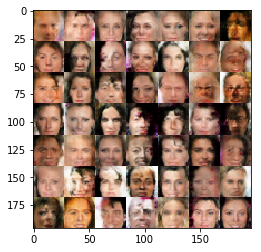

Epoch 1/2... Discriminator Loss: 1.6364... Generator Loss: 0.3826
Epoch 1/2... Discriminator Loss: 0.5430... Generator Loss: 2.2851
Epoch 1/2... Discriminator Loss: 1.4984... Generator Loss: 0.4861
Epoch 1/2... Discriminator Loss: 1.9518... Generator Loss: 2.2396
Epoch 1/2... Discriminator Loss: 1.3896... Generator Loss: 0.7415
Epoch 1/2... Discriminator Loss: 1.2898... Generator Loss: 0.6475
Epoch 1/2... Discriminator Loss: 0.9966... Generator Loss: 1.0358
Epoch 1/2... Discriminator Loss: 2.9668... Generator Loss: 0.1046
Epoch 1/2... Discriminator Loss: 1.1485... Generator Loss: 0.8427
Epoch 1/2... Discriminator Loss: 1.0822... Generator Loss: 0.9137


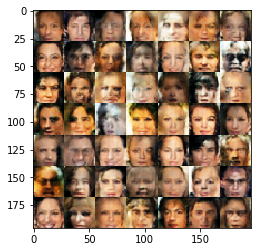

Epoch 1/2... Discriminator Loss: 1.3191... Generator Loss: 0.6151
Epoch 1/2... Discriminator Loss: 1.1022... Generator Loss: 1.0112
Epoch 1/2... Discriminator Loss: 0.9592... Generator Loss: 1.2634
Epoch 1/2... Discriminator Loss: 1.2824... Generator Loss: 0.6657
Epoch 1/2... Discriminator Loss: 1.2357... Generator Loss: 0.7219
Epoch 1/2... Discriminator Loss: 1.4903... Generator Loss: 1.2118
Epoch 1/2... Discriminator Loss: 1.9969... Generator Loss: 0.2556
Epoch 1/2... Discriminator Loss: 1.9669... Generator Loss: 0.2621
Epoch 1/2... Discriminator Loss: 1.1176... Generator Loss: 0.7887
Epoch 1/2... Discriminator Loss: 1.5100... Generator Loss: 0.4801


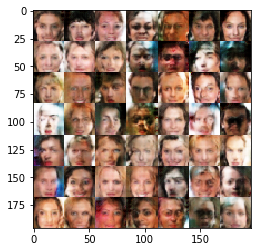

Epoch 1/2... Discriminator Loss: 0.8851... Generator Loss: 1.4391
Epoch 1/2... Discriminator Loss: 0.6522... Generator Loss: 1.9769
Epoch 1/2... Discriminator Loss: 1.1226... Generator Loss: 1.1180
Epoch 1/2... Discriminator Loss: 1.3308... Generator Loss: 1.5525
Epoch 1/2... Discriminator Loss: 1.5270... Generator Loss: 0.4459
Epoch 1/2... Discriminator Loss: 1.2066... Generator Loss: 0.7270
Epoch 1/2... Discriminator Loss: 1.0101... Generator Loss: 1.0201
Epoch 1/2... Discriminator Loss: 1.0136... Generator Loss: 1.1240
Epoch 1/2... Discriminator Loss: 2.0842... Generator Loss: 0.2110
Epoch 1/2... Discriminator Loss: 1.0730... Generator Loss: 1.1422


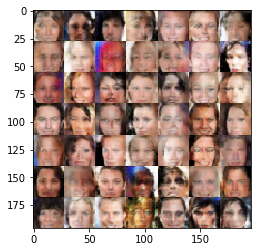

Epoch 1/2... Discriminator Loss: 1.4587... Generator Loss: 0.4602
Epoch 1/2... Discriminator Loss: 1.3462... Generator Loss: 0.6513
Epoch 1/2... Discriminator Loss: 1.8415... Generator Loss: 0.2833
Epoch 1/2... Discriminator Loss: 1.0904... Generator Loss: 0.7976
Epoch 1/2... Discriminator Loss: 1.8021... Generator Loss: 0.3586
Epoch 1/2... Discriminator Loss: 1.0054... Generator Loss: 1.2527
Epoch 1/2... Discriminator Loss: 1.0796... Generator Loss: 0.8844
Epoch 1/2... Discriminator Loss: 1.7696... Generator Loss: 0.3913
Epoch 1/2... Discriminator Loss: 1.4360... Generator Loss: 0.5873
Epoch 1/2... Discriminator Loss: 1.1372... Generator Loss: 0.9120


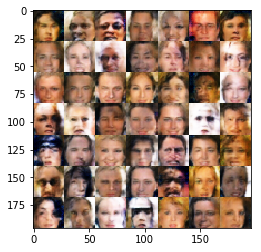

Epoch 1/2... Discriminator Loss: 1.3893... Generator Loss: 0.4990
Epoch 1/2... Discriminator Loss: 1.1960... Generator Loss: 0.7328
Epoch 1/2... Discriminator Loss: 1.1641... Generator Loss: 1.7499
Epoch 1/2... Discriminator Loss: 1.3486... Generator Loss: 0.5673
Epoch 1/2... Discriminator Loss: 1.0973... Generator Loss: 0.8699
Epoch 1/2... Discriminator Loss: 1.3900... Generator Loss: 0.6042
Epoch 1/2... Discriminator Loss: 1.1716... Generator Loss: 0.7297
Epoch 1/2... Discriminator Loss: 1.2689... Generator Loss: 0.7591
Epoch 1/2... Discriminator Loss: 2.0693... Generator Loss: 0.2314
Epoch 1/2... Discriminator Loss: 1.4848... Generator Loss: 0.4415


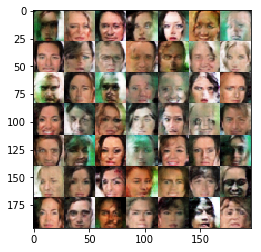

Epoch 1/2... Discriminator Loss: 1.1605... Generator Loss: 1.0665
Epoch 1/2... Discriminator Loss: 1.4539... Generator Loss: 1.2802
Epoch 1/2... Discriminator Loss: 1.2228... Generator Loss: 1.9555
Epoch 1/2... Discriminator Loss: 1.1555... Generator Loss: 0.7248
Epoch 1/2... Discriminator Loss: 1.2506... Generator Loss: 0.7547
Epoch 1/2... Discriminator Loss: 1.4024... Generator Loss: 0.5297
Epoch 1/2... Discriminator Loss: 1.1901... Generator Loss: 0.6935
Epoch 1/2... Discriminator Loss: 0.9987... Generator Loss: 1.3013
Epoch 1/2... Discriminator Loss: 1.2566... Generator Loss: 0.6985
Epoch 1/2... Discriminator Loss: 1.6528... Generator Loss: 0.3656


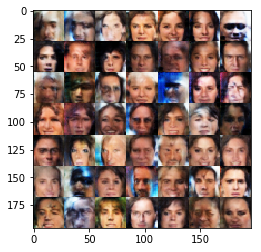

Epoch 1/2... Discriminator Loss: 1.3860... Generator Loss: 0.5184
Epoch 1/2... Discriminator Loss: 1.4794... Generator Loss: 0.5495
Epoch 1/2... Discriminator Loss: 1.2855... Generator Loss: 0.5734
Epoch 1/2... Discriminator Loss: 1.4093... Generator Loss: 1.4752
Epoch 1/2... Discriminator Loss: 1.1941... Generator Loss: 0.8632
Epoch 1/2... Discriminator Loss: 2.3512... Generator Loss: 0.2007
Epoch 1/2... Discriminator Loss: 1.1533... Generator Loss: 2.0714
Epoch 1/2... Discriminator Loss: 1.4356... Generator Loss: 0.5373
Epoch 1/2... Discriminator Loss: 1.9011... Generator Loss: 0.2699
Epoch 1/2... Discriminator Loss: 1.0437... Generator Loss: 0.9902


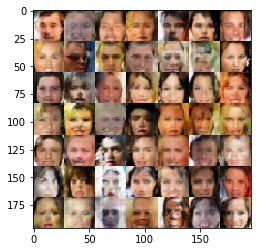

Epoch 1/2... Discriminator Loss: 1.0949... Generator Loss: 1.0271
Epoch 1/2... Discriminator Loss: 1.9995... Generator Loss: 0.2709
Epoch 1/2... Discriminator Loss: 1.4554... Generator Loss: 0.5446
Epoch 1/2... Discriminator Loss: 1.0927... Generator Loss: 1.5529
Epoch 1/2... Discriminator Loss: 1.7918... Generator Loss: 0.2930
Epoch 1/2... Discriminator Loss: 1.3496... Generator Loss: 0.5531
Epoch 1/2... Discriminator Loss: 1.3957... Generator Loss: 1.4043
Epoch 1/2... Discriminator Loss: 1.2286... Generator Loss: 0.8674
Epoch 1/2... Discriminator Loss: 1.0737... Generator Loss: 1.0552
Epoch 1/2... Discriminator Loss: 1.2549... Generator Loss: 0.7511


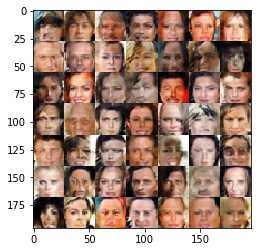

Epoch 1/2... Discriminator Loss: 1.2120... Generator Loss: 0.9078
Epoch 1/2... Discriminator Loss: 0.8467... Generator Loss: 1.2529
Epoch 1/2... Discriminator Loss: 1.3057... Generator Loss: 0.9857
Epoch 1/2... Discriminator Loss: 2.0324... Generator Loss: 0.2350
Epoch 1/2... Discriminator Loss: 1.0915... Generator Loss: 0.9372
Epoch 1/2... Discriminator Loss: 2.1824... Generator Loss: 0.2043
Epoch 1/2... Discriminator Loss: 1.3727... Generator Loss: 0.4941
Epoch 1/2... Discriminator Loss: 1.0163... Generator Loss: 1.1649
Epoch 1/2... Discriminator Loss: 1.9274... Generator Loss: 0.2690
Epoch 1/2... Discriminator Loss: 1.5319... Generator Loss: 0.4383


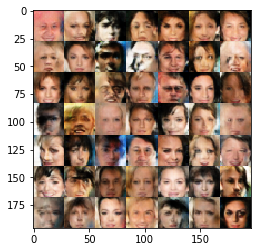

Epoch 1/2... Discriminator Loss: 1.1538... Generator Loss: 0.7375
Epoch 1/2... Discriminator Loss: 1.1880... Generator Loss: 0.9890
Epoch 1/2... Discriminator Loss: 1.2780... Generator Loss: 0.8375
Epoch 1/2... Discriminator Loss: 1.2615... Generator Loss: 0.8990
Epoch 1/2... Discriminator Loss: 1.0999... Generator Loss: 1.0787
Epoch 1/2... Discriminator Loss: 0.9659... Generator Loss: 1.0456
Epoch 1/2... Discriminator Loss: 1.1836... Generator Loss: 0.8619
Epoch 1/2... Discriminator Loss: 1.3101... Generator Loss: 0.8002
Epoch 1/2... Discriminator Loss: 1.1591... Generator Loss: 0.7041
Epoch 1/2... Discriminator Loss: 1.4783... Generator Loss: 0.4379


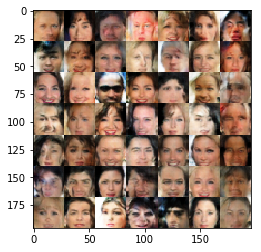

Epoch 1/2... Discriminator Loss: 1.5509... Generator Loss: 0.4215
Epoch 1/2... Discriminator Loss: 1.4377... Generator Loss: 0.4783
Epoch 1/2... Discriminator Loss: 1.2594... Generator Loss: 1.6946
Epoch 1/2... Discriminator Loss: 1.3317... Generator Loss: 1.2557
Epoch 1/2... Discriminator Loss: 1.2999... Generator Loss: 0.5936
Epoch 1/2... Discriminator Loss: 1.1518... Generator Loss: 1.2160
Epoch 1/2... Discriminator Loss: 1.3164... Generator Loss: 1.0400
Epoch 1/2... Discriminator Loss: 1.1822... Generator Loss: 0.7384
Epoch 1/2... Discriminator Loss: 1.2381... Generator Loss: 1.0143
Epoch 1/2... Discriminator Loss: 1.0526... Generator Loss: 1.1547


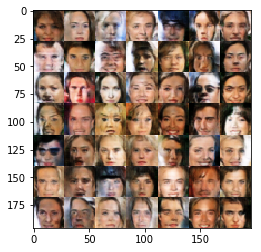

Epoch 1/2... Discriminator Loss: 1.1123... Generator Loss: 1.0978
Epoch 1/2... Discriminator Loss: 1.5254... Generator Loss: 0.4536
Epoch 1/2... Discriminator Loss: 1.5152... Generator Loss: 0.5589
Epoch 1/2... Discriminator Loss: 1.2119... Generator Loss: 1.0441
Epoch 1/2... Discriminator Loss: 1.4679... Generator Loss: 0.4616
Epoch 1/2... Discriminator Loss: 1.1844... Generator Loss: 0.6652
Epoch 1/2... Discriminator Loss: 1.2378... Generator Loss: 0.7568
Epoch 1/2... Discriminator Loss: 1.3861... Generator Loss: 0.7635
Epoch 1/2... Discriminator Loss: 1.2616... Generator Loss: 0.6204
Epoch 1/2... Discriminator Loss: 1.5283... Generator Loss: 0.4161


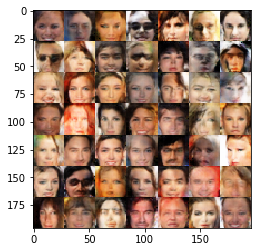

Epoch 1/2... Discriminator Loss: 1.2136... Generator Loss: 0.7445
Epoch 1/2... Discriminator Loss: 1.3378... Generator Loss: 1.3342
Epoch 1/2... Discriminator Loss: 1.8153... Generator Loss: 0.2891
Epoch 1/2... Discriminator Loss: 1.2487... Generator Loss: 0.7708
Epoch 1/2... Discriminator Loss: 1.4205... Generator Loss: 1.0125
Epoch 1/2... Discriminator Loss: 1.6236... Generator Loss: 0.4196
Epoch 1/2... Discriminator Loss: 1.1342... Generator Loss: 1.4530
Epoch 1/2... Discriminator Loss: 1.3212... Generator Loss: 0.7071
Epoch 1/2... Discriminator Loss: 1.3448... Generator Loss: 0.9600
Epoch 1/2... Discriminator Loss: 1.0092... Generator Loss: 1.2113


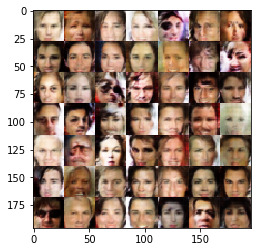

Epoch 1/2... Discriminator Loss: 1.3949... Generator Loss: 0.5955
Epoch 1/2... Discriminator Loss: 1.1131... Generator Loss: 0.8723
Epoch 1/2... Discriminator Loss: 1.3065... Generator Loss: 0.7123
Epoch 1/2... Discriminator Loss: 1.4385... Generator Loss: 0.4866
Epoch 1/2... Discriminator Loss: 1.2925... Generator Loss: 0.6643
Epoch 1/2... Discriminator Loss: 1.4500... Generator Loss: 0.5454
Epoch 1/2... Discriminator Loss: 1.0331... Generator Loss: 1.1451
Epoch 1/2... Discriminator Loss: 1.1522... Generator Loss: 1.2770
Epoch 1/2... Discriminator Loss: 1.3191... Generator Loss: 0.5731
Epoch 1/2... Discriminator Loss: 1.1317... Generator Loss: 1.3980


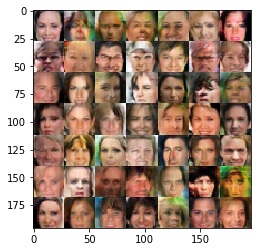

Epoch 1/2... Discriminator Loss: 1.5344... Generator Loss: 0.4723
Epoch 1/2... Discriminator Loss: 1.1998... Generator Loss: 0.6343
Epoch 1/2... Discriminator Loss: 1.5821... Generator Loss: 2.2194
Epoch 1/2... Discriminator Loss: 1.3499... Generator Loss: 0.5660
Epoch 1/2... Discriminator Loss: 1.0620... Generator Loss: 1.1112
Epoch 1/2... Discriminator Loss: 1.6271... Generator Loss: 0.3840
Epoch 1/2... Discriminator Loss: 1.5827... Generator Loss: 0.4004
Epoch 1/2... Discriminator Loss: 1.2352... Generator Loss: 0.8210
Epoch 1/2... Discriminator Loss: 1.4376... Generator Loss: 0.4962
Epoch 1/2... Discriminator Loss: 1.3689... Generator Loss: 0.5881


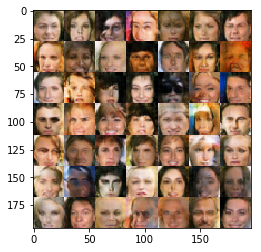

Epoch 1/2... Discriminator Loss: 1.6012... Generator Loss: 0.4245
Epoch 1/2... Discriminator Loss: 1.4309... Generator Loss: 0.4403
Epoch 1/2... Discriminator Loss: 1.7140... Generator Loss: 0.3941
Epoch 1/2... Discriminator Loss: 1.0646... Generator Loss: 1.3475
Epoch 1/2... Discriminator Loss: 1.1274... Generator Loss: 0.8567
Epoch 1/2... Discriminator Loss: 1.2575... Generator Loss: 1.2761
Epoch 1/2... Discriminator Loss: 1.3614... Generator Loss: 0.6984
Epoch 1/2... Discriminator Loss: 1.3069... Generator Loss: 1.4498
Epoch 1/2... Discriminator Loss: 1.9366... Generator Loss: 0.2647
Epoch 1/2... Discriminator Loss: 1.6047... Generator Loss: 0.4531


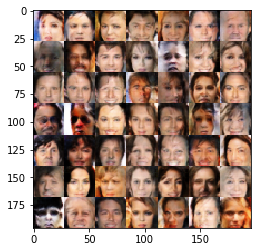

Epoch 1/2... Discriminator Loss: 1.2367... Generator Loss: 0.6773
Epoch 1/2... Discriminator Loss: 1.4078... Generator Loss: 0.5157
Epoch 1/2... Discriminator Loss: 1.2547... Generator Loss: 0.6179
Epoch 1/2... Discriminator Loss: 1.6323... Generator Loss: 0.4071
Epoch 1/2... Discriminator Loss: 1.4045... Generator Loss: 0.5167
Epoch 1/2... Discriminator Loss: 1.6208... Generator Loss: 0.4021
Epoch 1/2... Discriminator Loss: 1.1327... Generator Loss: 0.8555
Epoch 1/2... Discriminator Loss: 1.3916... Generator Loss: 1.0511
Epoch 1/2... Discriminator Loss: 1.8419... Generator Loss: 0.2969
Epoch 1/2... Discriminator Loss: 1.4611... Generator Loss: 0.5375


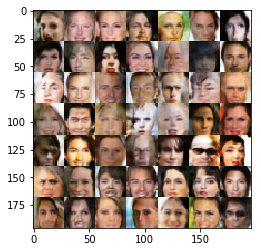

Epoch 1/2... Discriminator Loss: 1.3531... Generator Loss: 0.6935
Epoch 1/2... Discriminator Loss: 1.4119... Generator Loss: 0.6006
Epoch 1/2... Discriminator Loss: 1.3364... Generator Loss: 1.3042
Epoch 1/2... Discriminator Loss: 1.4015... Generator Loss: 0.4980
Epoch 1/2... Discriminator Loss: 1.1406... Generator Loss: 1.1123
Epoch 1/2... Discriminator Loss: 1.3081... Generator Loss: 0.8428
Epoch 1/2... Discriminator Loss: 1.8285... Generator Loss: 0.2807
Epoch 1/2... Discriminator Loss: 1.0610... Generator Loss: 0.8517
Epoch 1/2... Discriminator Loss: 1.3019... Generator Loss: 1.1485
Epoch 1/2... Discriminator Loss: 1.2053... Generator Loss: 0.8308


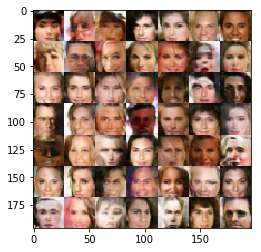

Epoch 1/2... Discriminator Loss: 1.3133... Generator Loss: 0.6590
Epoch 1/2... Discriminator Loss: 1.1664... Generator Loss: 0.7256
Epoch 1/2... Discriminator Loss: 1.5928... Generator Loss: 0.5398
Epoch 1/2... Discriminator Loss: 1.6449... Generator Loss: 0.3752
Epoch 1/2... Discriminator Loss: 1.1582... Generator Loss: 0.9906
Epoch 1/2... Discriminator Loss: 1.5114... Generator Loss: 0.4436
Epoch 1/2... Discriminator Loss: 1.3125... Generator Loss: 0.6595
Epoch 1/2... Discriminator Loss: 1.7246... Generator Loss: 0.3347
Epoch 1/2... Discriminator Loss: 1.2477... Generator Loss: 1.2630
Epoch 1/2... Discriminator Loss: 1.4965... Generator Loss: 0.4919


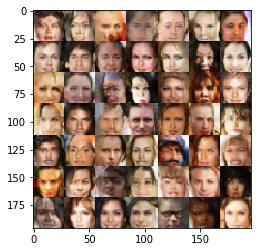

Epoch 1/2... Discriminator Loss: 1.4280... Generator Loss: 0.5113
Epoch 1/2... Discriminator Loss: 2.2450... Generator Loss: 0.1861
Epoch 1/2... Discriminator Loss: 1.5347... Generator Loss: 0.4239
Epoch 1/2... Discriminator Loss: 1.4999... Generator Loss: 0.4078
Epoch 1/2... Discriminator Loss: 1.1913... Generator Loss: 1.3181
Epoch 1/2... Discriminator Loss: 1.4173... Generator Loss: 0.5611
Epoch 1/2... Discriminator Loss: 1.1057... Generator Loss: 0.9680
Epoch 1/2... Discriminator Loss: 1.1507... Generator Loss: 0.7298
Epoch 1/2... Discriminator Loss: 1.0550... Generator Loss: 1.1750
Epoch 1/2... Discriminator Loss: 0.9903... Generator Loss: 1.3223


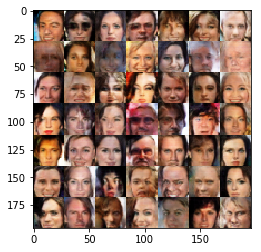

Epoch 1/2... Discriminator Loss: 1.8909... Generator Loss: 0.3856
Epoch 1/2... Discriminator Loss: 1.2852... Generator Loss: 0.6447
Epoch 1/2... Discriminator Loss: 1.0302... Generator Loss: 1.6585
Epoch 1/2... Discriminator Loss: 1.1409... Generator Loss: 1.0699
Epoch 1/2... Discriminator Loss: 1.2688... Generator Loss: 1.6701
Epoch 1/2... Discriminator Loss: 1.3345... Generator Loss: 0.6872
Epoch 1/2... Discriminator Loss: 1.4734... Generator Loss: 0.4382
Epoch 1/2... Discriminator Loss: 1.0289... Generator Loss: 1.0888
Epoch 1/2... Discriminator Loss: 1.1728... Generator Loss: 0.7450
Epoch 1/2... Discriminator Loss: 1.2509... Generator Loss: 0.6271


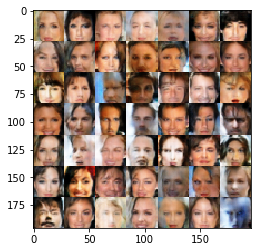

Epoch 1/2... Discriminator Loss: 1.5952... Generator Loss: 0.4586
Epoch 1/2... Discriminator Loss: 1.1306... Generator Loss: 1.1103
Epoch 1/2... Discriminator Loss: 1.3787... Generator Loss: 0.7047
Epoch 1/2... Discriminator Loss: 1.2704... Generator Loss: 0.7412
Epoch 1/2... Discriminator Loss: 1.4932... Generator Loss: 0.5452
Epoch 1/2... Discriminator Loss: 1.2080... Generator Loss: 0.8877
Epoch 1/2... Discriminator Loss: 1.3065... Generator Loss: 1.0081
Epoch 1/2... Discriminator Loss: 1.3604... Generator Loss: 0.5290
Epoch 1/2... Discriminator Loss: 1.3375... Generator Loss: 0.6116
Epoch 1/2... Discriminator Loss: 1.3587... Generator Loss: 0.5100


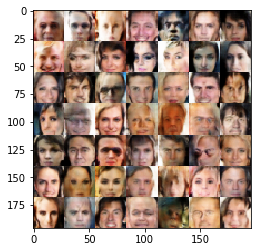

Epoch 1/2... Discriminator Loss: 1.0432... Generator Loss: 1.0585
Epoch 1/2... Discriminator Loss: 1.3981... Generator Loss: 0.5508
Epoch 1/2... Discriminator Loss: 1.4096... Generator Loss: 1.5605
Epoch 1/2... Discriminator Loss: 1.2486... Generator Loss: 1.3132
Epoch 1/2... Discriminator Loss: 1.0242... Generator Loss: 1.2427
Epoch 1/2... Discriminator Loss: 1.2103... Generator Loss: 1.0568
Epoch 1/2... Discriminator Loss: 1.4027... Generator Loss: 0.6359
Epoch 1/2... Discriminator Loss: 1.4312... Generator Loss: 0.4745
Epoch 1/2... Discriminator Loss: 1.2392... Generator Loss: 0.8027
Epoch 1/2... Discriminator Loss: 1.9284... Generator Loss: 0.2739


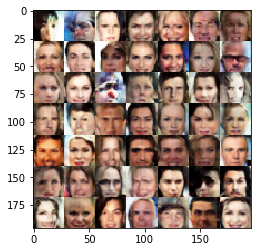

Epoch 1/2... Discriminator Loss: 1.4796... Generator Loss: 0.4876
Epoch 1/2... Discriminator Loss: 1.1603... Generator Loss: 0.9534
Epoch 1/2... Discriminator Loss: 1.1693... Generator Loss: 1.1924
Epoch 1/2... Discriminator Loss: 1.4042... Generator Loss: 0.8889
Epoch 1/2... Discriminator Loss: 1.3344... Generator Loss: 0.8275
Epoch 1/2... Discriminator Loss: 1.0126... Generator Loss: 1.4708
Epoch 1/2... Discriminator Loss: 1.2120... Generator Loss: 0.6954
Epoch 1/2... Discriminator Loss: 1.0863... Generator Loss: 0.9030
Epoch 1/2... Discriminator Loss: 1.3737... Generator Loss: 0.8205
Epoch 1/2... Discriminator Loss: 1.2656... Generator Loss: 0.6102


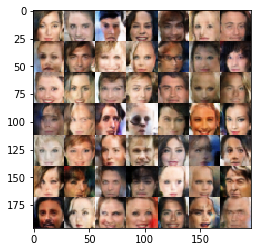

Epoch 1/2... Discriminator Loss: 1.0874... Generator Loss: 0.9550
Epoch 1/2... Discriminator Loss: 1.5654... Generator Loss: 0.3918
Epoch 1/2... Discriminator Loss: 1.7750... Generator Loss: 0.3067
Epoch 1/2... Discriminator Loss: 1.1532... Generator Loss: 0.8812
Epoch 1/2... Discriminator Loss: 1.4829... Generator Loss: 0.4229
Epoch 1/2... Discriminator Loss: 1.3903... Generator Loss: 0.5066
Epoch 1/2... Discriminator Loss: 1.5605... Generator Loss: 0.4800
Epoch 1/2... Discriminator Loss: 1.1938... Generator Loss: 0.7334
Epoch 1/2... Discriminator Loss: 1.2369... Generator Loss: 1.1183
Epoch 1/2... Discriminator Loss: 1.3904... Generator Loss: 0.5808


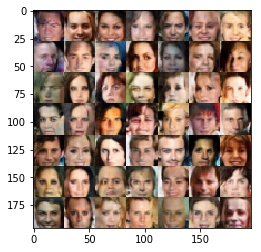

Epoch 1/2... Discriminator Loss: 1.0472... Generator Loss: 1.2862
Epoch 1/2... Discriminator Loss: 1.5017... Generator Loss: 0.4285
Epoch 1/2... Discriminator Loss: 1.5603... Generator Loss: 0.4440
Epoch 1/2... Discriminator Loss: 1.4954... Generator Loss: 0.5007
Epoch 1/2... Discriminator Loss: 1.5161... Generator Loss: 0.4467
Epoch 1/2... Discriminator Loss: 1.2541... Generator Loss: 0.7008
Epoch 1/2... Discriminator Loss: 1.3052... Generator Loss: 0.6901
Epoch 1/2... Discriminator Loss: 1.4103... Generator Loss: 0.5355
Epoch 1/2... Discriminator Loss: 1.5804... Generator Loss: 1.9612
Epoch 1/2... Discriminator Loss: 1.5771... Generator Loss: 0.3959


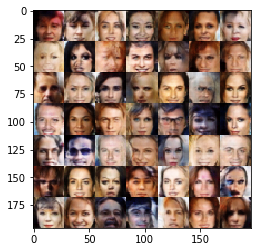

Epoch 1/2... Discriminator Loss: 1.0333... Generator Loss: 0.9667
Epoch 1/2... Discriminator Loss: 1.3786... Generator Loss: 0.5029
Epoch 1/2... Discriminator Loss: 1.2818... Generator Loss: 1.1422
Epoch 1/2... Discriminator Loss: 1.8303... Generator Loss: 0.2897
Epoch 1/2... Discriminator Loss: 1.1948... Generator Loss: 0.7358
Epoch 1/2... Discriminator Loss: 1.1173... Generator Loss: 1.3415
Epoch 1/2... Discriminator Loss: 1.3277... Generator Loss: 0.8875
Epoch 1/2... Discriminator Loss: 1.3739... Generator Loss: 0.5928
Epoch 1/2... Discriminator Loss: 1.3466... Generator Loss: 0.5879
Epoch 1/2... Discriminator Loss: 1.6536... Generator Loss: 0.3617


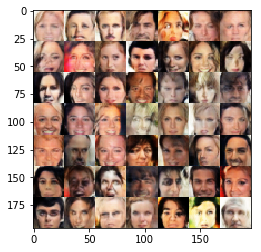

Epoch 1/2... Discriminator Loss: 1.0070... Generator Loss: 0.8311
Epoch 1/2... Discriminator Loss: 1.3270... Generator Loss: 0.7858
Epoch 1/2... Discriminator Loss: 1.3986... Generator Loss: 0.7243
Epoch 1/2... Discriminator Loss: 1.4060... Generator Loss: 0.5073
Epoch 1/2... Discriminator Loss: 1.1554... Generator Loss: 0.7513
Epoch 1/2... Discriminator Loss: 1.9288... Generator Loss: 0.2468
Epoch 1/2... Discriminator Loss: 1.3486... Generator Loss: 0.7718
Epoch 1/2... Discriminator Loss: 1.3925... Generator Loss: 0.4938
Epoch 1/2... Discriminator Loss: 1.5654... Generator Loss: 0.3991
Epoch 1/2... Discriminator Loss: 1.3172... Generator Loss: 0.6445


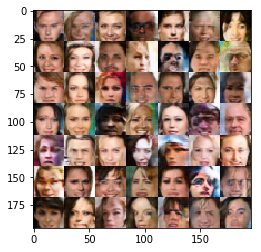

Epoch 1/2... Discriminator Loss: 1.0392... Generator Loss: 1.2620
Epoch 1/2... Discriminator Loss: 1.8126... Generator Loss: 1.8861
Epoch 1/2... Discriminator Loss: 1.4783... Generator Loss: 0.4504
Epoch 1/2... Discriminator Loss: 0.9957... Generator Loss: 1.0854
Epoch 1/2... Discriminator Loss: 1.4522... Generator Loss: 0.9977
Epoch 1/2... Discriminator Loss: 1.4194... Generator Loss: 0.5593
Epoch 1/2... Discriminator Loss: 1.2547... Generator Loss: 0.6032
Epoch 1/2... Discriminator Loss: 1.2289... Generator Loss: 0.7583
Epoch 1/2... Discriminator Loss: 1.5586... Generator Loss: 0.3731
Epoch 1/2... Discriminator Loss: 1.1335... Generator Loss: 0.8485


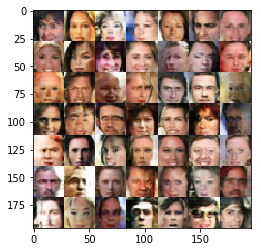

Epoch 1/2... Discriminator Loss: 1.0219... Generator Loss: 1.0562
Epoch 1/2... Discriminator Loss: 1.1762... Generator Loss: 0.6709
Epoch 1/2... Discriminator Loss: 1.2311... Generator Loss: 0.7452
Epoch 1/2... Discriminator Loss: 1.2376... Generator Loss: 0.8331
Epoch 1/2... Discriminator Loss: 1.3629... Generator Loss: 1.6452
Epoch 1/2... Discriminator Loss: 1.9260... Generator Loss: 0.2741
Epoch 1/2... Discriminator Loss: 1.1236... Generator Loss: 0.9474
Epoch 1/2... Discriminator Loss: 1.2637... Generator Loss: 0.8681
Epoch 1/2... Discriminator Loss: 1.4820... Generator Loss: 0.5347
Epoch 1/2... Discriminator Loss: 1.3936... Generator Loss: 0.5439


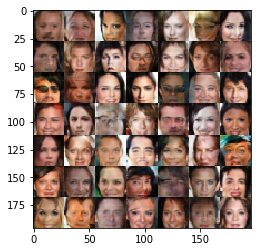

Epoch 1/2... Discriminator Loss: 1.5316... Generator Loss: 2.1659
Epoch 1/2... Discriminator Loss: 1.1863... Generator Loss: 1.1092
Epoch 1/2... Discriminator Loss: 1.9914... Generator Loss: 0.2835
Epoch 1/2... Discriminator Loss: 1.3916... Generator Loss: 0.6291
Epoch 1/2... Discriminator Loss: 1.4972... Generator Loss: 0.4538
Epoch 1/2... Discriminator Loss: 1.3597... Generator Loss: 0.6863
Epoch 1/2... Discriminator Loss: 1.1585... Generator Loss: 0.9223
Epoch 1/2... Discriminator Loss: 1.6322... Generator Loss: 0.3690
Epoch 1/2... Discriminator Loss: 2.2932... Generator Loss: 0.1821
Epoch 1/2... Discriminator Loss: 1.6165... Generator Loss: 0.4165


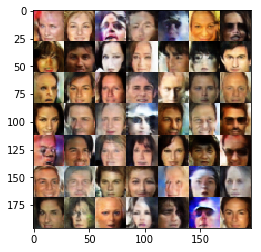

Epoch 1/2... Discriminator Loss: 1.1333... Generator Loss: 0.7951
Epoch 1/2... Discriminator Loss: 1.2403... Generator Loss: 1.4516
Epoch 1/2... Discriminator Loss: 1.2872... Generator Loss: 0.6096
Epoch 1/2... Discriminator Loss: 1.5741... Generator Loss: 0.3808
Epoch 1/2... Discriminator Loss: 1.1620... Generator Loss: 0.7184
Epoch 1/2... Discriminator Loss: 1.3515... Generator Loss: 0.5461
Epoch 1/2... Discriminator Loss: 1.1083... Generator Loss: 0.9418
Epoch 1/2... Discriminator Loss: 1.0743... Generator Loss: 0.9117
Epoch 1/2... Discriminator Loss: 1.5656... Generator Loss: 0.4054
Epoch 1/2... Discriminator Loss: 1.4641... Generator Loss: 0.4587


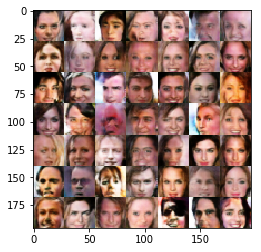

Epoch 1/2... Discriminator Loss: 1.3592... Generator Loss: 0.6102
Epoch 1/2... Discriminator Loss: 1.2340... Generator Loss: 0.6476
Epoch 1/2... Discriminator Loss: 1.4138... Generator Loss: 0.4975
Epoch 1/2... Discriminator Loss: 1.3095... Generator Loss: 0.7251
Epoch 1/2... Discriminator Loss: 1.5616... Generator Loss: 0.4524
Epoch 1/2... Discriminator Loss: 1.5387... Generator Loss: 0.4543
Epoch 1/2... Discriminator Loss: 1.5689... Generator Loss: 0.4546
Epoch 1/2... Discriminator Loss: 1.0991... Generator Loss: 0.8547
Epoch 1/2... Discriminator Loss: 1.1334... Generator Loss: 0.7885
Epoch 1/2... Discriminator Loss: 1.5028... Generator Loss: 0.4127


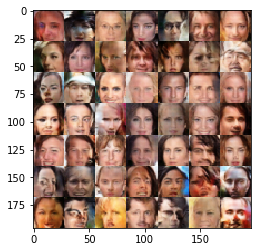

Epoch 1/2... Discriminator Loss: 1.6221... Generator Loss: 0.3813
Epoch 1/2... Discriminator Loss: 1.3200... Generator Loss: 1.1798
Epoch 1/2... Discriminator Loss: 1.4053... Generator Loss: 0.5547
Epoch 1/2... Discriminator Loss: 1.1251... Generator Loss: 1.0814
Epoch 1/2... Discriminator Loss: 1.1172... Generator Loss: 0.8960
Epoch 1/2... Discriminator Loss: 1.2064... Generator Loss: 0.7444
Epoch 1/2... Discriminator Loss: 1.3521... Generator Loss: 0.6087
Epoch 1/2... Discriminator Loss: 1.4454... Generator Loss: 0.7081
Epoch 1/2... Discriminator Loss: 1.4128... Generator Loss: 0.5517
Epoch 1/2... Discriminator Loss: 1.4597... Generator Loss: 1.7064


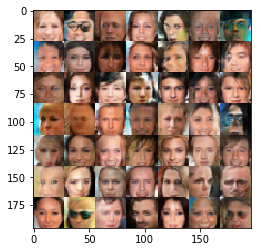

Epoch 1/2... Discriminator Loss: 1.5737... Generator Loss: 0.4063
Epoch 1/2... Discriminator Loss: 1.6755... Generator Loss: 0.3486
Epoch 1/2... Discriminator Loss: 1.6564... Generator Loss: 0.3681
Epoch 1/2... Discriminator Loss: 1.3784... Generator Loss: 0.6219
Epoch 1/2... Discriminator Loss: 1.3346... Generator Loss: 0.6597
Epoch 1/2... Discriminator Loss: 1.2072... Generator Loss: 0.8691
Epoch 1/2... Discriminator Loss: 1.2111... Generator Loss: 0.7824
Epoch 1/2... Discriminator Loss: 1.2382... Generator Loss: 0.6767
Epoch 1/2... Discriminator Loss: 1.9246... Generator Loss: 0.2763
Epoch 1/2... Discriminator Loss: 1.5896... Generator Loss: 0.4287


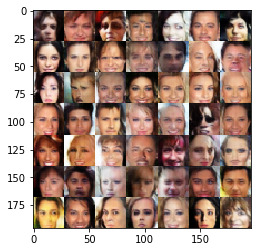

Epoch 1/2... Discriminator Loss: 1.4216... Generator Loss: 0.4754
Epoch 1/2... Discriminator Loss: 1.9149... Generator Loss: 0.2775
Epoch 1/2... Discriminator Loss: 1.4453... Generator Loss: 1.3157
Epoch 1/2... Discriminator Loss: 1.5480... Generator Loss: 0.4346
Epoch 1/2... Discriminator Loss: 1.4268... Generator Loss: 0.5132
Epoch 1/2... Discriminator Loss: 1.2294... Generator Loss: 0.8570
Epoch 1/2... Discriminator Loss: 1.4271... Generator Loss: 0.5264
Epoch 1/2... Discriminator Loss: 1.4466... Generator Loss: 0.4485
Epoch 1/2... Discriminator Loss: 1.2828... Generator Loss: 0.8008
Epoch 1/2... Discriminator Loss: 1.1742... Generator Loss: 0.7959


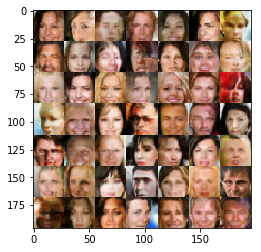

Epoch 1/2... Discriminator Loss: 1.3249... Generator Loss: 1.0994
Epoch 1/2... Discriminator Loss: 1.2732... Generator Loss: 0.6735
Epoch 1/2... Discriminator Loss: 2.6395... Generator Loss: 0.1332
Epoch 1/2... Discriminator Loss: 1.2831... Generator Loss: 0.7588
Epoch 1/2... Discriminator Loss: 1.3294... Generator Loss: 0.6847
Epoch 1/2... Discriminator Loss: 1.1820... Generator Loss: 0.7017
Epoch 1/2... Discriminator Loss: 1.3024... Generator Loss: 0.9961
Epoch 1/2... Discriminator Loss: 1.3759... Generator Loss: 0.5616
Epoch 1/2... Discriminator Loss: 1.3738... Generator Loss: 0.8278
Epoch 1/2... Discriminator Loss: 1.3781... Generator Loss: 1.3582


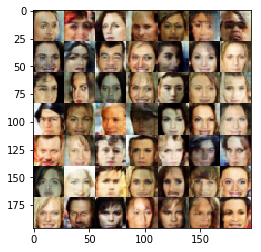

Epoch 1/2... Discriminator Loss: 1.3551... Generator Loss: 0.5353
Epoch 1/2... Discriminator Loss: 1.2422... Generator Loss: 0.6686
Epoch 1/2... Discriminator Loss: 1.4746... Generator Loss: 0.4867
Epoch 1/2... Discriminator Loss: 1.4500... Generator Loss: 0.4771
Epoch 1/2... Discriminator Loss: 1.2049... Generator Loss: 0.7789
Epoch 1/2... Discriminator Loss: 1.3227... Generator Loss: 0.8484
Epoch 1/2... Discriminator Loss: 1.3819... Generator Loss: 0.5458
Epoch 1/2... Discriminator Loss: 1.2641... Generator Loss: 1.0936
Epoch 1/2... Discriminator Loss: 1.1881... Generator Loss: 1.6467
Epoch 1/2... Discriminator Loss: 1.2739... Generator Loss: 0.5678


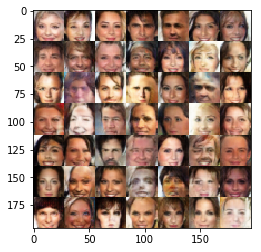

Epoch 1/2... Discriminator Loss: 1.3033... Generator Loss: 0.5531
Epoch 1/2... Discriminator Loss: 1.1998... Generator Loss: 1.2478
Epoch 1/2... Discriminator Loss: 1.1868... Generator Loss: 1.1817
Epoch 1/2... Discriminator Loss: 1.8764... Generator Loss: 0.2932
Epoch 1/2... Discriminator Loss: 1.2986... Generator Loss: 0.6425
Epoch 1/2... Discriminator Loss: 1.2465... Generator Loss: 0.6552
Epoch 1/2... Discriminator Loss: 1.3169... Generator Loss: 0.5685
Epoch 1/2... Discriminator Loss: 2.1262... Generator Loss: 0.2177
Epoch 1/2... Discriminator Loss: 1.3009... Generator Loss: 0.5648
Epoch 1/2... Discriminator Loss: 1.3112... Generator Loss: 0.7038


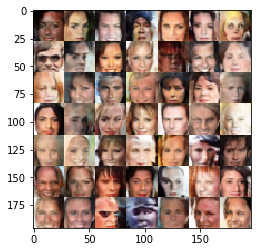

Epoch 1/2... Discriminator Loss: 1.1651... Generator Loss: 0.7765
Epoch 1/2... Discriminator Loss: 1.1776... Generator Loss: 0.7340
Epoch 1/2... Discriminator Loss: 1.2370... Generator Loss: 0.9736
Epoch 1/2... Discriminator Loss: 1.9082... Generator Loss: 0.2790
Epoch 1/2... Discriminator Loss: 1.3578... Generator Loss: 0.6088
Epoch 1/2... Discriminator Loss: 1.3559... Generator Loss: 0.5051
Epoch 1/2... Discriminator Loss: 1.0367... Generator Loss: 0.9343
Epoch 1/2... Discriminator Loss: 1.6386... Generator Loss: 1.4696
Epoch 1/2... Discriminator Loss: 1.8041... Generator Loss: 0.2885
Epoch 1/2... Discriminator Loss: 1.2510... Generator Loss: 0.9510


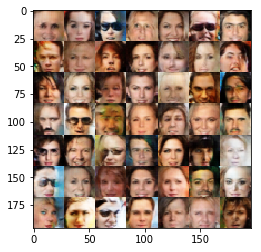

Epoch 1/2... Discriminator Loss: 1.6742... Generator Loss: 0.3409
Epoch 1/2... Discriminator Loss: 1.8416... Generator Loss: 0.2777
Epoch 1/2... Discriminator Loss: 1.3918... Generator Loss: 1.2449
Epoch 1/2... Discriminator Loss: 1.3768... Generator Loss: 0.5102
Epoch 1/2... Discriminator Loss: 1.2944... Generator Loss: 0.5505
Epoch 1/2... Discriminator Loss: 1.3411... Generator Loss: 0.5521
Epoch 1/2... Discriminator Loss: 1.3971... Generator Loss: 2.3711
Epoch 1/2... Discriminator Loss: 1.2278... Generator Loss: 0.9931
Epoch 1/2... Discriminator Loss: 1.6941... Generator Loss: 0.3382
Epoch 1/2... Discriminator Loss: 1.1775... Generator Loss: 0.7515


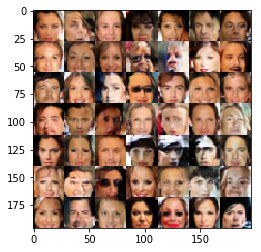

Epoch 1/2... Discriminator Loss: 1.2667... Generator Loss: 0.8102
Epoch 1/2... Discriminator Loss: 1.3142... Generator Loss: 0.6030
Epoch 1/2... Discriminator Loss: 1.8343... Generator Loss: 0.2939
Epoch 1/2... Discriminator Loss: 1.5764... Generator Loss: 0.3796
Epoch 1/2... Discriminator Loss: 1.8893... Generator Loss: 0.2733
Epoch 1/2... Discriminator Loss: 1.2360... Generator Loss: 0.6764
Epoch 1/2... Discriminator Loss: 1.5148... Generator Loss: 0.4129
Epoch 1/2... Discriminator Loss: 1.2575... Generator Loss: 0.7450
Epoch 1/2... Discriminator Loss: 1.2835... Generator Loss: 0.5787
Epoch 1/2... Discriminator Loss: 1.2535... Generator Loss: 1.1490


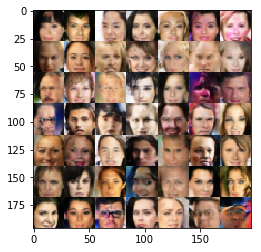

Epoch 1/2... Discriminator Loss: 1.2558... Generator Loss: 0.6168
Epoch 1/2... Discriminator Loss: 1.5286... Generator Loss: 0.5238
Epoch 1/2... Discriminator Loss: 1.2879... Generator Loss: 0.6404
Epoch 1/2... Discriminator Loss: 1.3195... Generator Loss: 0.5866
Epoch 1/2... Discriminator Loss: 1.2444... Generator Loss: 0.8764
Epoch 1/2... Discriminator Loss: 1.2997... Generator Loss: 1.6452
Epoch 1/2... Discriminator Loss: 1.4279... Generator Loss: 0.5086
Epoch 1/2... Discriminator Loss: 1.1404... Generator Loss: 1.1427
Epoch 1/2... Discriminator Loss: 1.6073... Generator Loss: 0.4018
Epoch 1/2... Discriminator Loss: 1.3890... Generator Loss: 0.6744


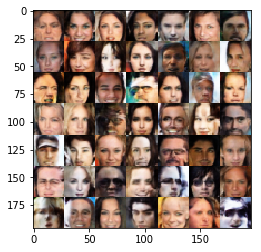

Epoch 1/2... Discriminator Loss: 1.3281... Generator Loss: 0.7574
Epoch 1/2... Discriminator Loss: 1.2943... Generator Loss: 0.6554
Epoch 1/2... Discriminator Loss: 1.4577... Generator Loss: 0.5443
Epoch 1/2... Discriminator Loss: 1.1864... Generator Loss: 1.3588
Epoch 1/2... Discriminator Loss: 1.7069... Generator Loss: 0.3354
Epoch 1/2... Discriminator Loss: 1.2638... Generator Loss: 0.7169
Epoch 1/2... Discriminator Loss: 1.4404... Generator Loss: 0.5226
Epoch 1/2... Discriminator Loss: 1.4524... Generator Loss: 0.4996
Epoch 1/2... Discriminator Loss: 1.1723... Generator Loss: 1.3677
Epoch 1/2... Discriminator Loss: 1.4145... Generator Loss: 0.4826


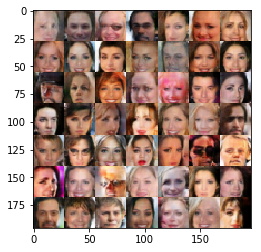

Epoch 1/2... Discriminator Loss: 1.2203... Generator Loss: 1.0073
Epoch 1/2... Discriminator Loss: 1.0376... Generator Loss: 1.3515
Epoch 1/2... Discriminator Loss: 1.8808... Generator Loss: 0.2774
Epoch 1/2... Discriminator Loss: 1.3848... Generator Loss: 0.4840
Epoch 1/2... Discriminator Loss: 1.3529... Generator Loss: 1.1243
Epoch 1/2... Discriminator Loss: 1.6643... Generator Loss: 0.3825
Epoch 1/2... Discriminator Loss: 1.7225... Generator Loss: 0.3282
Epoch 1/2... Discriminator Loss: 1.4605... Generator Loss: 0.6685
Epoch 1/2... Discriminator Loss: 1.3802... Generator Loss: 0.6886
Epoch 1/2... Discriminator Loss: 1.4342... Generator Loss: 0.5044


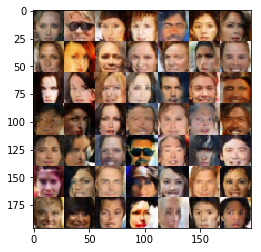

Epoch 1/2... Discriminator Loss: 1.2463... Generator Loss: 0.8605
Epoch 1/2... Discriminator Loss: 1.6905... Generator Loss: 0.7434
Epoch 1/2... Discriminator Loss: 1.2285... Generator Loss: 0.7348
Epoch 1/2... Discriminator Loss: 1.6257... Generator Loss: 0.3575
Epoch 1/2... Discriminator Loss: 1.6759... Generator Loss: 0.3565
Epoch 1/2... Discriminator Loss: 1.5012... Generator Loss: 0.4705
Epoch 1/2... Discriminator Loss: 1.3027... Generator Loss: 0.6429
Epoch 1/2... Discriminator Loss: 1.1605... Generator Loss: 0.8085
Epoch 1/2... Discriminator Loss: 1.3303... Generator Loss: 0.5947
Epoch 1/2... Discriminator Loss: 1.5358... Generator Loss: 1.0637


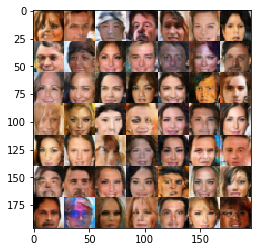

Epoch 1/2... Discriminator Loss: 1.8072... Generator Loss: 0.2971
Epoch 1/2... Discriminator Loss: 1.4887... Generator Loss: 0.5079
Epoch 1/2... Discriminator Loss: 2.1587... Generator Loss: 0.2049
Epoch 1/2... Discriminator Loss: 0.9829... Generator Loss: 1.8305
Epoch 1/2... Discriminator Loss: 1.3377... Generator Loss: 0.5949
Epoch 1/2... Discriminator Loss: 1.5684... Generator Loss: 0.3855
Epoch 1/2... Discriminator Loss: 1.3400... Generator Loss: 0.5807
Epoch 1/2... Discriminator Loss: 1.2443... Generator Loss: 0.6775
Epoch 1/2... Discriminator Loss: 1.3069... Generator Loss: 0.5418
Epoch 1/2... Discriminator Loss: 1.5712... Generator Loss: 0.3796


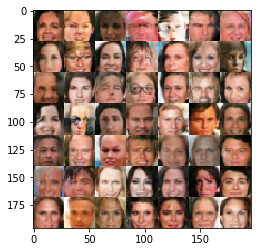

Epoch 1/2... Discriminator Loss: 1.0533... Generator Loss: 1.1787
Epoch 1/2... Discriminator Loss: 1.4483... Generator Loss: 0.7214
Epoch 1/2... Discriminator Loss: 1.6398... Generator Loss: 0.3833
Epoch 2/2... Discriminator Loss: 1.6498... Generator Loss: 0.3543
Epoch 2/2... Discriminator Loss: 1.4521... Generator Loss: 0.4740
Epoch 2/2... Discriminator Loss: 1.4445... Generator Loss: 0.5225
Epoch 2/2... Discriminator Loss: 1.0223... Generator Loss: 1.1403
Epoch 2/2... Discriminator Loss: 1.3769... Generator Loss: 0.5511
Epoch 2/2... Discriminator Loss: 1.3559... Generator Loss: 0.6259
Epoch 2/2... Discriminator Loss: 1.6018... Generator Loss: 0.3880


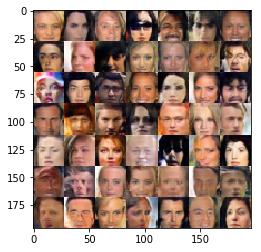

Epoch 2/2... Discriminator Loss: 1.2903... Generator Loss: 0.6301
Epoch 2/2... Discriminator Loss: 1.7388... Generator Loss: 0.3146
Epoch 2/2... Discriminator Loss: 1.2753... Generator Loss: 0.6238
Epoch 2/2... Discriminator Loss: 1.6559... Generator Loss: 0.3914
Epoch 2/2... Discriminator Loss: 1.5796... Generator Loss: 0.4495
Epoch 2/2... Discriminator Loss: 1.5590... Generator Loss: 0.4017
Epoch 2/2... Discriminator Loss: 1.5474... Generator Loss: 0.4172
Epoch 2/2... Discriminator Loss: 1.1532... Generator Loss: 0.9170
Epoch 2/2... Discriminator Loss: 1.5972... Generator Loss: 0.4060
Epoch 2/2... Discriminator Loss: 1.2935... Generator Loss: 0.5966


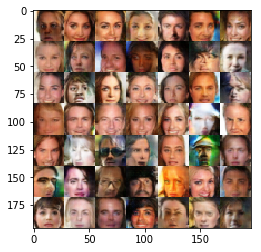

Epoch 2/2... Discriminator Loss: 1.4195... Generator Loss: 0.5361
Epoch 2/2... Discriminator Loss: 1.1897... Generator Loss: 0.8888
Epoch 2/2... Discriminator Loss: 0.9414... Generator Loss: 1.3349
Epoch 2/2... Discriminator Loss: 1.2079... Generator Loss: 0.7622
Epoch 2/2... Discriminator Loss: 1.1215... Generator Loss: 0.9002
Epoch 2/2... Discriminator Loss: 1.0471... Generator Loss: 1.0813
Epoch 2/2... Discriminator Loss: 1.5009... Generator Loss: 0.4925
Epoch 2/2... Discriminator Loss: 1.5927... Generator Loss: 0.3773
Epoch 2/2... Discriminator Loss: 1.2812... Generator Loss: 0.6050
Epoch 2/2... Discriminator Loss: 1.7235... Generator Loss: 0.4857


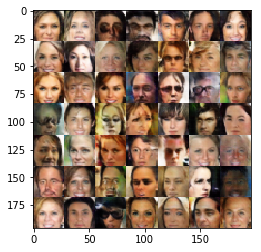

Epoch 2/2... Discriminator Loss: 1.9305... Generator Loss: 0.2580
Epoch 2/2... Discriminator Loss: 1.4216... Generator Loss: 0.5699
Epoch 2/2... Discriminator Loss: 1.3865... Generator Loss: 0.5365
Epoch 2/2... Discriminator Loss: 1.9011... Generator Loss: 2.0281
Epoch 2/2... Discriminator Loss: 1.4781... Generator Loss: 0.4794
Epoch 2/2... Discriminator Loss: 1.4457... Generator Loss: 0.4688
Epoch 2/2... Discriminator Loss: 1.5096... Generator Loss: 0.4554
Epoch 2/2... Discriminator Loss: 1.4347... Generator Loss: 0.5353
Epoch 2/2... Discriminator Loss: 1.3440... Generator Loss: 0.5581
Epoch 2/2... Discriminator Loss: 0.9688... Generator Loss: 1.0085


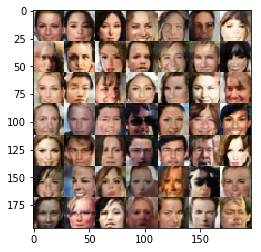

Epoch 2/2... Discriminator Loss: 0.9297... Generator Loss: 1.3172
Epoch 2/2... Discriminator Loss: 0.9475... Generator Loss: 1.1485
Epoch 2/2... Discriminator Loss: 1.7861... Generator Loss: 0.3031
Epoch 2/2... Discriminator Loss: 1.0791... Generator Loss: 1.0108
Epoch 2/2... Discriminator Loss: 1.1219... Generator Loss: 1.1879
Epoch 2/2... Discriminator Loss: 1.0170... Generator Loss: 0.8933
Epoch 2/2... Discriminator Loss: 1.3001... Generator Loss: 0.6849
Epoch 2/2... Discriminator Loss: 1.3274... Generator Loss: 0.7044
Epoch 2/2... Discriminator Loss: 1.1647... Generator Loss: 0.8953
Epoch 2/2... Discriminator Loss: 1.7221... Generator Loss: 0.3513


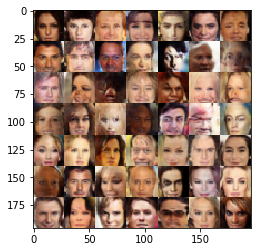

Epoch 2/2... Discriminator Loss: 1.2407... Generator Loss: 0.6770
Epoch 2/2... Discriminator Loss: 1.1476... Generator Loss: 0.7301
Epoch 2/2... Discriminator Loss: 1.4741... Generator Loss: 0.7889
Epoch 2/2... Discriminator Loss: 1.1231... Generator Loss: 0.8279
Epoch 2/2... Discriminator Loss: 1.2872... Generator Loss: 0.6214
Epoch 2/2... Discriminator Loss: 1.7758... Generator Loss: 0.3168
Epoch 2/2... Discriminator Loss: 1.3675... Generator Loss: 1.2640
Epoch 2/2... Discriminator Loss: 1.3920... Generator Loss: 0.5591
Epoch 2/2... Discriminator Loss: 1.9389... Generator Loss: 0.2791
Epoch 2/2... Discriminator Loss: 1.9788... Generator Loss: 0.2723


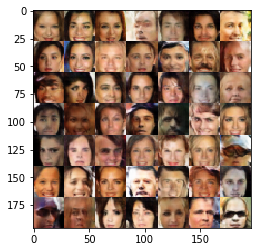

Epoch 2/2... Discriminator Loss: 1.3813... Generator Loss: 0.6139
Epoch 2/2... Discriminator Loss: 1.5747... Generator Loss: 0.3978
Epoch 2/2... Discriminator Loss: 1.2770... Generator Loss: 0.6138
Epoch 2/2... Discriminator Loss: 1.1729... Generator Loss: 1.2202
Epoch 2/2... Discriminator Loss: 1.3544... Generator Loss: 0.5561
Epoch 2/2... Discriminator Loss: 1.5987... Generator Loss: 0.3726
Epoch 2/2... Discriminator Loss: 1.1866... Generator Loss: 0.8655
Epoch 2/2... Discriminator Loss: 1.9564... Generator Loss: 0.2506
Epoch 2/2... Discriminator Loss: 1.2148... Generator Loss: 1.6195
Epoch 2/2... Discriminator Loss: 1.1073... Generator Loss: 1.0888


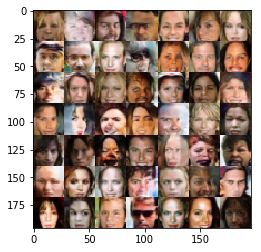

Epoch 2/2... Discriminator Loss: 1.4165... Generator Loss: 0.4738
Epoch 2/2... Discriminator Loss: 1.5168... Generator Loss: 0.4569
Epoch 2/2... Discriminator Loss: 1.9580... Generator Loss: 0.2552
Epoch 2/2... Discriminator Loss: 1.4231... Generator Loss: 0.6955
Epoch 2/2... Discriminator Loss: 1.0425... Generator Loss: 1.1810
Epoch 2/2... Discriminator Loss: 1.4410... Generator Loss: 0.4636
Epoch 2/2... Discriminator Loss: 1.2270... Generator Loss: 0.8124
Epoch 2/2... Discriminator Loss: 1.4279... Generator Loss: 0.6297
Epoch 2/2... Discriminator Loss: 1.2723... Generator Loss: 0.8138
Epoch 2/2... Discriminator Loss: 1.3638... Generator Loss: 0.4851


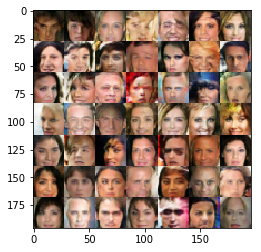

Epoch 2/2... Discriminator Loss: 1.8754... Generator Loss: 0.2756
Epoch 2/2... Discriminator Loss: 1.1350... Generator Loss: 1.2718
Epoch 2/2... Discriminator Loss: 1.7385... Generator Loss: 0.3207
Epoch 2/2... Discriminator Loss: 1.3101... Generator Loss: 0.5641
Epoch 2/2... Discriminator Loss: 1.4386... Generator Loss: 0.5592
Epoch 2/2... Discriminator Loss: 1.0435... Generator Loss: 0.9171
Epoch 2/2... Discriminator Loss: 1.1427... Generator Loss: 1.0151
Epoch 2/2... Discriminator Loss: 1.2507... Generator Loss: 0.9677
Epoch 2/2... Discriminator Loss: 1.4378... Generator Loss: 0.4821
Epoch 2/2... Discriminator Loss: 1.3529... Generator Loss: 0.5636


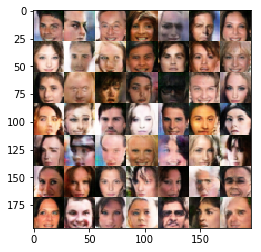

Epoch 2/2... Discriminator Loss: 1.5746... Generator Loss: 0.4034
Epoch 2/2... Discriminator Loss: 1.3025... Generator Loss: 0.6206
Epoch 2/2... Discriminator Loss: 1.1438... Generator Loss: 0.7688
Epoch 2/2... Discriminator Loss: 1.1035... Generator Loss: 0.9258
Epoch 2/2... Discriminator Loss: 1.1333... Generator Loss: 0.8070
Epoch 2/2... Discriminator Loss: 1.9308... Generator Loss: 0.2590
Epoch 2/2... Discriminator Loss: 1.2901... Generator Loss: 0.6289
Epoch 2/2... Discriminator Loss: 1.7015... Generator Loss: 0.3499
Epoch 2/2... Discriminator Loss: 1.2792... Generator Loss: 0.7936
Epoch 2/2... Discriminator Loss: 1.1973... Generator Loss: 0.7964


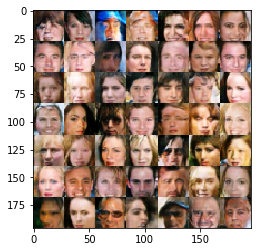

Epoch 2/2... Discriminator Loss: 1.4022... Generator Loss: 0.5312
Epoch 2/2... Discriminator Loss: 0.9745... Generator Loss: 1.3605
Epoch 2/2... Discriminator Loss: 1.0969... Generator Loss: 1.3410
Epoch 2/2... Discriminator Loss: 1.1048... Generator Loss: 0.8728
Epoch 2/2... Discriminator Loss: 1.5698... Generator Loss: 0.4838
Epoch 2/2... Discriminator Loss: 1.1160... Generator Loss: 1.1592
Epoch 2/2... Discriminator Loss: 1.4170... Generator Loss: 0.5336
Epoch 2/2... Discriminator Loss: 1.2274... Generator Loss: 1.0437
Epoch 2/2... Discriminator Loss: 1.4543... Generator Loss: 0.4777
Epoch 2/2... Discriminator Loss: 1.2906... Generator Loss: 0.8655


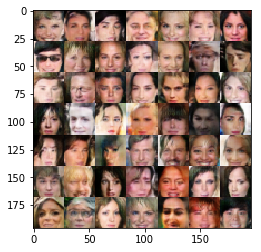

Epoch 2/2... Discriminator Loss: 1.4085... Generator Loss: 0.6605
Epoch 2/2... Discriminator Loss: 1.3185... Generator Loss: 0.7339
Epoch 2/2... Discriminator Loss: 1.0033... Generator Loss: 1.1926
Epoch 2/2... Discriminator Loss: 1.7620... Generator Loss: 0.3317
Epoch 2/2... Discriminator Loss: 1.5407... Generator Loss: 0.4119
Epoch 2/2... Discriminator Loss: 1.3965... Generator Loss: 0.5680
Epoch 2/2... Discriminator Loss: 1.7022... Generator Loss: 0.3419
Epoch 2/2... Discriminator Loss: 1.3470... Generator Loss: 0.7517
Epoch 2/2... Discriminator Loss: 1.9217... Generator Loss: 0.2656
Epoch 2/2... Discriminator Loss: 1.6431... Generator Loss: 0.3673


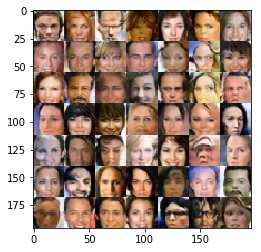

Epoch 2/2... Discriminator Loss: 1.2389... Generator Loss: 0.7527
Epoch 2/2... Discriminator Loss: 1.5342... Generator Loss: 0.4267
Epoch 2/2... Discriminator Loss: 1.4214... Generator Loss: 0.4800
Epoch 2/2... Discriminator Loss: 1.8116... Generator Loss: 0.3670
Epoch 2/2... Discriminator Loss: 1.3291... Generator Loss: 0.5273
Epoch 2/2... Discriminator Loss: 1.7574... Generator Loss: 0.3730
Epoch 2/2... Discriminator Loss: 1.2695... Generator Loss: 1.0136
Epoch 2/2... Discriminator Loss: 1.3708... Generator Loss: 0.5843
Epoch 2/2... Discriminator Loss: 1.5630... Generator Loss: 0.4765
Epoch 2/2... Discriminator Loss: 1.3023... Generator Loss: 0.5909


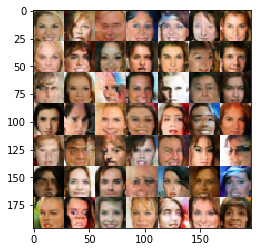

Epoch 2/2... Discriminator Loss: 1.3083... Generator Loss: 0.8355
Epoch 2/2... Discriminator Loss: 1.0292... Generator Loss: 1.1706
Epoch 2/2... Discriminator Loss: 1.1848... Generator Loss: 0.7406
Epoch 2/2... Discriminator Loss: 1.5265... Generator Loss: 0.4284
Epoch 2/2... Discriminator Loss: 1.1852... Generator Loss: 0.9052
Epoch 2/2... Discriminator Loss: 1.5939... Generator Loss: 0.3844
Epoch 2/2... Discriminator Loss: 1.8825... Generator Loss: 1.4599
Epoch 2/2... Discriminator Loss: 1.7409... Generator Loss: 0.3255
Epoch 2/2... Discriminator Loss: 1.3263... Generator Loss: 0.6832
Epoch 2/2... Discriminator Loss: 1.6159... Generator Loss: 0.3902


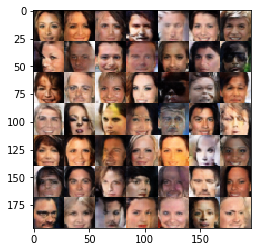

Epoch 2/2... Discriminator Loss: 1.7029... Generator Loss: 0.3358
Epoch 2/2... Discriminator Loss: 1.4385... Generator Loss: 0.8214
Epoch 2/2... Discriminator Loss: 0.9654... Generator Loss: 1.1870
Epoch 2/2... Discriminator Loss: 1.1950... Generator Loss: 1.2022
Epoch 2/2... Discriminator Loss: 1.2122... Generator Loss: 0.8556
Epoch 2/2... Discriminator Loss: 1.1539... Generator Loss: 1.0289
Epoch 2/2... Discriminator Loss: 1.9950... Generator Loss: 0.2386
Epoch 2/2... Discriminator Loss: 1.2668... Generator Loss: 0.6593
Epoch 2/2... Discriminator Loss: 1.1300... Generator Loss: 0.9020
Epoch 2/2... Discriminator Loss: 1.6060... Generator Loss: 0.3997


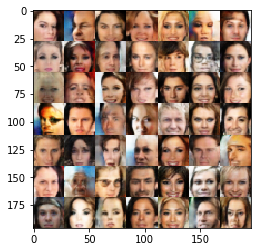

Epoch 2/2... Discriminator Loss: 1.2288... Generator Loss: 0.7880
Epoch 2/2... Discriminator Loss: 1.1118... Generator Loss: 0.9801
Epoch 2/2... Discriminator Loss: 0.9908... Generator Loss: 1.4032
Epoch 2/2... Discriminator Loss: 1.0140... Generator Loss: 1.1046
Epoch 2/2... Discriminator Loss: 1.2457... Generator Loss: 0.6573
Epoch 2/2... Discriminator Loss: 1.1208... Generator Loss: 0.8136
Epoch 2/2... Discriminator Loss: 1.2842... Generator Loss: 0.9288
Epoch 2/2... Discriminator Loss: 1.1426... Generator Loss: 0.8745
Epoch 2/2... Discriminator Loss: 1.4910... Generator Loss: 1.2018
Epoch 2/2... Discriminator Loss: 1.3428... Generator Loss: 1.9323


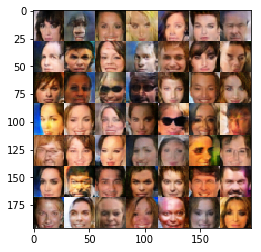

Epoch 2/2... Discriminator Loss: 1.1689... Generator Loss: 0.7946
Epoch 2/2... Discriminator Loss: 0.8915... Generator Loss: 1.2451
Epoch 2/2... Discriminator Loss: 1.3212... Generator Loss: 0.6496
Epoch 2/2... Discriminator Loss: 1.3703... Generator Loss: 0.6607
Epoch 2/2... Discriminator Loss: 1.0610... Generator Loss: 1.1666
Epoch 2/2... Discriminator Loss: 1.0051... Generator Loss: 1.0543
Epoch 2/2... Discriminator Loss: 2.2305... Generator Loss: 0.1974
Epoch 2/2... Discriminator Loss: 1.8678... Generator Loss: 0.2793
Epoch 2/2... Discriminator Loss: 1.3851... Generator Loss: 0.7275
Epoch 2/2... Discriminator Loss: 1.1349... Generator Loss: 0.9444


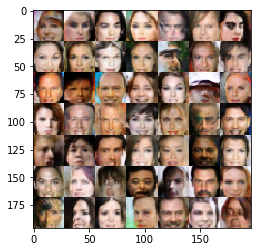

Epoch 2/2... Discriminator Loss: 1.2966... Generator Loss: 0.5636
Epoch 2/2... Discriminator Loss: 1.0325... Generator Loss: 1.0304
Epoch 2/2... Discriminator Loss: 1.2571... Generator Loss: 0.7877
Epoch 2/2... Discriminator Loss: 1.4174... Generator Loss: 0.5744
Epoch 2/2... Discriminator Loss: 1.9543... Generator Loss: 0.2509
Epoch 2/2... Discriminator Loss: 1.4625... Generator Loss: 0.5582
Epoch 2/2... Discriminator Loss: 1.3170... Generator Loss: 0.9505
Epoch 2/2... Discriminator Loss: 1.3738... Generator Loss: 0.5434
Epoch 2/2... Discriminator Loss: 1.7143... Generator Loss: 0.3568
Epoch 2/2... Discriminator Loss: 1.1556... Generator Loss: 0.9931


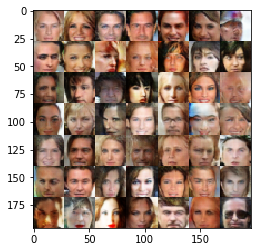

Epoch 2/2... Discriminator Loss: 1.2346... Generator Loss: 0.9208
Epoch 2/2... Discriminator Loss: 2.3414... Generator Loss: 0.1675
Epoch 2/2... Discriminator Loss: 1.7553... Generator Loss: 0.3138
Epoch 2/2... Discriminator Loss: 1.1357... Generator Loss: 0.8960
Epoch 2/2... Discriminator Loss: 1.8948... Generator Loss: 0.5151
Epoch 2/2... Discriminator Loss: 1.3014... Generator Loss: 0.6867
Epoch 2/2... Discriminator Loss: 1.5527... Generator Loss: 0.4835
Epoch 2/2... Discriminator Loss: 1.1650... Generator Loss: 0.8605
Epoch 2/2... Discriminator Loss: 1.0615... Generator Loss: 0.8221
Epoch 2/2... Discriminator Loss: 1.2954... Generator Loss: 0.6548


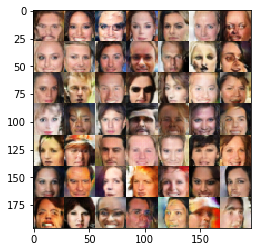

Epoch 2/2... Discriminator Loss: 0.9107... Generator Loss: 1.1610
Epoch 2/2... Discriminator Loss: 1.1018... Generator Loss: 1.0907
Epoch 2/2... Discriminator Loss: 1.2735... Generator Loss: 0.6934
Epoch 2/2... Discriminator Loss: 1.3848... Generator Loss: 0.8943
Epoch 2/2... Discriminator Loss: 1.2994... Generator Loss: 0.5490
Epoch 2/2... Discriminator Loss: 0.9762... Generator Loss: 1.1690
Epoch 2/2... Discriminator Loss: 1.3097... Generator Loss: 0.5699
Epoch 2/2... Discriminator Loss: 1.1396... Generator Loss: 1.2537
Epoch 2/2... Discriminator Loss: 1.3676... Generator Loss: 0.5272
Epoch 2/2... Discriminator Loss: 1.1614... Generator Loss: 0.7138


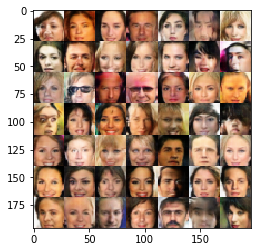

Epoch 2/2... Discriminator Loss: 1.2630... Generator Loss: 0.7420
Epoch 2/2... Discriminator Loss: 1.1538... Generator Loss: 0.8403
Epoch 2/2... Discriminator Loss: 1.3197... Generator Loss: 0.5878
Epoch 2/2... Discriminator Loss: 1.5584... Generator Loss: 0.4782
Epoch 2/2... Discriminator Loss: 1.1690... Generator Loss: 0.6774
Epoch 2/2... Discriminator Loss: 1.4482... Generator Loss: 0.5468
Epoch 2/2... Discriminator Loss: 1.6637... Generator Loss: 0.3809
Epoch 2/2... Discriminator Loss: 1.4994... Generator Loss: 0.4404
Epoch 2/2... Discriminator Loss: 1.5052... Generator Loss: 0.9918
Epoch 2/2... Discriminator Loss: 1.4331... Generator Loss: 0.8141


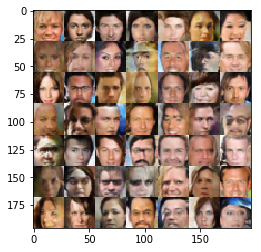

Epoch 2/2... Discriminator Loss: 1.3833... Generator Loss: 0.5682
Epoch 2/2... Discriminator Loss: 1.1840... Generator Loss: 1.6316
Epoch 2/2... Discriminator Loss: 1.2101... Generator Loss: 0.6862
Epoch 2/2... Discriminator Loss: 1.2293... Generator Loss: 0.9279
Epoch 2/2... Discriminator Loss: 1.1941... Generator Loss: 0.8646
Epoch 2/2... Discriminator Loss: 1.2252... Generator Loss: 0.6730
Epoch 2/2... Discriminator Loss: 1.8947... Generator Loss: 0.3027
Epoch 2/2... Discriminator Loss: 1.5571... Generator Loss: 0.4294
Epoch 2/2... Discriminator Loss: 1.5250... Generator Loss: 0.4780
Epoch 2/2... Discriminator Loss: 1.7711... Generator Loss: 0.3085


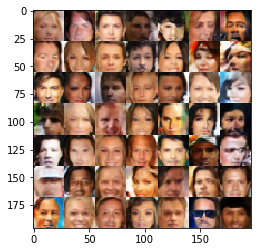

Epoch 2/2... Discriminator Loss: 1.5046... Generator Loss: 0.5265
Epoch 2/2... Discriminator Loss: 1.6776... Generator Loss: 0.3621
Epoch 2/2... Discriminator Loss: 1.1349... Generator Loss: 0.7844
Epoch 2/2... Discriminator Loss: 1.1253... Generator Loss: 0.9307
Epoch 2/2... Discriminator Loss: 1.8160... Generator Loss: 0.3075
Epoch 2/2... Discriminator Loss: 1.4142... Generator Loss: 0.5106
Epoch 2/2... Discriminator Loss: 1.5024... Generator Loss: 0.4791
Epoch 2/2... Discriminator Loss: 1.5611... Generator Loss: 0.4495
Epoch 2/2... Discriminator Loss: 1.4471... Generator Loss: 0.7317
Epoch 2/2... Discriminator Loss: 1.2264... Generator Loss: 1.0695


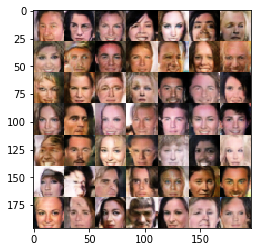

Epoch 2/2... Discriminator Loss: 1.1713... Generator Loss: 0.8412
Epoch 2/2... Discriminator Loss: 1.3295... Generator Loss: 1.0695
Epoch 2/2... Discriminator Loss: 1.3154... Generator Loss: 0.6204
Epoch 2/2... Discriminator Loss: 2.1827... Generator Loss: 0.2145
Epoch 2/2... Discriminator Loss: 1.0943... Generator Loss: 0.9651
Epoch 2/2... Discriminator Loss: 1.3501... Generator Loss: 0.5570
Epoch 2/2... Discriminator Loss: 1.6622... Generator Loss: 0.3877
Epoch 2/2... Discriminator Loss: 0.8027... Generator Loss: 2.2010
Epoch 2/2... Discriminator Loss: 1.4282... Generator Loss: 0.5112
Epoch 2/2... Discriminator Loss: 1.5347... Generator Loss: 0.4561


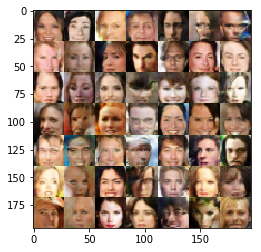

Epoch 2/2... Discriminator Loss: 1.2416... Generator Loss: 0.8488
Epoch 2/2... Discriminator Loss: 1.2696... Generator Loss: 0.6223
Epoch 2/2... Discriminator Loss: 1.4973... Generator Loss: 0.4730
Epoch 2/2... Discriminator Loss: 1.1583... Generator Loss: 1.0130
Epoch 2/2... Discriminator Loss: 1.0296... Generator Loss: 1.3815
Epoch 2/2... Discriminator Loss: 1.3758... Generator Loss: 0.5151
Epoch 2/2... Discriminator Loss: 1.2910... Generator Loss: 0.6123
Epoch 2/2... Discriminator Loss: 1.3606... Generator Loss: 0.5299
Epoch 2/2... Discriminator Loss: 0.9752... Generator Loss: 1.3614
Epoch 2/2... Discriminator Loss: 1.2133... Generator Loss: 1.0135


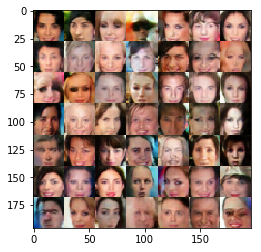

Epoch 2/2... Discriminator Loss: 1.0578... Generator Loss: 1.1330
Epoch 2/2... Discriminator Loss: 1.5768... Generator Loss: 0.4615
Epoch 2/2... Discriminator Loss: 1.7689... Generator Loss: 0.3511
Epoch 2/2... Discriminator Loss: 1.1812... Generator Loss: 0.7610
Epoch 2/2... Discriminator Loss: 1.2294... Generator Loss: 0.8477
Epoch 2/2... Discriminator Loss: 0.9661... Generator Loss: 0.9991
Epoch 2/2... Discriminator Loss: 1.1305... Generator Loss: 0.7812
Epoch 2/2... Discriminator Loss: 1.2644... Generator Loss: 0.8028
Epoch 2/2... Discriminator Loss: 1.1976... Generator Loss: 0.9408
Epoch 2/2... Discriminator Loss: 1.4471... Generator Loss: 0.5513


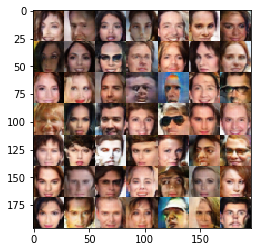

Epoch 2/2... Discriminator Loss: 1.1552... Generator Loss: 0.9312
Epoch 2/2... Discriminator Loss: 1.3712... Generator Loss: 0.7708
Epoch 2/2... Discriminator Loss: 1.3118... Generator Loss: 0.6063
Epoch 2/2... Discriminator Loss: 1.3212... Generator Loss: 1.0893
Epoch 2/2... Discriminator Loss: 1.6318... Generator Loss: 0.3869
Epoch 2/2... Discriminator Loss: 1.7930... Generator Loss: 0.3373
Epoch 2/2... Discriminator Loss: 1.3030... Generator Loss: 0.6643
Epoch 2/2... Discriminator Loss: 1.5796... Generator Loss: 0.4380
Epoch 2/2... Discriminator Loss: 1.3391... Generator Loss: 0.6312
Epoch 2/2... Discriminator Loss: 1.3906... Generator Loss: 0.9103


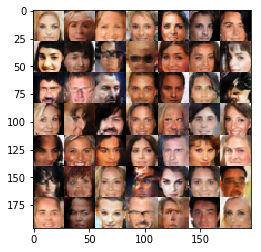

Epoch 2/2... Discriminator Loss: 0.9639... Generator Loss: 0.9880
Epoch 2/2... Discriminator Loss: 1.8404... Generator Loss: 0.2844
Epoch 2/2... Discriminator Loss: 1.8898... Generator Loss: 0.2963
Epoch 2/2... Discriminator Loss: 1.3814... Generator Loss: 0.5497
Epoch 2/2... Discriminator Loss: 1.2627... Generator Loss: 0.7696
Epoch 2/2... Discriminator Loss: 1.2617... Generator Loss: 0.7692
Epoch 2/2... Discriminator Loss: 1.7202... Generator Loss: 0.3261
Epoch 2/2... Discriminator Loss: 1.2329... Generator Loss: 0.6884
Epoch 2/2... Discriminator Loss: 1.3276... Generator Loss: 0.6678
Epoch 2/2... Discriminator Loss: 1.5569... Generator Loss: 0.4344


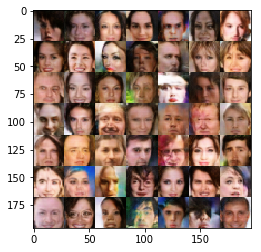

Epoch 2/2... Discriminator Loss: 1.1300... Generator Loss: 1.7835
Epoch 2/2... Discriminator Loss: 1.3724... Generator Loss: 0.7567
Epoch 2/2... Discriminator Loss: 1.4265... Generator Loss: 0.5488
Epoch 2/2... Discriminator Loss: 1.5558... Generator Loss: 0.3991
Epoch 2/2... Discriminator Loss: 1.4823... Generator Loss: 0.4628
Epoch 2/2... Discriminator Loss: 1.9736... Generator Loss: 0.2799
Epoch 2/2... Discriminator Loss: 1.7837... Generator Loss: 0.3499
Epoch 2/2... Discriminator Loss: 1.7907... Generator Loss: 0.2936
Epoch 2/2... Discriminator Loss: 1.1202... Generator Loss: 0.7370
Epoch 2/2... Discriminator Loss: 1.2474... Generator Loss: 1.5706


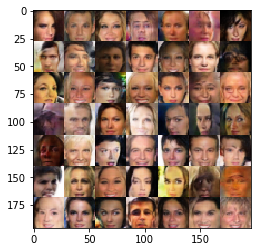

Epoch 2/2... Discriminator Loss: 1.5114... Generator Loss: 0.4123
Epoch 2/2... Discriminator Loss: 2.0967... Generator Loss: 0.2215
Epoch 2/2... Discriminator Loss: 1.3877... Generator Loss: 0.5500
Epoch 2/2... Discriminator Loss: 1.3704... Generator Loss: 0.4936
Epoch 2/2... Discriminator Loss: 1.2316... Generator Loss: 0.6494
Epoch 2/2... Discriminator Loss: 1.4043... Generator Loss: 0.5164
Epoch 2/2... Discriminator Loss: 1.1898... Generator Loss: 0.7455
Epoch 2/2... Discriminator Loss: 1.2142... Generator Loss: 0.7633
Epoch 2/2... Discriminator Loss: 1.3442... Generator Loss: 1.3496
Epoch 2/2... Discriminator Loss: 1.3423... Generator Loss: 0.6611


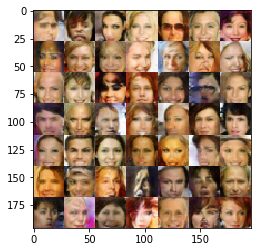

Epoch 2/2... Discriminator Loss: 1.4843... Generator Loss: 0.4544
Epoch 2/2... Discriminator Loss: 0.8790... Generator Loss: 1.3462
Epoch 2/2... Discriminator Loss: 0.9317... Generator Loss: 1.2920
Epoch 2/2... Discriminator Loss: 1.2076... Generator Loss: 1.1339
Epoch 2/2... Discriminator Loss: 1.0633... Generator Loss: 1.1954
Epoch 2/2... Discriminator Loss: 1.2341... Generator Loss: 0.6872
Epoch 2/2... Discriminator Loss: 1.1653... Generator Loss: 0.8026
Epoch 2/2... Discriminator Loss: 1.6114... Generator Loss: 0.4284
Epoch 2/2... Discriminator Loss: 1.0806... Generator Loss: 1.2846
Epoch 2/2... Discriminator Loss: 1.3060... Generator Loss: 0.6297


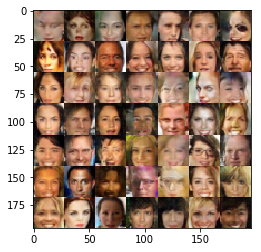

Epoch 2/2... Discriminator Loss: 1.4214... Generator Loss: 0.5622
Epoch 2/2... Discriminator Loss: 1.8316... Generator Loss: 0.3074
Epoch 2/2... Discriminator Loss: 1.9226... Generator Loss: 0.3150
Epoch 2/2... Discriminator Loss: 1.0637... Generator Loss: 1.1991
Epoch 2/2... Discriminator Loss: 1.2954... Generator Loss: 0.5686
Epoch 2/2... Discriminator Loss: 1.3408... Generator Loss: 0.7316
Epoch 2/2... Discriminator Loss: 1.2666... Generator Loss: 0.5897
Epoch 2/2... Discriminator Loss: 0.9671... Generator Loss: 1.3033
Epoch 2/2... Discriminator Loss: 1.3335... Generator Loss: 0.6025
Epoch 2/2... Discriminator Loss: 1.6707... Generator Loss: 0.4131


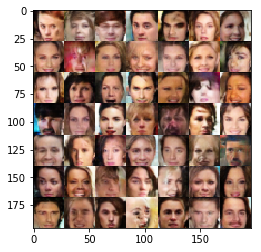

Epoch 2/2... Discriminator Loss: 2.1901... Generator Loss: 0.2044
Epoch 2/2... Discriminator Loss: 1.5185... Generator Loss: 0.4535
Epoch 2/2... Discriminator Loss: 1.6164... Generator Loss: 0.3570
Epoch 2/2... Discriminator Loss: 1.8211... Generator Loss: 0.2937
Epoch 2/2... Discriminator Loss: 1.9149... Generator Loss: 0.2780
Epoch 2/2... Discriminator Loss: 1.2096... Generator Loss: 0.6339
Epoch 2/2... Discriminator Loss: 1.3485... Generator Loss: 0.8407
Epoch 2/2... Discriminator Loss: 1.3265... Generator Loss: 0.6690
Epoch 2/2... Discriminator Loss: 1.2240... Generator Loss: 1.8254
Epoch 2/2... Discriminator Loss: 1.5701... Generator Loss: 0.3998


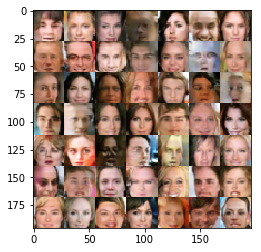

Epoch 2/2... Discriminator Loss: 1.2942... Generator Loss: 0.6039
Epoch 2/2... Discriminator Loss: 1.3950... Generator Loss: 0.5465
Epoch 2/2... Discriminator Loss: 0.9167... Generator Loss: 1.1139
Epoch 2/2... Discriminator Loss: 1.1179... Generator Loss: 1.3613
Epoch 2/2... Discriminator Loss: 1.0946... Generator Loss: 1.0592
Epoch 2/2... Discriminator Loss: 1.3859... Generator Loss: 0.5477
Epoch 2/2... Discriminator Loss: 1.8179... Generator Loss: 0.3046
Epoch 2/2... Discriminator Loss: 1.1187... Generator Loss: 0.8647
Epoch 2/2... Discriminator Loss: 1.4599... Generator Loss: 0.4861
Epoch 2/2... Discriminator Loss: 1.0088... Generator Loss: 1.1267


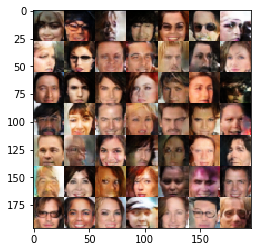

Epoch 2/2... Discriminator Loss: 1.4372... Generator Loss: 0.4906
Epoch 2/2... Discriminator Loss: 1.2798... Generator Loss: 0.7410
Epoch 2/2... Discriminator Loss: 0.9388... Generator Loss: 1.0714
Epoch 2/2... Discriminator Loss: 1.5916... Generator Loss: 0.4435
Epoch 2/2... Discriminator Loss: 1.1577... Generator Loss: 1.0378
Epoch 2/2... Discriminator Loss: 1.1455... Generator Loss: 0.8200
Epoch 2/2... Discriminator Loss: 1.7760... Generator Loss: 0.3248
Epoch 2/2... Discriminator Loss: 2.2344... Generator Loss: 0.2031
Epoch 2/2... Discriminator Loss: 1.0342... Generator Loss: 1.0886
Epoch 2/2... Discriminator Loss: 1.0835... Generator Loss: 1.0764


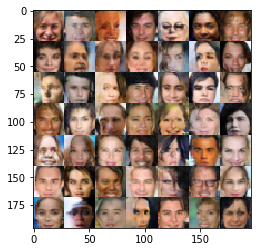

Epoch 2/2... Discriminator Loss: 1.2620... Generator Loss: 1.5708
Epoch 2/2... Discriminator Loss: 2.2063... Generator Loss: 0.1938
Epoch 2/2... Discriminator Loss: 1.3325... Generator Loss: 1.4900
Epoch 2/2... Discriminator Loss: 1.0787... Generator Loss: 0.8511
Epoch 2/2... Discriminator Loss: 1.1444... Generator Loss: 0.8300
Epoch 2/2... Discriminator Loss: 1.1462... Generator Loss: 1.0963
Epoch 2/2... Discriminator Loss: 1.3505... Generator Loss: 0.6517
Epoch 2/2... Discriminator Loss: 1.1477... Generator Loss: 1.0516
Epoch 2/2... Discriminator Loss: 1.1140... Generator Loss: 0.8332
Epoch 2/2... Discriminator Loss: 2.1465... Generator Loss: 0.2081


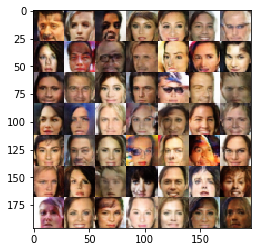

Epoch 2/2... Discriminator Loss: 0.9729... Generator Loss: 1.0472
Epoch 2/2... Discriminator Loss: 1.9494... Generator Loss: 0.2697
Epoch 2/2... Discriminator Loss: 1.1789... Generator Loss: 0.9300
Epoch 2/2... Discriminator Loss: 1.3130... Generator Loss: 0.5878
Epoch 2/2... Discriminator Loss: 1.0700... Generator Loss: 1.3740
Epoch 2/2... Discriminator Loss: 1.0955... Generator Loss: 0.8677
Epoch 2/2... Discriminator Loss: 1.2393... Generator Loss: 0.7579
Epoch 2/2... Discriminator Loss: 1.4600... Generator Loss: 0.4795
Epoch 2/2... Discriminator Loss: 1.1437... Generator Loss: 0.8873
Epoch 2/2... Discriminator Loss: 2.2286... Generator Loss: 0.2001


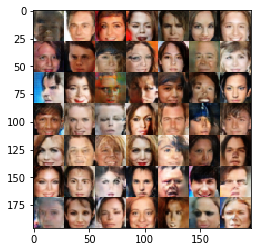

Epoch 2/2... Discriminator Loss: 1.7382... Generator Loss: 0.3295
Epoch 2/2... Discriminator Loss: 0.8442... Generator Loss: 1.3349
Epoch 2/2... Discriminator Loss: 1.6456... Generator Loss: 0.4116
Epoch 2/2... Discriminator Loss: 1.4612... Generator Loss: 0.4287
Epoch 2/2... Discriminator Loss: 1.3060... Generator Loss: 1.0162
Epoch 2/2... Discriminator Loss: 1.9897... Generator Loss: 0.2430
Epoch 2/2... Discriminator Loss: 1.6944... Generator Loss: 0.3430
Epoch 2/2... Discriminator Loss: 1.8387... Generator Loss: 0.3206
Epoch 2/2... Discriminator Loss: 1.1382... Generator Loss: 0.7738
Epoch 2/2... Discriminator Loss: 1.2412... Generator Loss: 0.7141


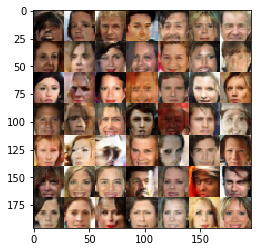

Epoch 2/2... Discriminator Loss: 0.9814... Generator Loss: 1.0115
Epoch 2/2... Discriminator Loss: 1.2771... Generator Loss: 0.6221
Epoch 2/2... Discriminator Loss: 1.4621... Generator Loss: 0.5281
Epoch 2/2... Discriminator Loss: 1.2163... Generator Loss: 1.3005
Epoch 2/2... Discriminator Loss: 1.3087... Generator Loss: 0.6869
Epoch 2/2... Discriminator Loss: 1.7312... Generator Loss: 0.3383
Epoch 2/2... Discriminator Loss: 2.0112... Generator Loss: 0.2361
Epoch 2/2... Discriminator Loss: 1.4425... Generator Loss: 0.5315
Epoch 2/2... Discriminator Loss: 1.9788... Generator Loss: 0.2634
Epoch 2/2... Discriminator Loss: 1.1847... Generator Loss: 0.8552


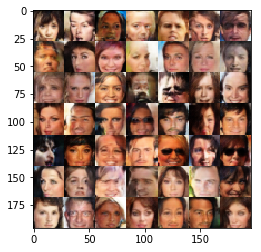

Epoch 2/2... Discriminator Loss: 1.3048... Generator Loss: 0.6634
Epoch 2/2... Discriminator Loss: 1.3001... Generator Loss: 0.5696
Epoch 2/2... Discriminator Loss: 1.5974... Generator Loss: 0.4195
Epoch 2/2... Discriminator Loss: 1.9984... Generator Loss: 0.2478
Epoch 2/2... Discriminator Loss: 1.3326... Generator Loss: 0.5774
Epoch 2/2... Discriminator Loss: 1.0669... Generator Loss: 0.8622
Epoch 2/2... Discriminator Loss: 1.8918... Generator Loss: 0.2813
Epoch 2/2... Discriminator Loss: 1.2812... Generator Loss: 0.5806
Epoch 2/2... Discriminator Loss: 1.1782... Generator Loss: 0.7790
Epoch 2/2... Discriminator Loss: 0.9673... Generator Loss: 1.6836


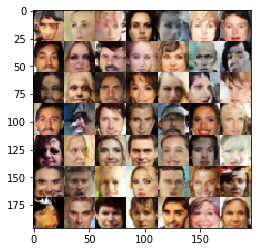

Epoch 2/2... Discriminator Loss: 1.8280... Generator Loss: 0.3275
Epoch 2/2... Discriminator Loss: 1.4167... Generator Loss: 0.5310
Epoch 2/2... Discriminator Loss: 1.3034... Generator Loss: 1.0639
Epoch 2/2... Discriminator Loss: 1.2800... Generator Loss: 0.5997
Epoch 2/2... Discriminator Loss: 0.8535... Generator Loss: 1.5818
Epoch 2/2... Discriminator Loss: 1.0327... Generator Loss: 0.9471
Epoch 2/2... Discriminator Loss: 1.4730... Generator Loss: 0.4786
Epoch 2/2... Discriminator Loss: 1.2583... Generator Loss: 0.6676
Epoch 2/2... Discriminator Loss: 0.9360... Generator Loss: 1.7444
Epoch 2/2... Discriminator Loss: 1.6110... Generator Loss: 0.4910


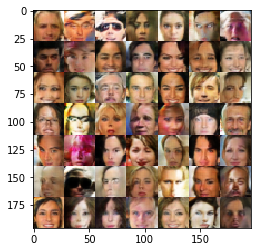

Epoch 2/2... Discriminator Loss: 1.1915... Generator Loss: 0.6821
Epoch 2/2... Discriminator Loss: 1.4470... Generator Loss: 0.5886
Epoch 2/2... Discriminator Loss: 0.7613... Generator Loss: 1.2756
Epoch 2/2... Discriminator Loss: 1.4545... Generator Loss: 0.4483
Epoch 2/2... Discriminator Loss: 1.0689... Generator Loss: 0.8430
Epoch 2/2... Discriminator Loss: 0.8932... Generator Loss: 1.0215
Epoch 2/2... Discriminator Loss: 1.2958... Generator Loss: 0.7405
Epoch 2/2... Discriminator Loss: 1.2055... Generator Loss: 1.0078
Epoch 2/2... Discriminator Loss: 1.1882... Generator Loss: 1.3174
Epoch 2/2... Discriminator Loss: 1.1132... Generator Loss: 0.8016


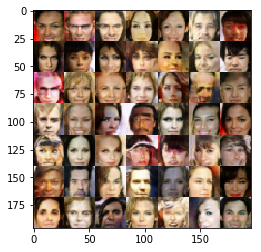

Epoch 2/2... Discriminator Loss: 1.1935... Generator Loss: 0.7871
Epoch 2/2... Discriminator Loss: 1.8309... Generator Loss: 0.3175
Epoch 2/2... Discriminator Loss: 1.1696... Generator Loss: 0.6622
Epoch 2/2... Discriminator Loss: 1.4149... Generator Loss: 0.5690
Epoch 2/2... Discriminator Loss: 1.4548... Generator Loss: 0.4650
Epoch 2/2... Discriminator Loss: 1.4602... Generator Loss: 0.5613
Epoch 2/2... Discriminator Loss: 1.2370... Generator Loss: 0.6665
Epoch 2/2... Discriminator Loss: 0.9028... Generator Loss: 1.1567
Epoch 2/2... Discriminator Loss: 1.5937... Generator Loss: 0.3857
Epoch 2/2... Discriminator Loss: 1.4950... Generator Loss: 0.5431


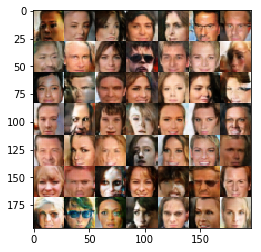

Epoch 2/2... Discriminator Loss: 1.5904... Generator Loss: 0.4576
Epoch 2/2... Discriminator Loss: 0.8896... Generator Loss: 1.6007
Epoch 2/2... Discriminator Loss: 1.2168... Generator Loss: 0.7057
Epoch 2/2... Discriminator Loss: 1.1150... Generator Loss: 1.5889
Epoch 2/2... Discriminator Loss: 1.3606... Generator Loss: 0.5333
Epoch 2/2... Discriminator Loss: 1.2823... Generator Loss: 0.6240
Epoch 2/2... Discriminator Loss: 1.1407... Generator Loss: 0.8125
Epoch 2/2... Discriminator Loss: 1.1092... Generator Loss: 0.8426
Epoch 2/2... Discriminator Loss: 1.1436... Generator Loss: 0.8838
Epoch 2/2... Discriminator Loss: 1.4361... Generator Loss: 0.4906


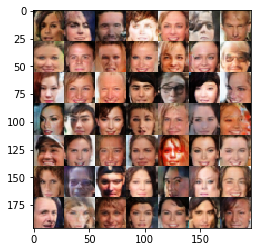

Epoch 2/2... Discriminator Loss: 1.1066... Generator Loss: 0.8020
Epoch 2/2... Discriminator Loss: 1.1240... Generator Loss: 0.8847
Epoch 2/2... Discriminator Loss: 0.8916... Generator Loss: 1.2525
Epoch 2/2... Discriminator Loss: 1.2620... Generator Loss: 0.6043
Epoch 2/2... Discriminator Loss: 1.0706... Generator Loss: 0.8201
Epoch 2/2... Discriminator Loss: 1.2974... Generator Loss: 0.5549
Epoch 2/2... Discriminator Loss: 1.1380... Generator Loss: 0.7305
Epoch 2/2... Discriminator Loss: 0.8107... Generator Loss: 1.6243
Epoch 2/2... Discriminator Loss: 1.4750... Generator Loss: 0.4444
Epoch 2/2... Discriminator Loss: 0.9595... Generator Loss: 0.9514


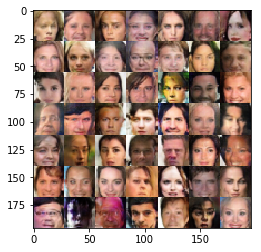

Epoch 2/2... Discriminator Loss: 1.2108... Generator Loss: 0.7604
Epoch 2/2... Discriminator Loss: 1.3182... Generator Loss: 0.6583
Epoch 2/2... Discriminator Loss: 1.6231... Generator Loss: 0.4306
Epoch 2/2... Discriminator Loss: 1.1248... Generator Loss: 0.9005
Epoch 2/2... Discriminator Loss: 1.5044... Generator Loss: 0.4580
Epoch 2/2... Discriminator Loss: 1.6571... Generator Loss: 0.3745
Epoch 2/2... Discriminator Loss: 1.3365... Generator Loss: 0.6795
Epoch 2/2... Discriminator Loss: 0.9852... Generator Loss: 0.9290
Epoch 2/2... Discriminator Loss: 1.2269... Generator Loss: 0.7296
Epoch 2/2... Discriminator Loss: 0.9764... Generator Loss: 1.2138


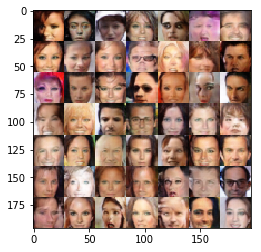

Epoch 2/2... Discriminator Loss: 1.5163... Generator Loss: 0.4542
Epoch 2/2... Discriminator Loss: 1.2061... Generator Loss: 0.7093
Epoch 2/2... Discriminator Loss: 1.0831... Generator Loss: 1.1099
Epoch 2/2... Discriminator Loss: 1.8103... Generator Loss: 0.3152
Epoch 2/2... Discriminator Loss: 1.5144... Generator Loss: 0.4449
Epoch 2/2... Discriminator Loss: 1.1380... Generator Loss: 0.8253
Epoch 2/2... Discriminator Loss: 1.3574... Generator Loss: 0.5946
Epoch 2/2... Discriminator Loss: 1.4031... Generator Loss: 0.5423
Epoch 2/2... Discriminator Loss: 1.1493... Generator Loss: 0.8443
Epoch 2/2... Discriminator Loss: 1.1688... Generator Loss: 0.7984


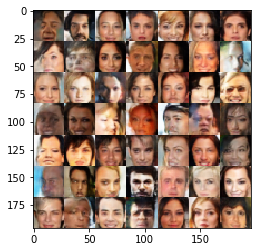

Epoch 2/2... Discriminator Loss: 1.3907... Generator Loss: 0.5283
Epoch 2/2... Discriminator Loss: 0.9151... Generator Loss: 1.3907
Epoch 2/2... Discriminator Loss: 1.5616... Generator Loss: 0.4522
Epoch 2/2... Discriminator Loss: 1.5483... Generator Loss: 0.4715
Epoch 2/2... Discriminator Loss: 1.8883... Generator Loss: 0.2875
Epoch 2/2... Discriminator Loss: 1.2380... Generator Loss: 0.6445
Epoch 2/2... Discriminator Loss: 1.0922... Generator Loss: 0.8088
Epoch 2/2... Discriminator Loss: 1.1558... Generator Loss: 0.7005
Epoch 2/2... Discriminator Loss: 1.3517... Generator Loss: 0.9745
Epoch 2/2... Discriminator Loss: 1.7478... Generator Loss: 0.3196


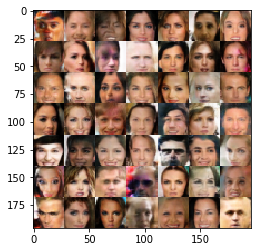

Epoch 2/2... Discriminator Loss: 1.4247... Generator Loss: 0.5175
Epoch 2/2... Discriminator Loss: 0.9128... Generator Loss: 1.4036
Epoch 2/2... Discriminator Loss: 1.3947... Generator Loss: 0.4895
Epoch 2/2... Discriminator Loss: 1.4017... Generator Loss: 0.5281
Epoch 2/2... Discriminator Loss: 1.0805... Generator Loss: 1.4906
Epoch 2/2... Discriminator Loss: 1.3411... Generator Loss: 0.5751
Epoch 2/2... Discriminator Loss: 1.0362... Generator Loss: 1.7469
Epoch 2/2... Discriminator Loss: 1.1239... Generator Loss: 0.7822
Epoch 2/2... Discriminator Loss: 1.0213... Generator Loss: 1.1677
Epoch 2/2... Discriminator Loss: 0.8760... Generator Loss: 1.2114


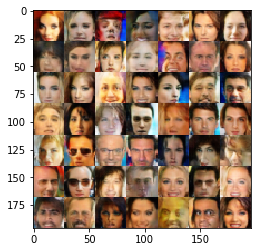

Epoch 2/2... Discriminator Loss: 1.1482... Generator Loss: 0.8934
Epoch 2/2... Discriminator Loss: 1.2808... Generator Loss: 0.6671
Epoch 2/2... Discriminator Loss: 0.9752... Generator Loss: 1.2659
Epoch 2/2... Discriminator Loss: 1.1135... Generator Loss: 0.8314
Epoch 2/2... Discriminator Loss: 1.2358... Generator Loss: 0.6123
Epoch 2/2... Discriminator Loss: 1.5116... Generator Loss: 0.4708
Epoch 2/2... Discriminator Loss: 1.5171... Generator Loss: 0.4491
Epoch 2/2... Discriminator Loss: 0.9926... Generator Loss: 1.0017
Epoch 2/2... Discriminator Loss: 1.9090... Generator Loss: 0.2917
Epoch 2/2... Discriminator Loss: 0.9703... Generator Loss: 1.1428


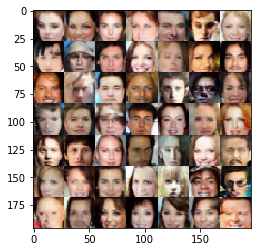

Epoch 2/2... Discriminator Loss: 1.6246... Generator Loss: 0.3737
Epoch 2/2... Discriminator Loss: 1.8498... Generator Loss: 0.3036
Epoch 2/2... Discriminator Loss: 2.1007... Generator Loss: 0.2149
Epoch 2/2... Discriminator Loss: 1.4737... Generator Loss: 0.4842
Epoch 2/2... Discriminator Loss: 1.1388... Generator Loss: 0.7878
Epoch 2/2... Discriminator Loss: 1.5270... Generator Loss: 0.4310
Epoch 2/2... Discriminator Loss: 1.5101... Generator Loss: 0.4736
Epoch 2/2... Discriminator Loss: 2.0806... Generator Loss: 0.2227
Epoch 2/2... Discriminator Loss: 1.1525... Generator Loss: 0.8212
Epoch 2/2... Discriminator Loss: 1.0233... Generator Loss: 0.8774


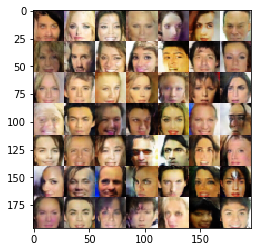

Epoch 2/2... Discriminator Loss: 1.1648... Generator Loss: 0.9225
Epoch 2/2... Discriminator Loss: 1.3306... Generator Loss: 0.5941
Epoch 2/2... Discriminator Loss: 1.3957... Generator Loss: 0.6594
Epoch 2/2... Discriminator Loss: 1.0055... Generator Loss: 1.1071
Epoch 2/2... Discriminator Loss: 1.2269... Generator Loss: 0.9021
Epoch 2/2... Discriminator Loss: 1.3557... Generator Loss: 0.6050
Epoch 2/2... Discriminator Loss: 1.1100... Generator Loss: 0.9580
Epoch 2/2... Discriminator Loss: 1.1906... Generator Loss: 0.8365
Epoch 2/2... Discriminator Loss: 1.3330... Generator Loss: 0.5248
Epoch 2/2... Discriminator Loss: 1.5172... Generator Loss: 0.4718


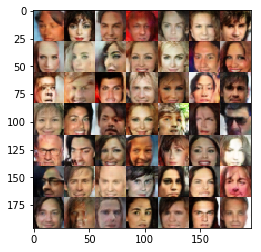

Epoch 2/2... Discriminator Loss: 1.5939... Generator Loss: 0.4062
Epoch 2/2... Discriminator Loss: 1.8175... Generator Loss: 0.3188
Epoch 2/2... Discriminator Loss: 1.5024... Generator Loss: 0.4320
Epoch 2/2... Discriminator Loss: 1.3886... Generator Loss: 0.5550
Epoch 2/2... Discriminator Loss: 1.1174... Generator Loss: 0.8761
Epoch 2/2... Discriminator Loss: 0.8888... Generator Loss: 1.3083
Epoch 2/2... Discriminator Loss: 1.0473... Generator Loss: 0.8548
Epoch 2/2... Discriminator Loss: 1.2024... Generator Loss: 0.8305
Epoch 2/2... Discriminator Loss: 1.5555... Generator Loss: 0.6109
Epoch 2/2... Discriminator Loss: 1.8911... Generator Loss: 0.3353


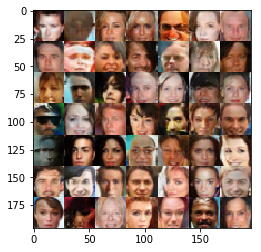

Epoch 2/2... Discriminator Loss: 1.8345... Generator Loss: 0.3257
Epoch 2/2... Discriminator Loss: 1.3818... Generator Loss: 0.5613
Epoch 2/2... Discriminator Loss: 1.1682... Generator Loss: 0.9692
Epoch 2/2... Discriminator Loss: 1.1567... Generator Loss: 0.7150
Epoch 2/2... Discriminator Loss: 1.5190... Generator Loss: 0.4688
Epoch 2/2... Discriminator Loss: 0.9637... Generator Loss: 1.0022
Epoch 2/2... Discriminator Loss: 0.9583... Generator Loss: 1.2820
Epoch 2/2... Discriminator Loss: 2.0321... Generator Loss: 0.2602
Epoch 2/2... Discriminator Loss: 1.4060... Generator Loss: 0.4988
Epoch 2/2... Discriminator Loss: 1.1933... Generator Loss: 0.8835


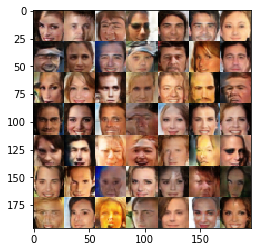

Epoch 2/2... Discriminator Loss: 1.0661... Generator Loss: 0.9138
Epoch 2/2... Discriminator Loss: 1.6067... Generator Loss: 0.4251
Epoch 2/2... Discriminator Loss: 1.7154... Generator Loss: 0.4096
Epoch 2/2... Discriminator Loss: 1.3864... Generator Loss: 0.6154
Epoch 2/2... Discriminator Loss: 1.0384... Generator Loss: 0.9254
Epoch 2/2... Discriminator Loss: 1.3066... Generator Loss: 0.5683
Epoch 2/2... Discriminator Loss: 1.1542... Generator Loss: 1.0087
Epoch 2/2... Discriminator Loss: 1.2424... Generator Loss: 0.7271
Epoch 2/2... Discriminator Loss: 1.1009... Generator Loss: 0.8933
Epoch 2/2... Discriminator Loss: 1.1168... Generator Loss: 1.0772


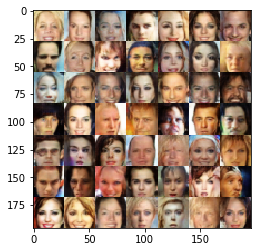

Epoch 2/2... Discriminator Loss: 0.8694... Generator Loss: 1.3496
Epoch 2/2... Discriminator Loss: 1.4742... Generator Loss: 0.5614
Epoch 2/2... Discriminator Loss: 2.0821... Generator Loss: 0.2282
Epoch 2/2... Discriminator Loss: 1.4326... Generator Loss: 0.5236
Epoch 2/2... Discriminator Loss: 1.1307... Generator Loss: 1.3294
Epoch 2/2... Discriminator Loss: 1.2266... Generator Loss: 0.8771
Epoch 2/2... Discriminator Loss: 1.1272... Generator Loss: 1.2318
Epoch 2/2... Discriminator Loss: 1.4033... Generator Loss: 0.5756
Epoch 2/2... Discriminator Loss: 1.3243... Generator Loss: 0.9734
Epoch 2/2... Discriminator Loss: 1.2000... Generator Loss: 0.7376


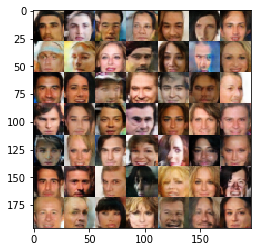

Epoch 2/2... Discriminator Loss: 1.5238... Generator Loss: 0.4199
Epoch 2/2... Discriminator Loss: 0.9326... Generator Loss: 1.0378
Epoch 2/2... Discriminator Loss: 1.5526... Generator Loss: 0.4263
Epoch 2/2... Discriminator Loss: 1.0915... Generator Loss: 0.9905
Epoch 2/2... Discriminator Loss: 1.7363... Generator Loss: 0.3436
Epoch 2/2... Discriminator Loss: 2.0725... Generator Loss: 0.2430
Epoch 2/2... Discriminator Loss: 1.5317... Generator Loss: 0.4487
Epoch 2/2... Discriminator Loss: 0.9147... Generator Loss: 1.6195
Epoch 2/2... Discriminator Loss: 1.2271... Generator Loss: 0.6435
Epoch 2/2... Discriminator Loss: 1.5922... Generator Loss: 0.4329


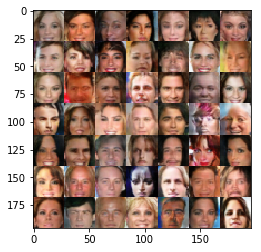

Epoch 2/2... Discriminator Loss: 1.8744... Generator Loss: 0.3022
Epoch 2/2... Discriminator Loss: 1.0079... Generator Loss: 0.9114
Epoch 2/2... Discriminator Loss: 0.9926... Generator Loss: 1.1148
Epoch 2/2... Discriminator Loss: 1.5996... Generator Loss: 0.4746
Epoch 2/2... Discriminator Loss: 1.4615... Generator Loss: 0.5306
Epoch 2/2... Discriminator Loss: 0.9575... Generator Loss: 0.9471
Epoch 2/2... Discriminator Loss: 1.0750... Generator Loss: 1.1495
Epoch 2/2... Discriminator Loss: 1.3737... Generator Loss: 0.6005
Epoch 2/2... Discriminator Loss: 0.9906... Generator Loss: 0.8844
Epoch 2/2... Discriminator Loss: 1.1685... Generator Loss: 0.8269


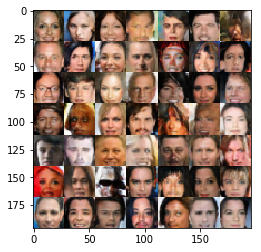

Epoch 2/2... Discriminator Loss: 1.4563... Generator Loss: 0.4603
Epoch 2/2... Discriminator Loss: 1.1312... Generator Loss: 0.7700
Epoch 2/2... Discriminator Loss: 1.5667... Generator Loss: 0.4560
Epoch 2/2... Discriminator Loss: 1.5639... Generator Loss: 0.4932
Epoch 2/2... Discriminator Loss: 1.7074... Generator Loss: 0.3804
Epoch 2/2... Discriminator Loss: 1.2181... Generator Loss: 0.6662
Epoch 2/2... Discriminator Loss: 1.3321... Generator Loss: 0.6186
Epoch 2/2... Discriminator Loss: 1.4796... Generator Loss: 0.6159
Epoch 2/2... Discriminator Loss: 1.1368... Generator Loss: 1.3952
Epoch 2/2... Discriminator Loss: 1.7729... Generator Loss: 2.6322


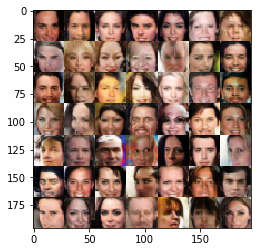

Epoch 2/2... Discriminator Loss: 1.0438... Generator Loss: 1.2556
Epoch 2/2... Discriminator Loss: 1.2108... Generator Loss: 0.6767
Epoch 2/2... Discriminator Loss: 1.3642... Generator Loss: 0.6023
Epoch 2/2... Discriminator Loss: 1.3150... Generator Loss: 0.6148
Epoch 2/2... Discriminator Loss: 1.0834... Generator Loss: 0.9624
Epoch 2/2... Discriminator Loss: 2.0057... Generator Loss: 0.2794
Epoch 2/2... Discriminator Loss: 1.1751... Generator Loss: 0.7718
Epoch 2/2... Discriminator Loss: 0.8851... Generator Loss: 1.0981
Epoch 2/2... Discriminator Loss: 1.7177... Generator Loss: 0.3258
Epoch 2/2... Discriminator Loss: 1.2021... Generator Loss: 0.7692


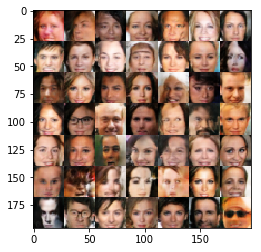

Epoch 2/2... Discriminator Loss: 1.0307... Generator Loss: 1.0022
Epoch 2/2... Discriminator Loss: 2.1263... Generator Loss: 0.2101
Epoch 2/2... Discriminator Loss: 1.6000... Generator Loss: 0.4047
Epoch 2/2... Discriminator Loss: 0.9927... Generator Loss: 1.5535
Epoch 2/2... Discriminator Loss: 0.9299... Generator Loss: 1.1022
Epoch 2/2... Discriminator Loss: 0.9119... Generator Loss: 1.0996
Epoch 2/2... Discriminator Loss: 1.6371... Generator Loss: 0.3936
Epoch 2/2... Discriminator Loss: 1.6598... Generator Loss: 0.4115
Epoch 2/2... Discriminator Loss: 1.2877... Generator Loss: 1.4431
Epoch 2/2... Discriminator Loss: 0.7999... Generator Loss: 1.6028


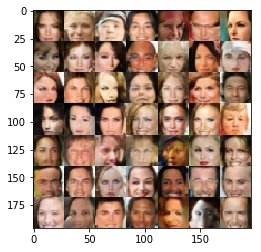

Epoch 2/2... Discriminator Loss: 1.2667... Generator Loss: 0.7043
Epoch 2/2... Discriminator Loss: 0.8724... Generator Loss: 1.1675
Epoch 2/2... Discriminator Loss: 0.9326... Generator Loss: 0.9852
Epoch 2/2... Discriminator Loss: 1.3998... Generator Loss: 0.5447
Epoch 2/2... Discriminator Loss: 1.4575... Generator Loss: 0.5306
Epoch 2/2... Discriminator Loss: 1.9731... Generator Loss: 0.2684
Epoch 2/2... Discriminator Loss: 1.3138... Generator Loss: 0.7256
Epoch 2/2... Discriminator Loss: 0.9792... Generator Loss: 1.0256
Epoch 2/2... Discriminator Loss: 1.3900... Generator Loss: 0.5625
Epoch 2/2... Discriminator Loss: 1.4510... Generator Loss: 0.6493


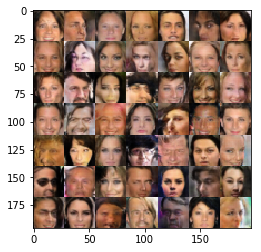

Epoch 2/2... Discriminator Loss: 0.9729... Generator Loss: 1.2122
Epoch 2/2... Discriminator Loss: 1.6287... Generator Loss: 0.4920
Epoch 2/2... Discriminator Loss: 0.8879... Generator Loss: 1.2456
Epoch 2/2... Discriminator Loss: 0.9675... Generator Loss: 1.1854
Epoch 2/2... Discriminator Loss: 1.0310... Generator Loss: 0.9956
Epoch 2/2... Discriminator Loss: 1.0833... Generator Loss: 1.2752
Epoch 2/2... Discriminator Loss: 1.2807... Generator Loss: 0.6173
Epoch 2/2... Discriminator Loss: 1.4286... Generator Loss: 0.5836
Epoch 2/2... Discriminator Loss: 1.2942... Generator Loss: 0.6486
Epoch 2/2... Discriminator Loss: 1.1195... Generator Loss: 0.8473


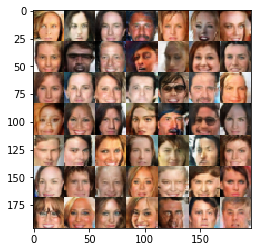

Epoch 2/2... Discriminator Loss: 1.3014... Generator Loss: 0.6729
Epoch 2/2... Discriminator Loss: 1.2162... Generator Loss: 0.7583
Epoch 2/2... Discriminator Loss: 1.7262... Generator Loss: 0.3590
Epoch 2/2... Discriminator Loss: 1.5491... Generator Loss: 0.4624
Epoch 2/2... Discriminator Loss: 2.0213... Generator Loss: 0.3098
Epoch 2/2... Discriminator Loss: 1.5604... Generator Loss: 0.4219


In [15]:
batch_size = 32
z_dim = 100
learning_rate = 0.001
beta1 = 0.5
alpha = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode, alpha)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.